In [127]:
import numpy as np
from matplotlib import pyplot as plt
from functions import *
from functions_solutions import *
from scipy.ndimage import convolve
import maxflow


minimum value: 0, maximum value: 176
0
176


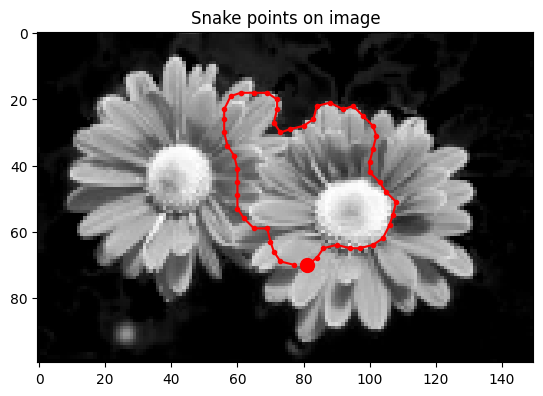

[5188.79473761]


In [128]:
image = get_gray_image('exam_data/exam2023/flower.png')
print(np.min(image))
print(np.max(image))
snake_points = np.loadtxt('exam_data/exam2023/snake.txt').astype(int)


plt.imshow(image, cmap='gray')
plt.plot(snake_points[:,1], snake_points[:,0], 'r.-')
plt.plot(snake_points[0,1], snake_points[0,0], 'ro', markersize=10)  # Start point
plt.title('Snake points on image')
plt.show()


f_ext = calculate_Fext(image, snake_points, neighborhood_size=0)

print(f_ext[0])

## Exam 2021

### Quesiton 1) Scale-normalized Laplacian

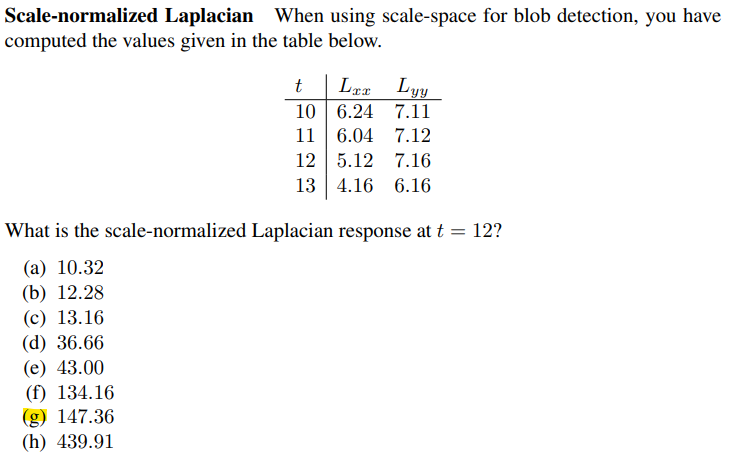

For normalizing the laplacian I use the following formula:
$$
L_{norm} = t \cdot L
$$

#### Mine

In [129]:
t = 12
L_norm = t*(5.12 + 7.16)
print(L_norm)

147.36


#### Solution

In [130]:
print(f'Question 1: {12*(5.12 + 7.16):0.3f}')

Question 1: 147.360


### Question 2)

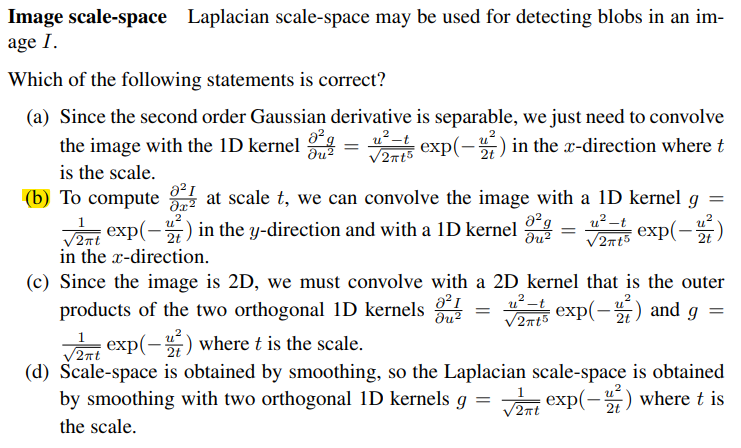

#### Mine

**(a)** We need to convolve with a Gaussian kernel in the other direction

**(b)** Correct

**(c)** We don't need to use a 2D kernel

**(d)** We need to smooth with the derivative of the Gaussian kernel

#### Solution

The correct answer is (b)

Smoothing effect is needed in both direction. Kernels are separable so no need to use 2D kernels. Instead of only smoothing in both direction, we need the second order derivatives in x direction, and smoothing in y. This leaves one correct answer. 

### Question 3) Blob detection

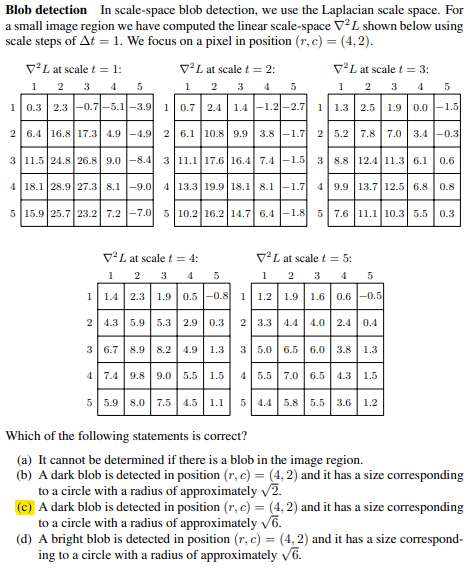

The point here is to remember to normalize the Laplacian with the variance t. A blob is a local maximum in it own scale and in the neighbourhood of scales. To compare scales we need to normalize the Laplacian.

#### Solution


Pixel (4, 2) is 2D local maximum for all t. To find maximum in 3D we need to scale-normalize, so we get the sequence

The larges number in this sequence is 41.1 at the scale t = 3. Radius is √2t = √6.
Since it is a large positive value, the blob is dark. 


In [131]:
L = np.array([28.9, 19.9, 13.7, 9.8, 7.0])
t = np.array([1, 2, 3, 4, 5])
print(f'Question 3: {np.sqrt(2*t[np.argmax(L*t)])}')

Question 3: 2.449489742783178


### Question 4) Dictionary clustering

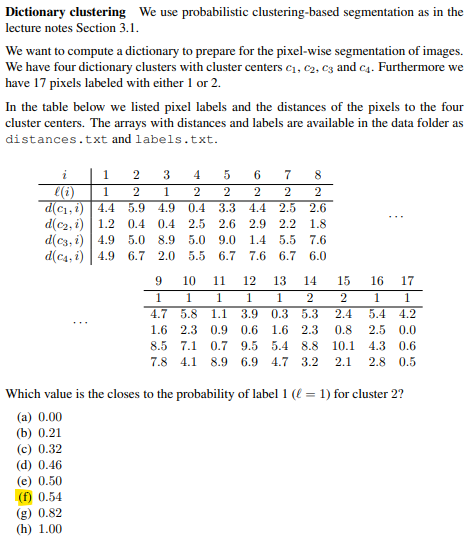

#### Mine

In [132]:
labels = np.loadtxt('exam_data/exam2021/labels.txt').astype(int)
distances = np.loadtxt('exam_data/exam2021/distances.txt')
shortest_distance = np.argmin(distances, axis=0)
print(f'shortest distance: {shortest_distance}')
lables_in_cluster_2 = labels[shortest_distance == 1]
print(f'labels in cluster 2: {lables_in_cluster_2}')
print(f'Probability of label 1 in cluster 2: {np.sum(lables_in_cluster_2 == 1) / len(lables_in_cluster_2):0.2f}')

shortest distance: [1 1 1 0 1 2 1 1 1 1 2 1 0 1 1 1 1]
labels in cluster 2: [1 2 1 2 2 2 1 1 1 2 2 1 1]
Probability of label 1 in cluster 2: 0.54


### Question 5)


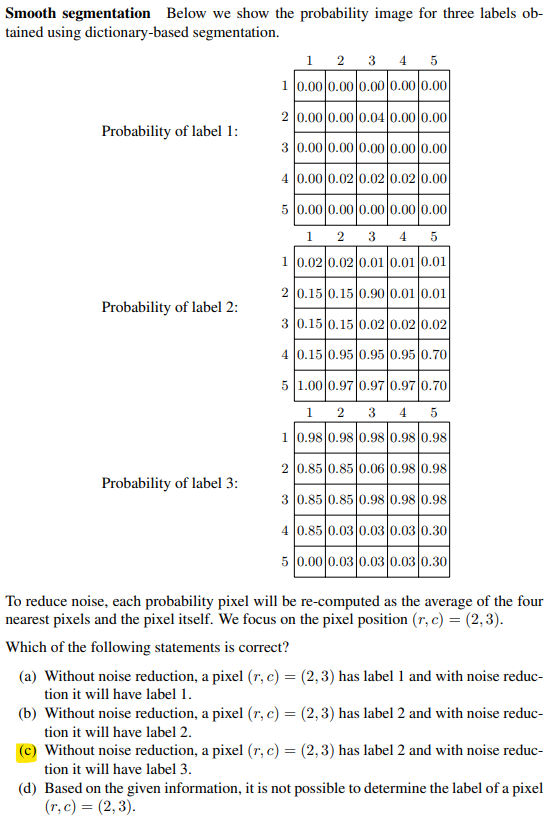

The points it to find the mean of the neighbourhood pixels and then see if the probability of label 2 still is the largest.

#### Mine

In [133]:
prob2_noise = (0.01 + 0.15 + 0.9 + 0.01 + 0.02)/5
prob3_noise = (0.98 + 0.85 + 0.06 + 0.98 + 0.98)/5

print(f'probability for class 2 with noise: {prob2_noise}')
print(f'probability for class 3 with noise: {prob3_noise}')

probability for class 2 with noise: 0.21800000000000003
probability for class 3 with noise: 0.77


#### Solution

Before smoothing, probabilities are [0.04, 0.90, 0.06], so second probability is largest and the label is 2. After smoothing probability for label 2 is 1
5
(0.01 +
0.02+0.15+0.01+0.9) and probability for label 3 is 1
5
(0.98+0.98+0.85+0.98+0.06).
So probability for label 3 is larger

### Question 6) Feature-based registration

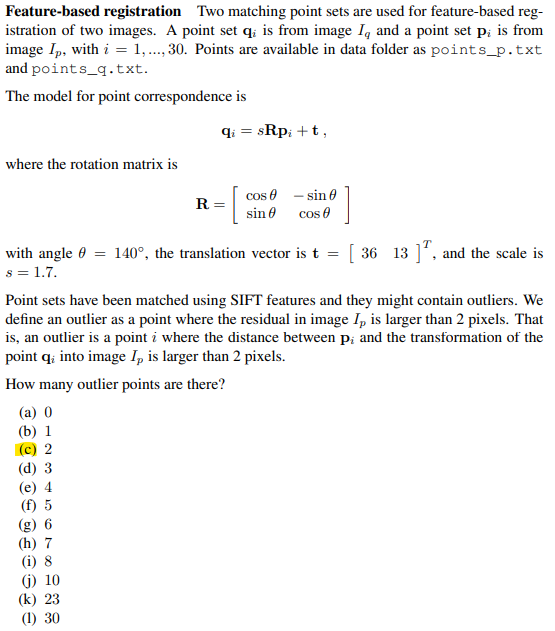

Here we should calculate $\hat{p}$ from knowing the points $q$ and then compare to the original $p$. We have the following equations:
$$
q = s R p + t
$$
when we isolate $p$ we get:
$$
\hat{p} = \frac{1}{s} R^T (q - t)
$$
where we use that $$R^T = R^{-1}$$ since R is orthogonal.

When they are saying, that the residual in image $I_p$ is larger than 2 they mean the norm between the two points $$||p - \hat{p}||$$ is larger than 2.

#### Mine

In [134]:
p = np.loadtxt('exam_data/exam2021/points_p.txt')
q = np.loadtxt('exam_data/exam2021/points_q.txt')

theta = np.deg2rad(140)
R = np.array([[np.cos(theta), -np.sin(theta)],
              [np.sin(theta), np.cos(theta)]])
t = np.array([[36], [13]])
s = 1.7

# print(f'p shape: {p.shape}')
# print(f'q shape: {q.shape}')
# print('R:', R)
# print('t:', t)

p_hat = (1 / s) * R.T @ (q - t)
p_diff = np.abs(p - p_hat)
norm = np.linalg.norm(p - p_hat, axis=0)
# print(p_diff.shape)
# print('norm', norm)
outlier = norm > 2
print('outlier', outlier)
print('outlier sum', np.sum(outlier))

outlier [False False False  True False False False  True False False False False
 False False False False False False False False False False False False
 False False False False False False]
outlier sum 2


#### Solution

Question 6: 2


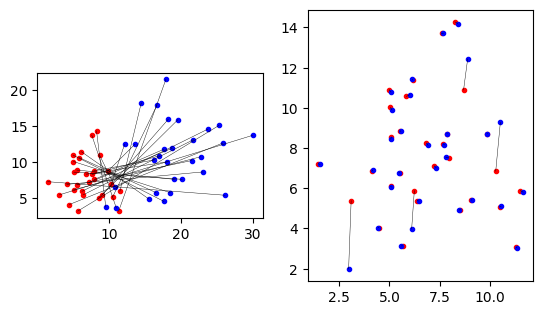

In [135]:
s = 1.7
t = np.array([[36, 13]]).T
theta = 140/180*np.pi
R = np.array([[np.cos(theta), -np.sin(theta)],[np.sin(theta),np.cos(theta)]])

p = np.loadtxt('exam_data/exam2021/points_p.txt')
q = np.loadtxt('exam_data/exam2021/points_q.txt')
p_ = R.T@(q-t)/s

# visualization
fig,ax = plt.subplots(1,2)
ax[0].plot(p[0], p[1], 'r.', q[0], q [1], 'b.')
ax[0].plot(np.stack((p[0], q[0])), np.stack((p[1], q[1])), 'k', linewidth = 0.3)
ax[0].set_aspect('equal')
ax[1].plot(p[0], p[1], 'r.', p_[0], p_[1], 'b.')
ax[1].plot(np.stack((p[0], p_[0])), np.stack((p[1],p_[1])),  'k', linewidth = 0.3)
ax[1].set_aspect('equal')

d = np.sqrt(np.sum((p - p_)**2,axis=0))
print(f'Question 6: {np.sum(d>2)}')

### Question 7) SIFT features

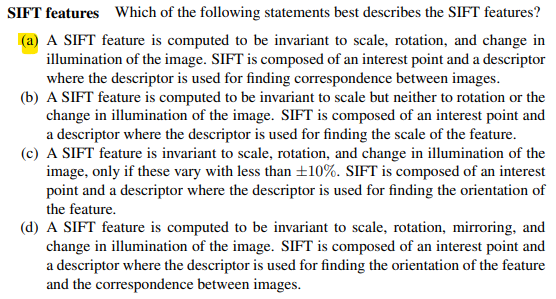

#### Mine

**(a)** correct

**(b)** wrong because SIFT is invariant to rotation and scale

**(c)** wrong because we can rotate more than 10%

**(d)** wrong because SIFT is not invariant to mirroring

#### Solutions

SIFT features are invariant to scale, rotation, and change in illumination but not mirroring. SIFT descriptor is used to find correspondence between images.


### Question 8) Gaussian features

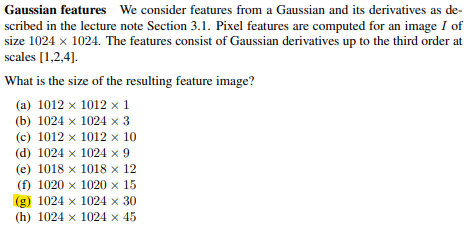

#### Mine

When we compute gaussian features we will compute:
$$
F =  [L, Lx, Ly, Lxx, Lxy, Lyy, Lxxx, Lxxy, Lxyy, Lyyy, Lxxxx, Lxxxy, Lxxyy, Lxyyy, Lyyyy] 
$$

because we only have up to 3th derivative then we have
$$
F =  [L, Lx, Ly, Lxx, Lxy, Lyy, Lxxx, Lxxy, Lxyy, Lyyy]
$$

which gives us an dimension of 10 for each scale, and since we have 3 scales we have 30 dimensions.


#### Solution

This is a 10-element vector for each scale, and with 3 scales we have 30-element feature vector for every image pixel. So size is 1024 × 1024 × 30

### Question 9) Image gradient

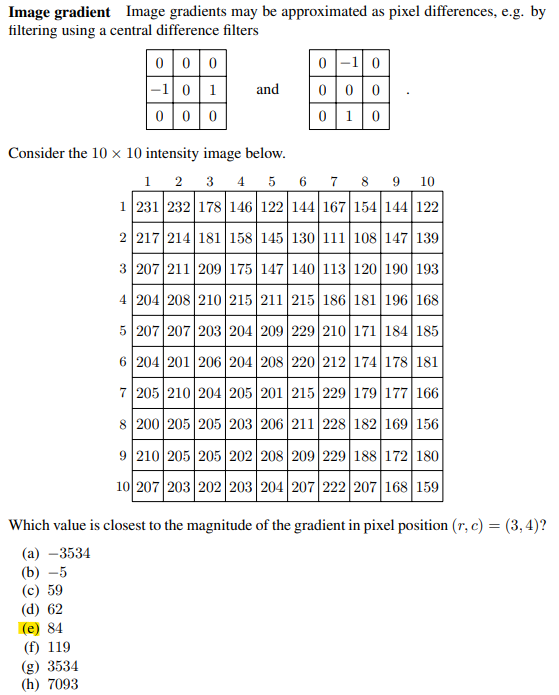

The point here is to see, that the two filters are independent and we can combine them into one filter and only calculate the gradient once for the point of interest.

#### Mine

In [136]:
image = np.array([[207, 203, 202, 203, 204, 207, 222, 207, 168, 159],
                  [210, 205, 205, 202, 208, 209, 229, 188, 172, 180],
                  [200, 205, 205, 203, 206, 211, 228, 182, 169, 156],
                  [205, 210, 204, 205, 201, 215, 229, 179, 177, 166],
                  [204, 201, 206, 204, 208, 220, 212, 174, 178, 181],
                  [207, 207, 203, 204, 209, 229, 210, 171, 184, 185],
                  [204, 208, 210, 215, 211, 215, 186, 181, 196, 168],
                  [207, 211, 209, 175, 147, 140, 113, 120, 190, 193],
                  [217, 214, 181, 158, 145, 130, 111, 108, 147, 139],
                  [231, 232, 178, 146, 122, 144, 167, 154, 144, 122]])
image = np.flip(image, axis=0)  # Flip the image vertically to match the original orientation
print(image)
x_filter = np.array([[0, 0, 0], [-1, 0, 1], [0, 0, 0]])
y_filter = np.array([[0, -1, 0], [0, 0, 0], [0, 1, 0]])

image_x = convolve(image, x_filter)
image_y = convolve(image, y_filter)

image_x_y = np.hypot(image_x, image_y)  # Optional: magnitude of gradient

print(image_x_y[2, 3])

[[231 232 178 146 122 144 167 154 144 122]
 [217 214 181 158 145 130 111 108 147 139]
 [207 211 209 175 147 140 113 120 190 193]
 [204 208 210 215 211 215 186 181 196 168]
 [207 207 203 204 209 229 210 171 184 185]
 [204 201 206 204 208 220 212 174 178 181]
 [205 210 204 205 201 215 229 179 177 166]
 [200 205 205 203 206 211 228 182 169 156]
 [210 205 205 202 208 209 229 188 172 180]
 [207 203 202 203 204 207 222 207 168 159]]
84.21995013059554


#### Solution

In [137]:
print(f'Question 9: {np.sqrt((209-147)**2+(158-215)**2)}')

Question 9: 84.21995013059554


### Question 10) MRF energy change

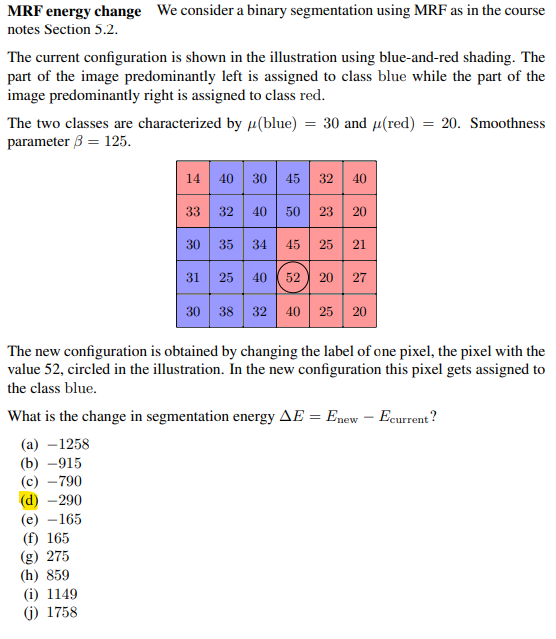

Again, it is about to calculate only for that one point

#### Mine

In [138]:
image = np.flip(np.array([[30, 38, 32, 40, 25, 20],
                 [31, 25, 40, 52, 20, 27],
                 [30, 35, 34, 45, 25, 21],
                 [33, 32, 40, 50, 23, 20],
                 [14, 40, 30, 45, 32, 40]]), axis=0)
print(image)
S_old = np.array([[0, 1, 1, 1, 0, 0],
                [0, 1, 1, 1, 0, 0],
                [1, 1, 1, 0, 0, 0],
                [1, 1, 1, 0, 0, 0],
                [1, 1, 1, 0, 0, 0]])

S_new =  np.array([[0, 1, 1, 1, 0, 0],
             [0, 1, 1, 1, 0, 0],
             [1, 1, 1, 0, 0, 0],
             [1, 1, 1, 1, 0, 0],
             [1, 1, 1, 0, 0, 0]])
mu = {1:30, 0:20}
beta = 125
v1_old, v2_old = compute_V1_and_V2(image, S_old, mu, beta_horizontally=beta, beta_vertically=beta)
v1_new, v2_new = compute_V1_and_V2(image, S_new, mu, beta_horizontally=beta, beta_vertically=beta)

print('energy difference:', v1_new + v2_new - (v1_old + v2_old))

[[14 40 30 45 32 40]
 [33 32 40 50 23 20]
 [30 35 34 45 25 21]
 [31 25 40 52 20 27]
 [30 38 32 40 25 20]]
The likelihood energy term V1 is: 3971
The prior term V2 is: 1125
The posterior energy term V1+V2 is: 5096
The likelihood energy term V1 is: 3431
The prior term V2 is: 1375
The posterior energy term V1+V2 is: 4806
energy difference: -290


#### Solution

In [139]:
E_old = (52 - 20)**2 + 125*1
E_new = (52 - 30)**2 + 3*125
print(f'Question 10: {E_new - E_old}')
print(f'Question 10: {(52-30)**2-(52-20)**2+(3-1)*125}')

Question 10: -290
Question 10: -290


### Question 11) Posterior energy

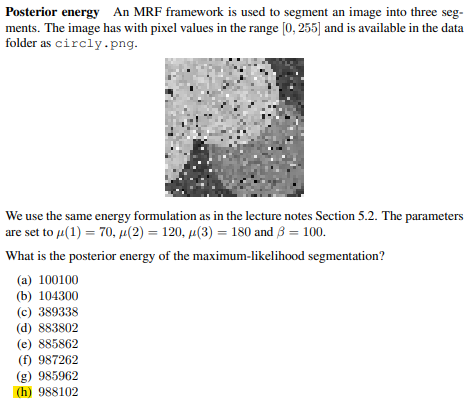

#### Mine

minimum value: 1, maximum value: 255
(3, 1, 1)
The likelihood energy term V1 is: 883802
The prior term V2 is: 104300
The posterior energy term V1+V2 is: 988102


Text(0.5, 1.0, 'Segmented image')

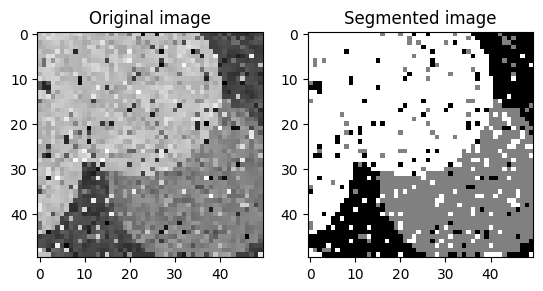

In [140]:
image = get_gray_image('exam_data/exam2021/circly.png')

mu = np.array([70, 120, 180])[:, None, None]
print(mu.shape)

prob = (image[None, :, :] - mu) ** 2
mask = np.argmin(prob, axis=0)

mu_dict = {0: 70, 1: 120, 2: 180}
V1, V2 = compute_V1_and_V2(image, mask, mu_dict, beta_horizontally=100, beta_vertically=100)

fig, ax = plt.subplots(1, 2)
ax[0].imshow(image, cmap='gray')
ax[0].set_title('Original image')
ax[1].imshow(mask, cmap='gray')
ax[1].set_title('Segmented image')

#### Solution

Question 11: 988102


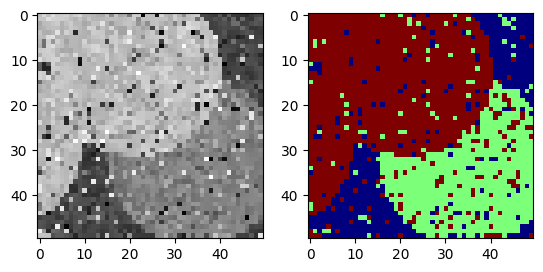

In [141]:
I = skimage.io.imread('exam_data/exam2021/circly.png').astype(float)
mu = np.array([70, 120, 180], dtype=float)
beta = 100

U = (I.reshape(I.shape+(1,)) - mu.reshape(1,1,-1))**2
S0 = np.argmin(U, axis=2)

prior = beta * ((S0[1:,:]!=S0[:-1,:]).sum() + (S0[:,1:]!=S0[:,:-1]).sum()) 
likelihood = int(((mu[S0]-I)**2).sum())

fig, ax = plt.subplots(1,2)
ax[0].imshow(I, cmap=plt.cm.gray, vmin=0, vmax=255)
ax[1].imshow(S0, cmap=plt.cm.jet, vmin=0, vmax=2)
print(f'Question 11: {prior + likelihood}')


### Question 12) Binary MRF

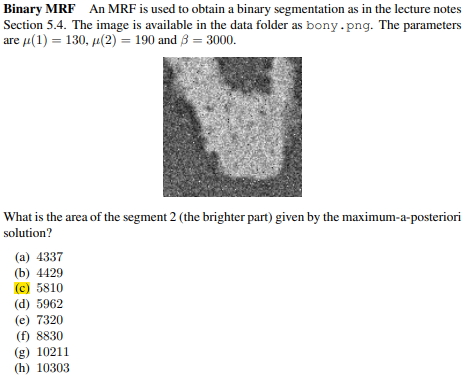

#### Mine

2.0 255.0
float64
[0 1]
Total number of pixels 14640
Number of segmented pixels 5810
Number of pixels in mask 6936


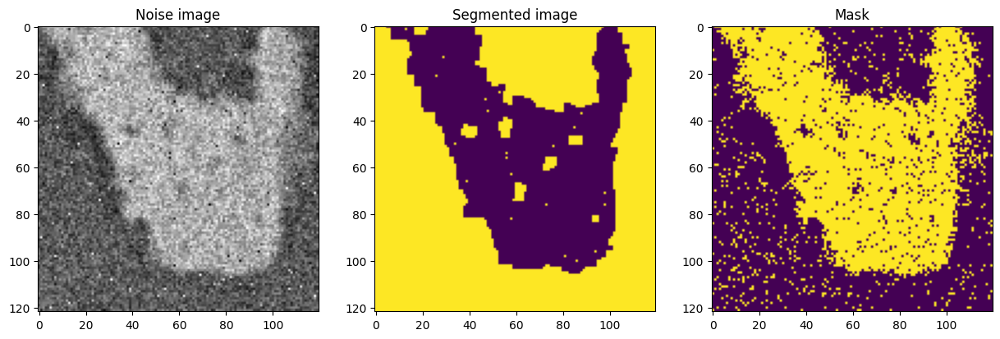

In [142]:
image = get_gray_image_float('exam_data/exam2021/bony.png')*255
print(np.min(image), np.max(image))
print(image.dtype)
mask = image > 130
mu = [130, 190]
beta = 3000
image_segmented = markov_segmentation(image, mu, beta)    
fig, ax = plt.subplots(1,3,figsize=(15,5))
ax[0].imshow(image, cmap='gray')
ax[0].set_title('Noise image')
ax[1].imshow(image_segmented)
ax[1].set_title('Segmented image')
ax[2].imshow(mask)
ax[2].set_title('Mask')
print(np.unique(image_segmented))
print('Total number of pixels', image.shape[0]*image.shape[1])
print('Number of segmented pixels', np.sum(image_segmented == 0))
print('Number of pixels in mask', np.sum(mask))

#### Solutions

Question 12: 5810


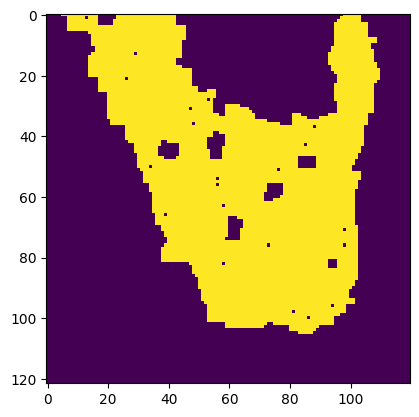

In [143]:
I = skimage.io.imread('exam_data/exam2021/bony.png').astype(float)
mu = np.array([130, 190], dtype=float)
beta  = 3000

# Graph with internal and external edges
U = (I.reshape(I.shape+(1,)) - mu.reshape(1,1,-1))**2
g = maxflow.Graph[float]()
nodeids = g.add_grid_nodes(I.shape)
g.add_grid_edges(nodeids, beta)
g.add_grid_tedges(nodeids, U[:,:,1], U[:,:,0])
g.maxflow()
S = g.get_grid_segments(nodeids)

# Visualization
fig, ax = plt.subplots()
ax.imshow(S)
print(f'Question 12: {S.sum()}')


### Question 13) Deformable models

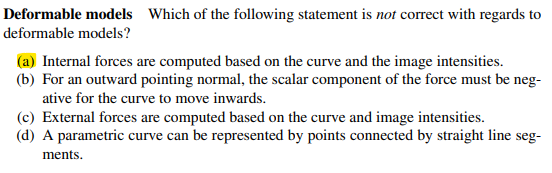

**(a)** Internal forces are only calculated for the curve

### Question 14) External force

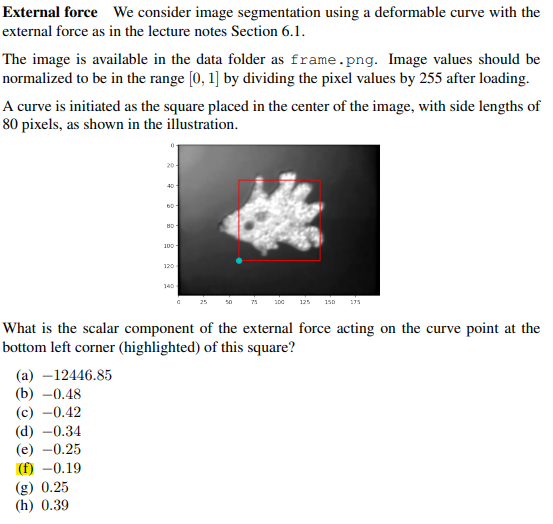

Here they want to see if you can calculate it for a pixel that is not rounded. I did just take the pixel closest to it.

#### Mine

0.0 1.0
(150, 200)
Center: (75, 100)
[-0.18328257]
[115  60]
0.19141637814449883


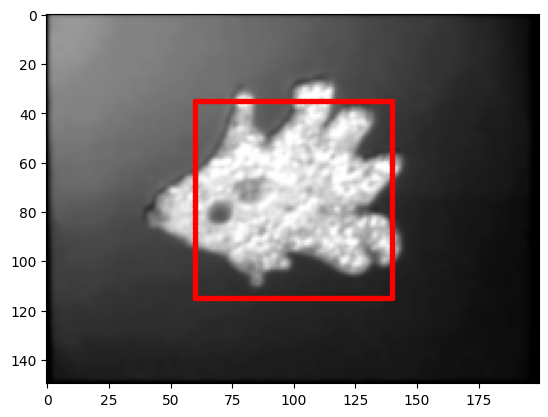

In [144]:
image = get_gray_image_float('exam_data/exam2021/frame.png')
print(np.min(image), np.max(image))
print(image.shape)
center = image.shape[0] // 2, image.shape[1] // 2

center = image.shape[0] // 2, image.shape[1] // 2
print("Center:", center)

# Define half the side length
half_side = 80 // 2

top    = center[0] - half_side
bottom = center[0] + half_side
left   = center[1] - half_side
right  = center[1] + half_side

snake_lower = []

# Start at lower-left, go clockwise

# Left side (bottom to top)
for y in range(bottom, top, -1):
    snake_lower.append([y, left])

# Top side (left to right)
for x in range(left, right):
    snake_lower.append([top, x])

# Right side (top to bottom)
for y in range(top, bottom):
    snake_lower.append([y, right])

# Bottom side (right to left)
for x in range(right, left, -1):
    snake_lower.append([bottom, x])

snake_lower = np.array(snake_lower)

plt.imshow(image, cmap='gray')
plt.plot(snake_lower[:,1], snake_lower[:,0], 'r.-')
plt.plot(snake_lower[0,1], snake_lower[0,0], 'ro', markersize=1)  # Start point

f_ext = calculate_Fext(image, snake_lower, neighborhood_size=0)
print(f_ext[0])
print(snake_lower[0])
print(-0.18328257/-11917.94912493*12446.85)

#### Solution

Question 14: -0.19141631805513498
114.5 59.5


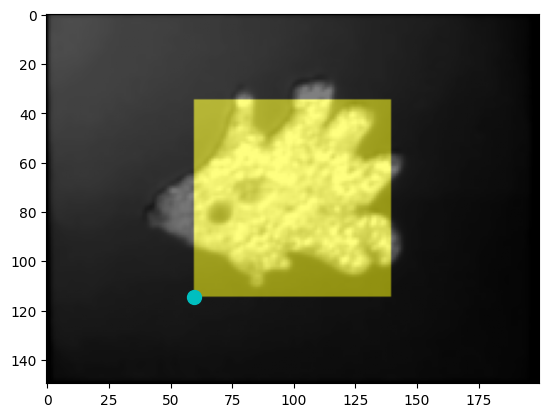

In [145]:
I = skimage.io.imread('exam_data/exam2021/frame.png').astype(float)/255
mask = np.zeros(I.shape, dtype=bool)
mask[I.shape[0]//2-40:I.shape[0]//2+40, I.shape[1]//2-40:I.shape[1]//2+40] = 1

m_in = np.mean(I[mask])
m_out = np.mean(I[~mask])

p = [I.shape[0]/2+39.5, I.shape[1]/2-40.5]
I_p = I[int(p[0]),int(p[1])]
f_ext = (m_in - m_out) * (2*I_p - m_in - m_out)

# Visualization
fig, ax = plt.subplots()
rgb = 0.5*(np.stack((I,I,I), axis=2) + np.stack((mask,mask,0*mask), axis=2))
ax.imshow(rgb)
ax.plot(p[1], p[0], 'co',markersize=10)
print(f'Question 14: {f_ext}')
print(p[0], p[1])

### Question 15) Curve smoothing

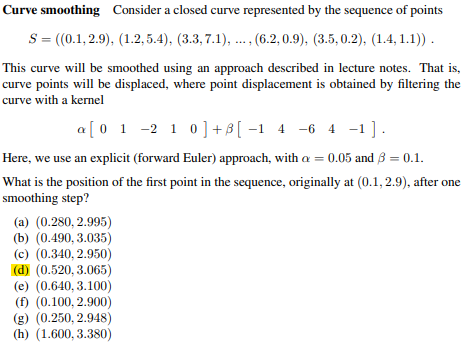

#### Mine

What we need to realize here it that the forward method also can be use for $\alpha$ and $\beta$. In the lecture we used it with $\lambda$ where we had:
$$
\mathbf{X} = (\mathbf{I} + \lambda \mathbf{L}) \mathbf{X} 
$$

and with $\alpha$ and $\beta$ we have:
$$
\mathbf{X} = (\mathbf{I} + \alpha \mathbf{L} + \beta \mathbf{L}) \mathbf{X}
$$

and remember that the point we want to smooth is the one in the middle of the two points.

In [146]:
data = np.array([[3.5, 0.2], [1.4, 1.1], [0.1, 2.9], [1.2, 5.4], [3.3, 7.1]])
alpha = 0.05
beta = 0.1
len_data = len(data)
I = np.eye(len_data)
alpha_vec = np.zeros(len_data)
alpha_vec[-1], alpha_vec[0], alpha_vec[1] = 1, -2, 1 

beta_vec = np.zeros(len_data)
beta_vec[-2], beta_vec[-1], beta_vec[0], beta_vec[1], beta_vec[2] = -1, 4, -6, 4, -1

A = circulant(alpha_vec)
B = circulant(beta_vec)
matrix = (I + alpha*A + beta*B) 
smoothed = matrix @ data.copy()
print('point smoothed:', smoothed[2])

point smoothed: [0.52  3.065]


#### Solutions

Question 15: [0.52  3.065]


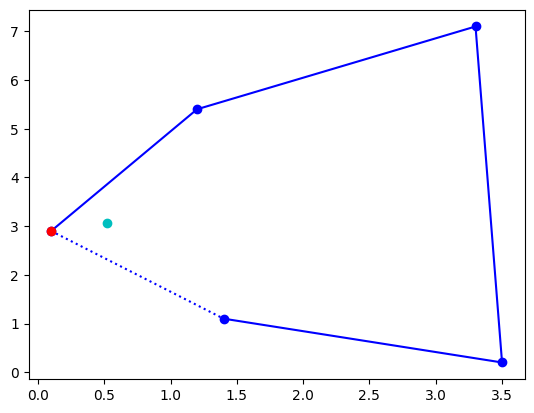

In [147]:
S = np.array([[0.1, 2.9], [1.2, 5.4], [3.3, 7.1], [3.5, 0.2], [1.4, 1.1]])
P = S[0] + 0.05*(S[1]+S[-1]-2*S[0]) + 0.1*(-S[2]-S[-2]+4*S[1]+4*S[-1]-6*S[0])
# Visualization
fig, ax = plt.subplots()
ax.plot(S[:,0], S[:,1], 'b-o',S[[0,-1],0], S[[0,-1],1], 'b:')
ax.plot(S[0,0], S[0,1], 'ro', P[0], P[1], 'co')
print(f'Question 15: {P}')

### Question 16) Surface detection

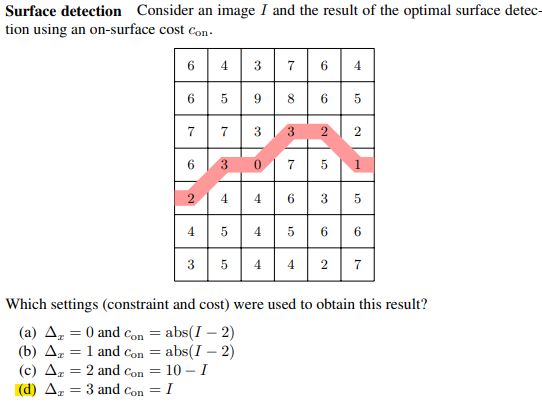

#### Mine

**(a)** wrong since we are not allowed to move in the x direction

**(b)** wrong, for the last column it would have chosen 2 instead of 1 do to the loss function

**(c)** worng, it will have chosen 6 instead of 2 in the first column

**(d)** correct

#### Solution

∆x needs to be larger than 0. Cost con = 10 − I would seek larger values and would not pass 0 in the third column. Cost con = abs(I − 2) would seek 3 instead 0 in the third column and 2 instead of 1 in the sixth column. The correct answer is (d) 

### Question 17) Optimal cost

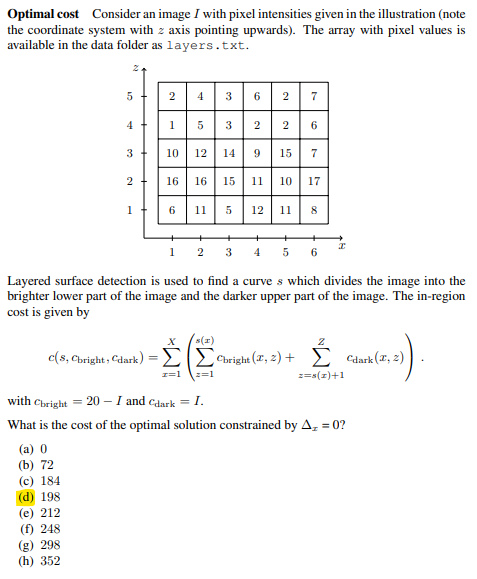

#### Mine

In [148]:
layers = np.loadtxt('exam_data/exam2021/layers.txt')
# layers = np.flip(layers, axis=0)  # Flip the image vertically to match the original orientation
z = 3
for z in range(1,6):
    c_bright = 20 - layers[:z, :]
    c_dark =  layers[z:, :]
    cost = np.sum(c_bright) + np.sum(c_dark)
    print(z, cost)

# print(layers[:z, :])
# print(layers[z:, :])

# print(c_bright)

1 262.0
2 212.0
3 198.0
4 280.0
5 352.0


#### Solution

In [149]:
I = np.loadtxt('exam_data/exam2021/layers.txt')
bright = (20-I).sum(axis=1)
dark = I.sum(axis=1)
cost = [bright[0:s+1].sum() + dark[s+1:].sum() for s in range(I.shape[0])]
print(f'Question 17: {min(cost)}')


Question 17: 198.0


### Question 18) Loss value

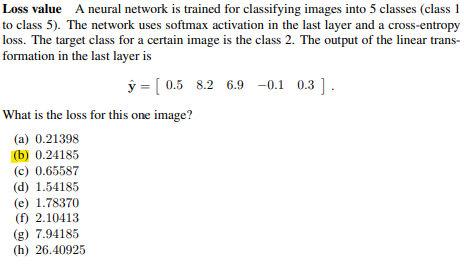

#### Mine

In [150]:
softmax = lambda x: np.exp(x) / np.sum(np.exp(x), axis=1, keepdims=True)

y_hat = np.array([[0.5, 8.2, 6.9, -0.1, 0.3]])

y = softmax(y_hat)
print(f'y_hat: {y_hat}')
print(f'y: {np.round(y,2)}')

loss = - np.log(y[0,1])
print(f'loss: {loss}')

y_hat: [[ 0.5  8.2  6.9 -0.1  0.3]]
y: [[0.   0.79 0.21 0.   0.  ]]
loss: 0.2418505830446608


#### Solution

In [151]:
yhat = np.array([0.5, 8.2, 6.9, -0.1, 0.3])
y = np.exp(yhat)
y /= y.sum()
print(f'Question 18: {-np.log(y[1])}')

Question 18: 0.2418505830446608


### Question 19) Loss value

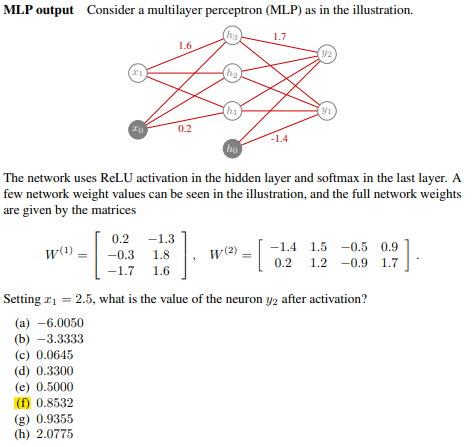

The point here is to look at the graph and see what column is the bias and then add a 1 there

#### Mine

In [152]:
W1 =np.array([[ 0.2, -1.3],
              [-0.3, 1.8],
              [-1.7, 1.6]])

W2 = np.array([[-1.4, 1.5, -0.5, 0.9],
               [0.2, 1.2, -0.9, 1.7]])

x1 = 2.5
x = np.array([1, x1])[:, None]

print(f'x: {x}')
print(f'W1: {W1}')
print(f'W2: {W2}')

ReLU = lambda x: np.maximum(0, x)
h = ReLU(W1 @ x)
h = np.vstack((1, h))
print(f'h: {h}')
softmax = lambda x: np.exp(x) / np.sum(np.exp(x), axis=0, keepdims=True)
y = softmax(W2 @ h)
print(y[1])

x: [[1. ]
 [2.5]]
W1: [[ 0.2 -1.3]
 [-0.3  1.8]
 [-1.7  1.6]]
W2: [[-1.4  1.5 -0.5  0.9]
 [ 0.2  1.2 -0.9  1.7]]
h: [[1. ]
 [0. ]
 [4.2]
 [2.3]]
[0.85320966]


#### Solution

In [153]:
W1 = np.array([[0.2, -1.3], [-0.3, 1.8], [-1.7, 1.6]])
W2 = np.array([[-1.4, 1.5, -0.5, 0.9],[0.2, 1.2, -0.9, 1.7]])
hp  = W1 @ np.array([1, 2.5])
yhat = W2 @ np.concatenate((np.array([1]), np.maximum(hp,0)))
y = np.exp(yhat)
y /= y.sum()
print(f'Question 19: {y[1]}')


Question 19: 0.8532096601986175


### Question 20) Network size

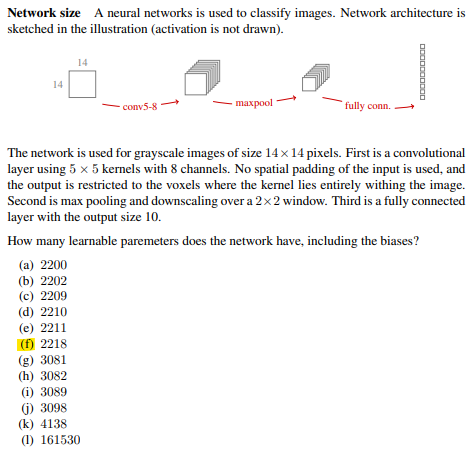

#### Mine

Since we have an input that is 1 channels then we will have 
$$
\text{input} = 1 \times 5 \times 5 + 1 = 26
$$
for 1 filter which we have 8 of. 

The image after the convoltion will have size 10x10x8
After the pooling we will have 5x5x8 so our input to the fully connected layer will be:
$$
\text{input} = 5 \times 5 \times 8  = 200
$$

For the fully connected layer we will have that the number of parameters is given by:
$$
fnn = (input + 1) \cdot output
$$
where input is the number of features in the image and output is the number of classes. We add 1 for the bias.



In [154]:
conv_8 = (1*5*5 + 1)*8
input_fn = 5*5*8
output_fn = 10
fn = (input_fn + 1) * output_fn 
parameter = conv_8 + fn
print(f'parameter: {parameter}')

parameter: 2218


#### Solution

In [155]:
print(f'Question 20: {(5*5+1)*8 + (200+1)*10}')

Question 20: 2218


## Exam 2022

### Question 1) Gaussian derivative


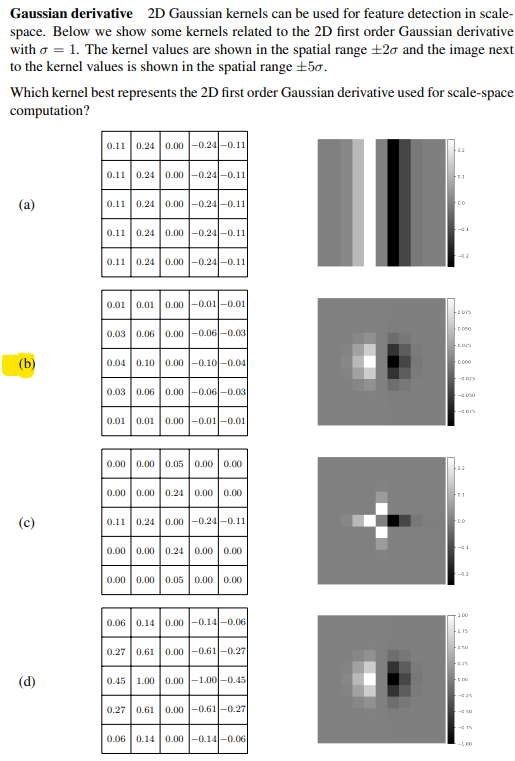

I use that we can multiple the two gaussian together. We are using a normal gaussian in the y (vertical) direction and therefore this should have the shape (:, 1) and we are using a first order derivative in the x (horizontal) direction and therefore this should have the shape (1, :).

In [156]:
t = np.sqrt(1)
trunc = 2
g, dg, ddg, dddg = get_gauss_derivatives(t, trunc)
g = g[:, None]
dg = dg[:, None]
print(f'g shape: {g.shape}')
print(f'dg shape: {dg.T.shape}')
kernel = g @ dg.T
print(f'The kernel is {np.round(kernel,2)}')

g shape: (5, 1)
dg shape: (1, 5)
The kernel is [[ 0.01  0.01  0.   -0.01 -0.01]
 [ 0.03  0.06  0.   -0.06 -0.03]
 [ 0.04  0.1   0.   -0.1  -0.04]
 [ 0.03  0.06  0.   -0.06 -0.03]
 [ 0.01  0.01  0.   -0.01 -0.01]]


#### Solution

Question 1: b
[[ 0.01  0.01  0.   -0.01 -0.01]
 [ 0.03  0.06  0.   -0.06 -0.03]
 [ 0.04  0.1   0.   -0.1  -0.04]
 [ 0.03  0.06  0.   -0.06 -0.03]
 [ 0.01  0.01  0.   -0.01 -0.01]]


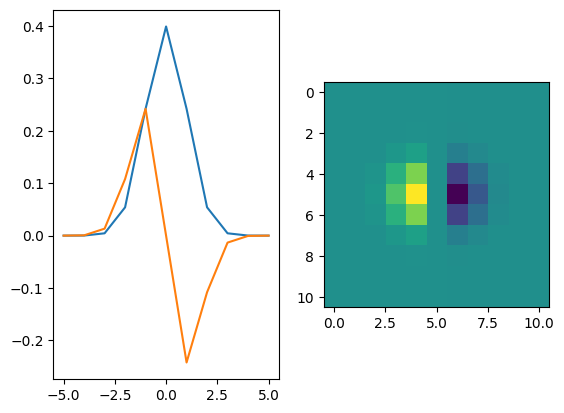

In [157]:
#%% Question 1 - Gaussian derivative
s = 1
x = np.arange(-5*s,5*s+1)[:,None]
g = 1 / (s*np.sqrt(2*np.pi)) * np.exp(-x**2/(2*s**2))
dg = -x / s**2*g
kernel = g @ dg.T
fig, ax = plt.subplots(1,2)
ax[0].plot(x,g)
ax[0].plot(x,dg)
ax[1].imshow(kernel)

print('Question 1: b')
print(np.round(kernel[3:-3, 3:-3],2))

### Question 2) Scale-space blob detection

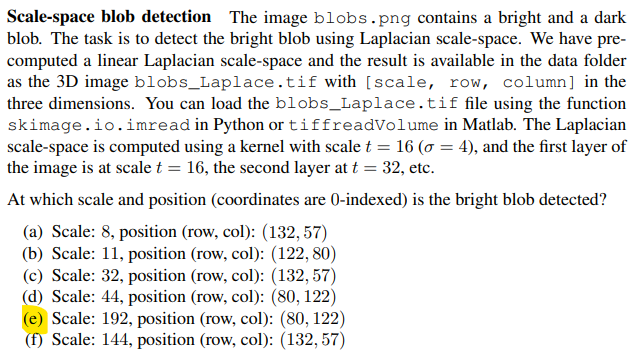

When we have data where the first element contains the laplacian of the image at different scales, then we can use ```peak_local_max``` to find the local maxima. Remember that the local maxima are the white pixels in the image. Since we know that the initial scale are at $t=16$ and it increases with $t=16$ then we calculate the scale at location 11 as $(11 + 1)*16 = 192$, where we add 1 to the index since the index starts at 0.



The blobs are at: [[ 11  80 122]]
The variance used for this blob is 192


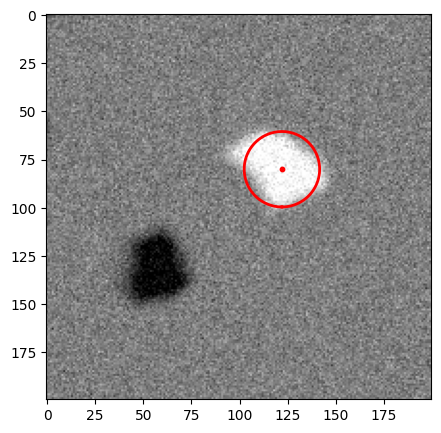

In [158]:
image = get_gray_image_float('exam_data/exam2022/blobs.png')
blobs = skimage.io.imread('exam_data/exam2022/blobs_Laplace.tif')
maximum = peak_local_max(-blobs, threshold_abs=30)  # scale, row column
print('The blobs are at:', maximum)

scale = (maximum[0, 0]+1)*16
theta = np.linspace(0, 2*np.pi, 100)
d = np.sqrt(2*scale)            # the diameter of the blob
x = d*np.cos(theta) + maximum[0, 1]
y = d*np.sin(theta) + maximum[0, 2]

plt.figure(figsize=(5,5))    
plt.imshow(image, cmap='gray')
plt.scatter(maximum[:, 2], maximum[:, 1], s=10, c='red', marker='o')
plt.plot(y, x, 'r-', lw=2)

print(f'The variance used for this blob is {scale}')


#### Solution

Question 2:
  Scale: 192, position: (80,122)


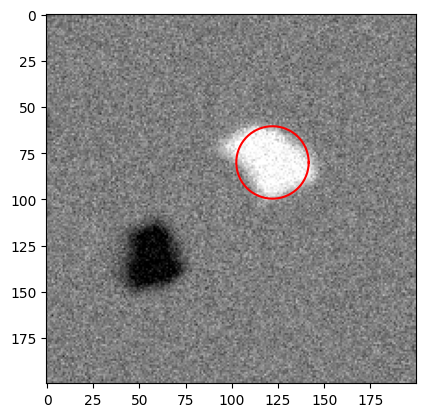

In [159]:
import skimage.feature

L = skimage.io.imread('exam_data/exam2022/blobs_Laplace.tif')
coords = skimage.feature.peak_local_max(-L, threshold_abs=60)
sc, r, c = coords[0]
scale = 16*(sc+1)
print('Question 2:') 
print(f'  Scale: {scale}, position: ({r},{c})')

# From here just checking
fig, ax = plt.subplots()
im = skimage.io.imread('exam_data/exam2022/blobs.png')
ax.imshow(im, cmap='gray')
theta = np.linspace(0, 2*np.pi, 200)
d = np.sqrt(2*scale)
x = np.cos(theta)*d + c
y = np.sin(theta)*d + r
ax.plot(x, y, 'r')

### Question 3) Feature-based segmentation


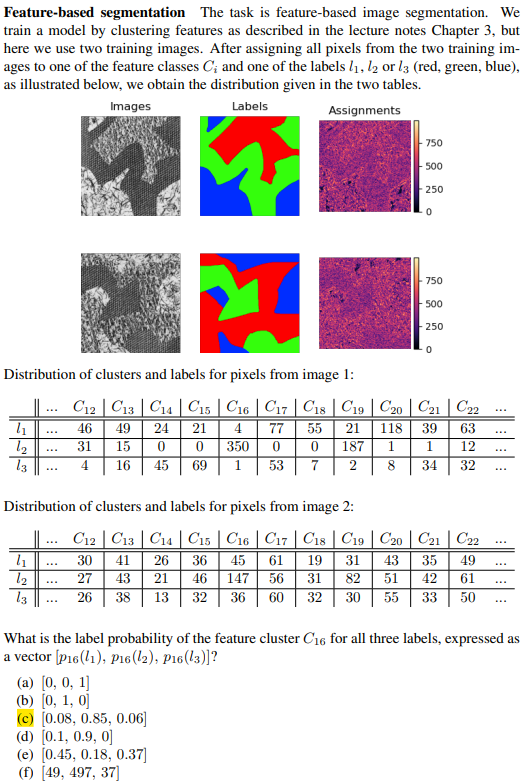

In the following the probabilites are calculated using the following formula:
$$
p_{16}(l_k) = \frac{count of label l_k in cluster C16}{total count of labels in cluster C16}
$$
We are not using softmax since we are not modeling the probabilities from networks. 


In [160]:
# first we add the labels together for the two images
label1 = np.array([4, 350, 1])[None, :]
label2 = np.array([45, 147, 36])[None, :]

label_sum = label1 + label2
prob = label_sum / label_sum.sum()
print('The probability of the sum is:')
print(np.round(prob,2))

The probability of the sum is:
[[0.08 0.85 0.06]]


#### Solution

In [161]:
label1 = np.array([4, 350, 1])
label2 = np.array([45, 147, 36])

label = label1 + label2
prob = label/label.sum()
print(f'Question 3: {np.round(prob,3)}')

Question 3: [0.084 0.852 0.063]


### Question 4) Segmentation with image patches



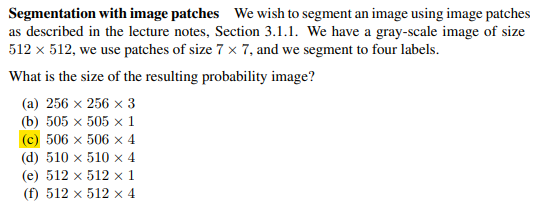

When we use images patches of size 7x7, then we will use that to calculate a feature vector for the pixel in the center. Therefore we will have a feature vector of size 7x7x3 = 147. But this also means that we can not calculate the feature vector for the pixels at the border of the image. Therefore we need to remove the border pixels. The image is 512x512 and we are removing 3 pixels from each side, therefore we have a new image size of 506x506. The channels of the image is equal to the number of labels, which is 4. Therefore the final image size is 506x506x4.

#### solution


Kernel 7 removes 6 gives 506, 4 channels for 4 labels

### Question 5) Matching SIFT features



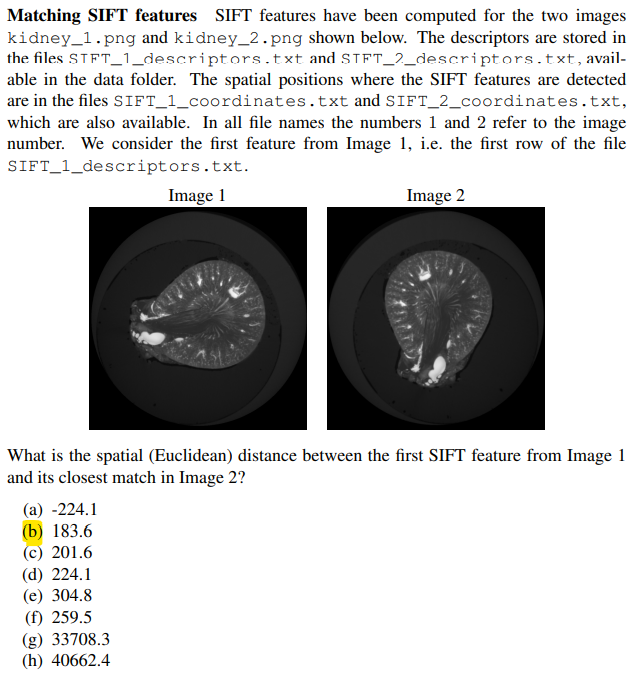

I use the algorithm to calculate if the sift features are similar. We don't have to do this, because we know that the first point in sift1 should be paired with a point in sift2. The squared distance between the two descriptors are then calculated and the best first is the one with the smallest distance.

#### Mine

length of Euclidean distance vector: 183.60


C:\Users\madsp\AppData\Local\Temp\ipykernel_15764\485619716.py:78: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  x1, y1 = float(pt1[0]), float(pt1[1])
C:\Users\madsp\AppData\Local\Temp\ipykernel_15764\485619716.py:79: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  x2, y2 = float(pt2[0]) + img_1.shape[1], float(pt2[1])


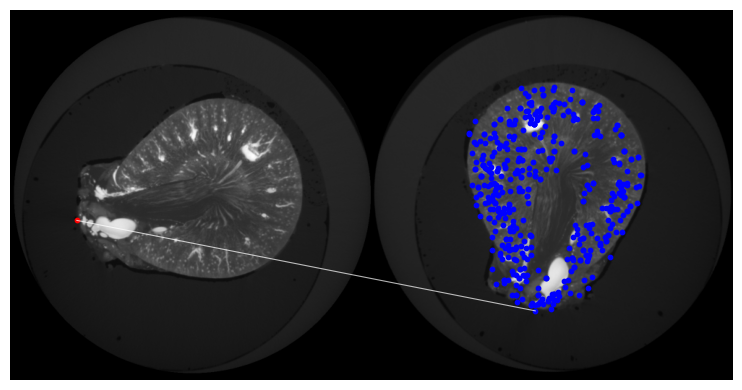

In [162]:
# Import the SIFT descriptors and coordinates
sift_1 = np.loadtxt('exam_data/exam2022/SIFT_1_descriptors.txt')
sift_2 = np.loadtxt('exam_data/exam2022/SIFT_2_descriptors.txt')

sift_1_coordinates = np.loadtxt('exam_data/exam2022/SIFT_1_coordinates.txt')
sift_2_coordinates = np.loadtxt('exam_data/exam2022/SIFT_2_coordinates.txt')

# we only consider the first feature 1 in image 1
x_1 = np.array([sift_1_coordinates[0, 0]])[None, :]
y_1 = np.array([sift_1_coordinates[0, 1]])[None, :]
x_2 = sift_2_coordinates[:, 0][:,None]
y_2 = sift_2_coordinates[:, 1][:,None]

# Convert the SIFT descriptors to float32 for OpenCV compatibility
sift_1 = np.asarray(sift_1[0, :], np.float32)[None, :]
sift_2 = np.asarray(sift_2, np.float32)

# print(f'type(sift_1): {type(sift_1)}')
# print(f'type(sift_2): {type(sift_2)}')
# print(f'dtype(sift_1): {sift_1.dtype}')
# print(f'dtype(sift_2): {sift_2.dtype}')
# print(f'sift_1.shape: {sift_1.shape}')
# print(f'sift_2.shape: {sift_2.shape}')
# print(f'sift_1_coordinates.shape: {sift_1_coordinates.shape}')
# print(f'sift_2_coordinates.shape: {sift_2_coordinates.shape}')
# print(f'x_1.shape: {x_1.shape}')
# print(f'y_1.shape: {y_1.shape}')
# print(f'x_2.shape: {x_2.shape}')    
# print(f'y_2.shape: {y_2.shape}')


lowe_threshold = 0.8
bf = cv.BFMatcher(cv.NORM_L2, crossCheck=False)

# knnMatch() finds the two closest matches (best and second-best) for each descriptor in des1 from des2.
matches = bf.knnMatch(sift_1, sift_2, k=2)        

# Apply Lowe's ratio test to select good matches
# m is the best match and n is the second best match to a given keypoint
good_matches = []
for m, n in matches:                            # m is the best match and n is the second best match
    if m.distance < lowe_threshold * n.distance:  # If the distance of the best match is less than the ratio times the distance of the second best match
        good_matches.append(m)   

pts_1 = []  # from image 1
pts_2 = []  # from image 2

for match in good_matches:
    idx_a = match.queryIdx  # index in sift_1
    idx_b = match.trainIdx  # index in sift_2

    # Use indices to get coordinates
    x1, y1 = x_1[idx_a], y_1[idx_a]
    x2, y2 = x_2[idx_b], y_2[idx_b]

    pts_1.append([x1, y1])
    pts_2.append([x2, y2])

pts_1 = np.array(pts_1)
pts_2 = np.array(pts_2)

print(f'length of Euclidean distance vector: {np.linalg.norm(pts_1 - pts_2):.2f}')
# plot images
img_1 = get_gray_image_float('exam_data/exam2022/kidney_1.png')
img_2 = get_gray_image_float('exam_data/exam2022/kidney_2.png')
combined_img = np.hstack((img_1, img_2))

fig, ax = plt.subplots(figsize=(8, 4))
ax.imshow(combined_img, cmap='gray')
ax.set_axis_off()

# Plot features
ax.scatter(x_1, y_1, c='r', s=10, label='SIFT features (img 1)')
ax.scatter(x_2 + img_1.shape[1], y_2, c='b', s=10, label='SIFT features (img 2)')

# Draw lines
for pt1, pt2 in zip(pts_1, pts_2):
    x1, y1 = float(pt1[0]), float(pt1[1])
    x2, y2 = float(pt2[0]) + img_1.shape[1], float(pt2[1])
    ax.plot([x1, x2], [y1, y2], color='white', linewidth=0.8, alpha=0.7)

plt.tight_layout()
plt.show()


#### solution

In [163]:
desc1 = np.loadtxt('exam_data/exam2022/SIFT_1_descriptors.txt')
desc2 = np.loadtxt('exam_data/exam2022/SIFT_2_descriptors.txt')

coord1 = np.loadtxt('exam_data/exam2022/SIFT_1_coordinates.txt')
coord2 = np.loadtxt('exam_data/exam2022/SIFT_2_coordinates.txt')

d = ((desc1[0]-desc2)**2).sum(axis=1)
idx = np.argmin(d)
dist = np.sqrt(((coord1[0] - coord2[idx])**2).sum())
print(f'Question 5: {dist}')

Question 5: 183.5980848075491


### Question 6) Feature-based image registration

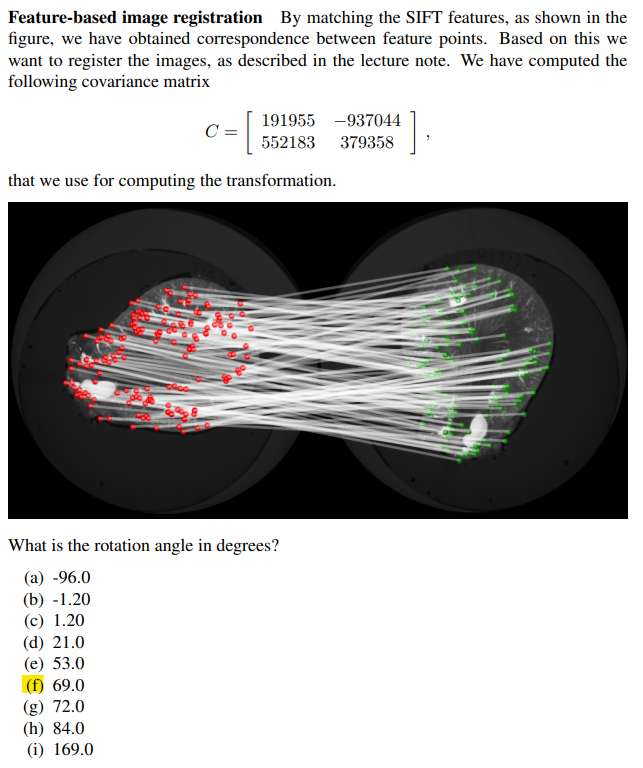

In the solution I use that we know the covariance matrix can be split up using singular value decomposition:
$$
U\Sigma V^T = C
$$
where the rotational matrix is given by 
$$
\hat{R} = U V^T
$$ 
If $det(\hat{R}) = 1$ then we have a rotation matrix. If $det(\hat{R}) = -1$ 

```python
if np.linalg.det(R) < 0:
    Vt[-1, :] *= -1  # flip the last row
    R = U @ Vt       # recompute the corrected rotation
```

#### Mine

In [164]:
C = np.array([[191955, -937044], [552183, 379358]])
U, S, Vt = np.linalg.svd(C)
print(f'C\n {C}')
print("U:\n", U)
print("Singular values:\n", S)
print("Vt:\n", Vt)

R_hat = U @ Vt
theta = np.rad2deg(np.arccos(R_hat[0, 0]))
print("R_hat:\n", R_hat)
print("theta:\n", np.round(theta, 1))
print('det =', np.round(np.linalg.det(R_hat),2))


C
 [[ 191955 -937044]
 [ 552183  379358]]
U:
 [[-0.91722877  0.39836087]
 [ 0.39836087  0.91722877]]
Singular values:
 [1011558.20558533  583495.27361153]
Vt:
 [[ 0.04339983  0.99905778]
 [ 0.99905778 -0.04339983]]
R_hat:
 [[ 0.35817796 -0.93365333]
 [ 0.93365333  0.35817796]]
theta:
 69.0
det = 1.0


#### solution


In [165]:
C = np.array([[191955, -937044],[552183, 379358]])

U, S, V = np.linalg.svd(C)
R = U @ V
print(f'Question 6: {np.arccos(R[0,0])/np.pi*180}')

Question 6: 69.01165964850452


### Question 7) Gaussian convolution 


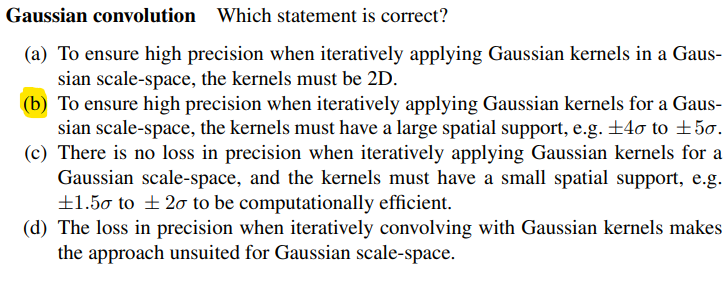

#### Mine

(a) This is not correct. The Gaussian kernels can be 1D or 2D, but the precision is not affected by the dimensionality of the kernel.

**(b) This is correct. The precision is affected by the spatial support of the kernel, which should be above  ±4σ.**

(c) This is not correct. There is a loss in precision when iteratively convolving with Gaussian kernels for a Gaussian scale-space, and the kernels must have a higher spatial support.

(d) This is not correct. The loss in precision when iteratively convolving with Gaussian kernels does not make the approach unsuited for Gaussian scale-space, but it can affect the results.

### Question 8) MRF prior energy

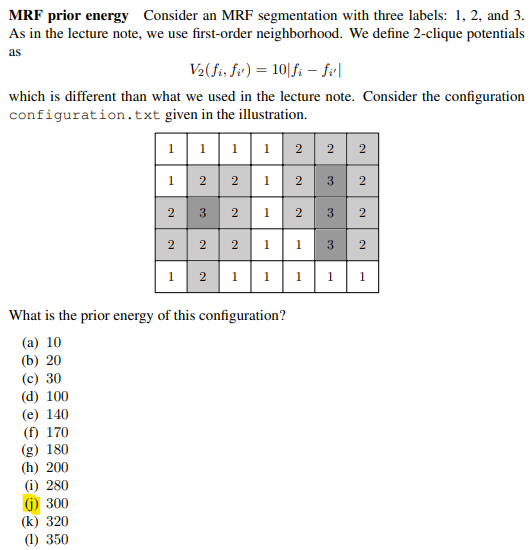

The reason why they said, that the 2-clique potentials are different from the ones used in the lecture notes is because, they were given as:
$$
V_2(f_i, f_{i'}) = \begin{cases}
1, &  f_i = f_{i'} \\
0, & \text{otherwise}
\end{cases}
$$
but now we are using the difference between the three labels.
Above $f_i$ and $f_{i'}$ are the labels of the two pixels in the clique, and $V_2(f_i, f_{i'})$ is the potential energy of the clique. The prior energy is the sum of all 2-clique potentials for all 2-cliques (all pairs of neighbors)  

#### Mine

In [166]:
S = np.loadtxt('exam_data/exam2022/configuration.txt')
vertically = np.abs(np.diff(S, axis=1)).sum()
horizontally = np.abs(np.diff(S, axis=0)).sum()
prior  = 10 * (vertically + horizontally)
print('The prior energy is given as: ', prior)

The prior energy is given as:  300.0


#### Solution

In [167]:
I = np.array([[1, 1, 1, 1, 2, 2, 2],
              [1, 2, 2, 1, 2, 3, 2],
              [2, 3, 2, 1, 2, 3, 2],
              [2, 2, 2, 1, 1, 3, 2],
              [1, 2, 1, 1, 1, 1, 1,]]) 
U2 = 10*(np.abs(np.diff(I, axis=0)).sum() + np.abs(np.diff(I, axis=1)).sum())
print(f'Question 8: {U2}')

Question 8: 300


### Question 9) 


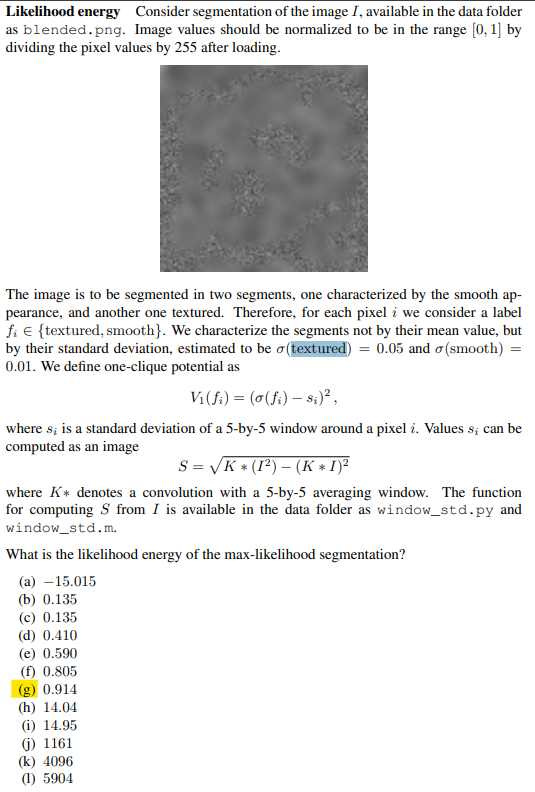

First we see that the one click potential mean that we don't have any smoothing between the pixels. So for each pixel we will calculate the one clique potential for both standard deviation and then choose the one with the lowest value. The likelihood energy is then calculated as the sum of the one clique potential for all pixels. 

#### Mine

max 0.6352941176470588 min 0.2196078431372549
(100, 100)
(100, 100)
The likelihood V1 is 0.9139094725502972


(np.float64(-0.5), np.float64(99.5), np.float64(99.5), np.float64(-0.5))

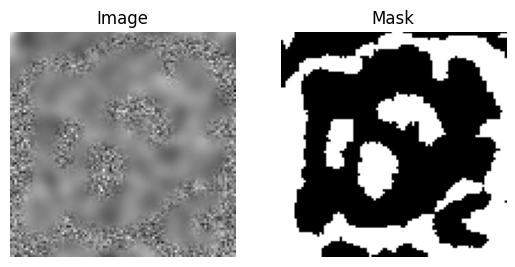

In [168]:
Image = get_gray_image_float('exam_data/exam2022/blended.png')
print(f'max {Image.max()} min {Image.min()}')

# this code is given:
def window_std(I):
    window = np.ones(shape=(5, 5))/25
    K_I2 = scipy.ndimage.convolve(I**2, window, mode='reflect')
    KI_2 = scipy.ndimage.convolve(I, window, mode='reflect')**2
    return np.sqrt(K_I2 - KI_2)

S = window_std(Image)

std_textured = 0.05
std_smooth = 0.01

V_textured = (std_textured - S)**2
V_smooth = (std_smooth - S)**2
print(V_smooth.shape)
print(V_textured.shape)

# Vectorized version for likelihood computation
V1 = np.where(V_smooth <= V_textured, V_smooth, V_textured)
print(f'The likelihood V1 is {V1.sum()}')

mask = V_textured < V_smooth
fig, ax = plt.subplots(1, 2)    
ax[0].imshow(Image, cmap='gray')
ax[0].set_title('Image')
ax[0].axis('off')
ax[1].imshow(mask, cmap='gray')
ax[1].set_title('Mask')
ax[1].axis('off')

#### Solution

Question 9: 0.9139094725502952


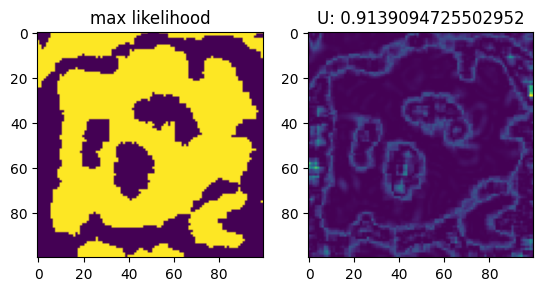

In [169]:
import scipy.ndimage

def window_std(I):
    window = np.ones(shape=(5, 5))/25
    K_I2 = scipy.ndimage.convolve(I**2, window, mode='reflect')
    KI_2 = scipy.ndimage.convolve(I, window, mode='reflect')**2
    return np.sqrt(K_I2 - KI_2)

I = skimage.io.imread('exam_data/exam2022/blended.png')/255
S = window_std(I)

sigma_1 = 0.05  
sigma_2 = 0.01  

U1 = (sigma_1 - S)**2
U2 = (sigma_2 - S)**2

B = U1 > U2  # max likelihood segmentation
L = (1 - B) * U1 + B * U2   # one-clique potentials for this segmentation

fig, ax = plt.subplots(1, 2)
ax[0].imshow(B)
ax[0].set_title('max likelihood')
ax[1].imshow(L)
ax[1].set_title(f'U: {L.sum()}')
print(f'Question 9: {L.sum()}')


### Question 10) External force


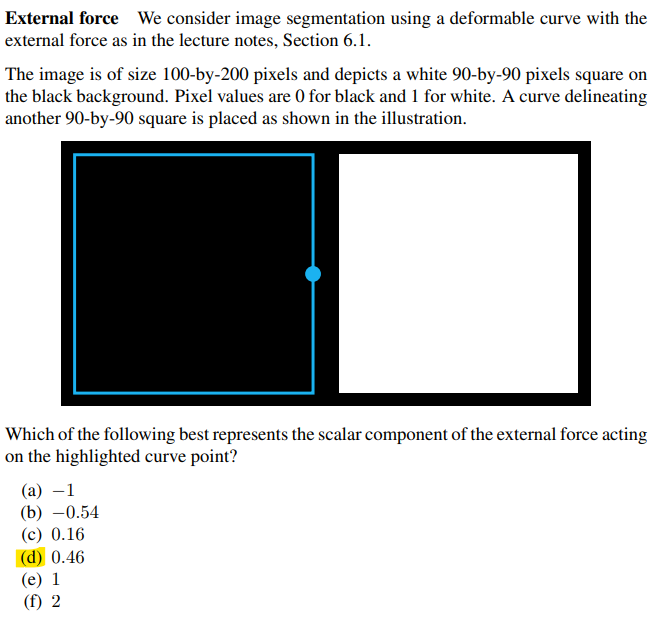

Here we use the following formula to calculate the external force:
$$
F_{ext} = (m_{\text{int}} - m_{\text{out}}) \cdot (2*I - m_{\text{int}} - m_{\text{out}})
$$
where $m_{\text{int}}$ is the mean of the pixels inside the contour and $m_{\text{out}}$ is the mean of the pixels outside the contour and $I$ is the intensity as a function of the pixel position (we calculate it as the mean of the neighbor pixels), which is 0 in the above image.

#### Mine

In [170]:
A_total = 100*200
A_in = 90*90
A_white = 90*90
A_out = A_total - A_in 
A_out_black = A_total - A_in - A_white

m_in = 0*A_in
m_out = (0*A_out_black + 1*A_white)/A_out

print(f'm_in: {m_in}')
print(f'm_out: {m_out}')

I = 0
fext = (m_in - m_out)*(2*I - m_in - m_out)
print(f'Fext: {np.round(fext,2)}')

m_in: 0
m_out: 0.680672268907563
Fext: 0.46


#### Solution

In [171]:
m_in = 0
m_out = 90*90/(100*200-90*90)
f = (m_in-m_out)*(0-m_in-m_out)
print(f'Question 10: {f}')

Question 10: 0.4633147376597698


### Question 11) Curve smoothing 


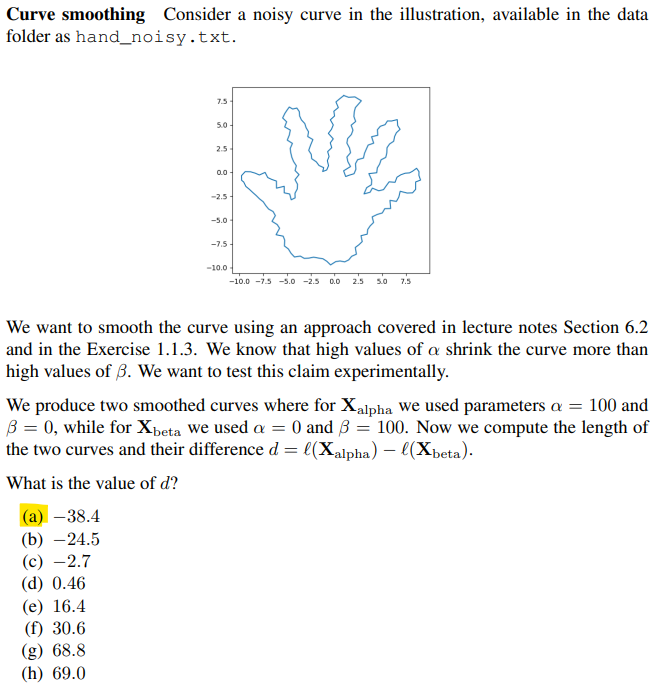

Here I use the function defined in week 1 to calculate the output based on $\alpha$ and $\beta$. 

#### Mine

In [172]:
noisy_hand = np.loadtxt('exam_data/exam2022/hand_noisy.txt')

X_alpha = smoothing_alpha_beta(noisy_hand, alpha=100, beta=0, N=1)
X_beta = smoothing_alpha_beta(noisy_hand, alpha=0, beta=100, N=1)
l_alpha = curve_length(X_alpha)
l_beta = curve_length(X_beta)

d = l_alpha - l_beta
print(f'length of alpha_0: {l_alpha:.2f}')
print(f'length of beta_0: {l_beta:.2f}')
print(f'difference in length: {d:.2f}')

length of alpha_0: 41.07
length of beta_0: 79.52
difference in length: -38.44


#### Solution


Question 11: -38.443856579112804


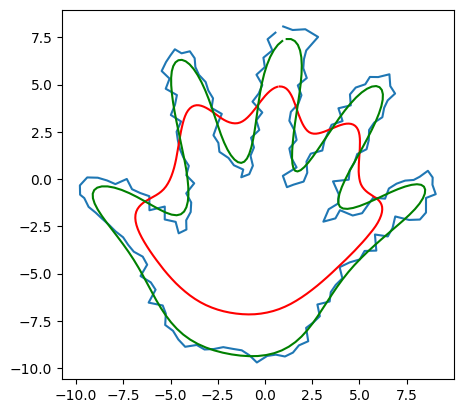

In [173]:
# taken from weekly solutions at gitlab 
def regularization_matrix(N, alpha, beta):
    """An NxN matrix for imposing elasticity and rigidity to snakes.
    Arguments: alpha is weigth for second derivative (elasticity),
    beta is weigth for (-)fourth derivative (rigidity)."""
    d = alpha*np.array([-2, 1, 0, 0]) + beta*np.array([-6, 4, -1, 0])
    D = np.fromfunction(lambda i,j: np.minimum((i-j)%N,(j-i)%N), (N,N), dtype=int)
    A = d[np.minimum(D,len(d)-1)]
    return(np.linalg.inv(np.eye(N)-A))

# taken from weekly solutions at gitlab
def curve_length(X):
    d = X - np.roll(X, shift=1, axis=0)
    d = (d**2).sum(axis=1)
    d = (np.sqrt(d)).sum()
    return(d)

X = np.loadtxt('exam_data/exam2022/hand_noisy.txt')

fig, ax = plt.subplots()
ax.plot(X[:, 0], X[:, 1])
ax.set_aspect('equal')

X_alpha = regularization_matrix(X.shape[0], 100, 0) @ X
X_beta = regularization_matrix(X.shape[0], 0, 100) @ X

ax.plot(X_alpha[:, 0], X_alpha[:, 1], 'r')
ax.plot(X_beta[:, 0], X_beta[:, 1], 'g')

d = curve_length(X_alpha) - curve_length(X_beta)
print(f'Question 11: {d}')

### Question 12) Two surface costs

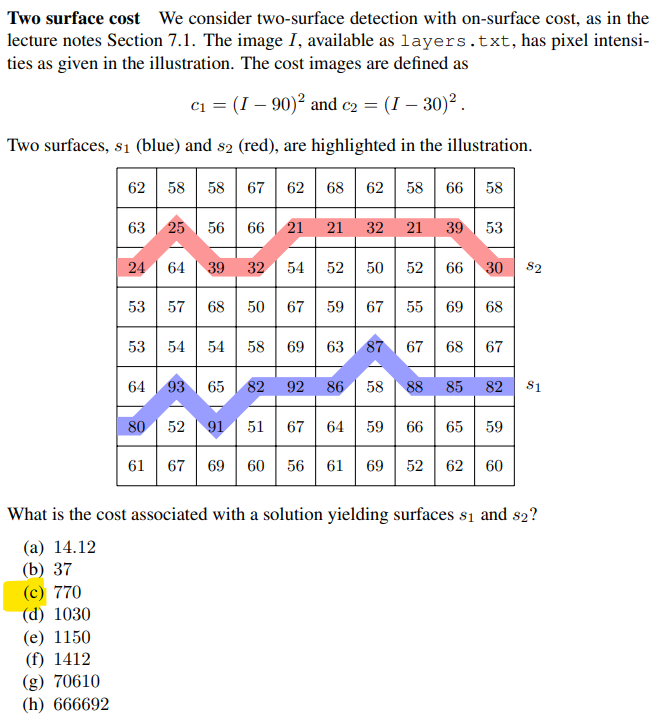


Here I use the defined surface costs where $I$ is the intensity of the pixel::
$$c1 = (I − 90)^2$$
and 
$$c2 = (I − 30)^2$$

And then I summed them together because it is a cost yielding $s_1$ and $s_2$. 

In [174]:
#surface 1
I_1 = np.array([80, 93, 91, 82, 92, 86, 87, 88, 85, 82])
cost_1 = np.sum((I_1 - 90)**2)

#surface 2
I_2 = np.array([24, 25, 39, 32, 21, 21, 32, 21, 39, 30])
cost_2 = np.sum((I_2 - 30)**2)

print(f'cost_1: {cost_1:.2f}')  
print(f'cost_2: {cost_2:.2f}')

print(f'cost_1 + cost_2: {cost_1 + cost_2:.2f}')

cost_1: 296.00
cost_2: 474.00
cost_1 + cost_2: 770.00


#### Solution 

In [175]:
s1 = np.array([80, 93, 91, 82, 92, 86, 87, 88, 85, 82])
s2 = np.array([24, 25, 39, 32, 21, 21, 32, 21, 39, 30])

c = ((s1-90)**2).sum() + ((s2-30)**2).sum()
print(f'Question 12: {c}')

Question 12: 770


### Questiion 13) Surface distance
We consider the optimal surface detection with on-surface cost as in the lecture notes Section 7.1. The cost image con has values as given in the illustration, and also available in the data folder as cost.txt.
Denote by s0 the solution obtained using constraint ∆x = 0, and by s5 the solution obtained using constraint ∆x = 5. What is the mean absolute distance


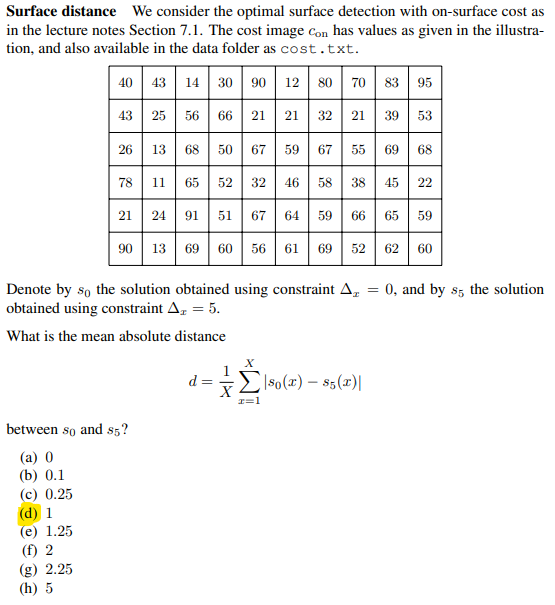

What I did in my solution was to use the code from week 7 and get the best surface. What is smart in the solution is that we have an image with 6 rows, and because $\Delta x = 5$, we can jump to all the rows we want and therefore the problem is solved by finding the lowest number in each column. Whereas the solution to $\Delta x = 0$ is solved by finding the lowest horizontal sum. 

#### Mine

I use the following code in week 7 exam.ipynb
```python
I = np.loadtxt('../exam_data/exam2022/cost.txt')
delta = 0
surface_cost = I  # Example: invert the cost so lower values become higher cost
layer = slgbuilder.GraphObject(surface_cost)

helper = slgbuilder.MaxflowBuilder()
helper.add_object(layer)
helper.add_layered_boundary_cost()
helper.add_layered_smoothness(delta=delta, wrap=False)

helper.solve()
segmentation = helper.what_segments(layer)
segmentation_line = segmentation.shape[0] - np.argmax(segmentation[::-1,:], axis=0) - 1
value_path = I[segmentation_line, np.arange(I.shape[1])]
value = np.sum(value_path)

print(f'The segmentation line is: {segmentation_line}')
print(f'The value path is given as: {value_path}')
print(f'The sum of the value path is given as: {value}')

plt.imshow(I, cmap='gray')
plt.plot(np.arange(len(segmentation_line)), segmentation_line)
plt.title(f'Optimal path for delta {delta} with value {value}')

segmentation_line_0 = segmentation_line.copy()

delta = 5
surface_cost = I  # Example: invert the cost so lower values become higher cost
layer = slgbuilder.GraphObject(surface_cost)

helper = slgbuilder.MaxflowBuilder()
helper.add_object(layer)
helper.add_layered_boundary_cost()
helper.add_layered_smoothness(delta=delta, wrap=False)

helper.solve()
segmentation = helper.what_segments(layer)
segmentation_line = segmentation.shape[0] - np.argmax(segmentation[::-1,:], axis=0) - 1

value_path = I[segmentation_line, np.arange(I.shape[1])]
value = np.sum(value_path)

print(f'The segmentation line is: {segmentation_line}')
print(f'The value path is given as: {value_path}')
print(f'The sum of the value path is given as: {value}')

plt.imshow(I, cmap='gray')
plt.plot(np.arange(len(segmentation_line)), segmentation_line)
plt.title(f'Optimal path for delta {delta} with value {value}')

segmentation_line_5 = segmentation_line.copy()

print(f'The mean between the two paths is: {np.mean(np.abs(segmentation_line_0 - segmentation_line_5))}')
```

#### solution

In [176]:
# Answer (d)
C = np.loadtxt('exam_data/exam2022/cost.txt', dtype=int)
s0 = C.sum(axis=1)
s0 = np.argmin(s0)
s5 = np.argmin(C, axis=0)
d = (abs(s0-s5))
print(f'Question 13: {d.mean()}')

Question 13: 1.0


### Question 14) Classification loss


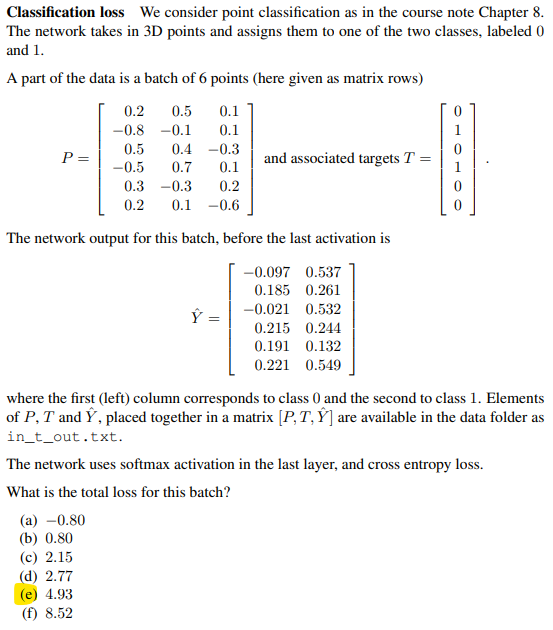

Both solutions are calculated using the same approach, but in the solution the loss is calculated using the following code, which also can be used for not only binary classification, but also for multi-class classification. 
```python
loss = -np.log(y[range(len(y)), t]).sum()
```
where $y$ is the predicted probability and $t$ is the true label. The loss is then calculated as the sum of the negative log of the predicted probability for each true label.

#### Mine

In [177]:
in_t_out = np.loadtxt('exam_data/exam2022/in_t_out.txt')
T = in_t_out[:, 3][:, None]
y_hat = in_t_out[:, -2:]
# print(f'T: {T}')
# print(f'y_hat: {y_hat}')

softmax = lambda x: np.exp(x) / np.sum(np.exp(x), axis=1, keepdims=True)
y = softmax(y_hat)
y_max = np.argmax(y, axis=1)
# print(f'y: {y}')
# print(f'y_max: {y_max}')

binary_cross_entropy = lambda t, y: -(t * np.log(y) + (1 - t) * np.log(1 - y))

BCE = binary_cross_entropy(T, y)
# print(f'BCE: {BCE}')
BCE_sum = 0
for i in range(len(T)):
    if T[i] == 1:
        BCE_sum += -np.log(y[i, 1])
    else:
        BCE_sum += -np.log(y[i, 0])

print(f'BCE_sum: {BCE_sum}')

BCE_sum: 4.936206870617411


#### Solution

In [178]:
in_t_out = np.loadtxt('exam_data/exam2022/in_t_out.txt')

x = in_t_out[:, 0:3]
t = in_t_out[:, 3].astype(int)
yhat = in_t_out[:, 4:]

y = np.exp(yhat)
y = y/y.sum(axis=1, keepdims=True)
# print(range(len(y)))
# print(t)
# print(f'y: {y[range(len(y)), t]}')

loss = -np.log(y[range(len(y)), t]).sum()
print(f'Question 14: {loss}')

Question 14: 4.936206870617411


### Question 15) MLP classification

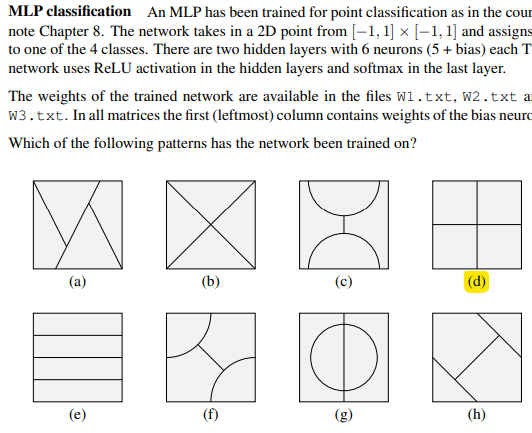

Again the solution are similar, but the approach of plotting is better in the solution.

#### Mine

In [ ]:
W1 = np.loadtxt('exam_data/exam2022/W1.txt')
W2 = np.loadtxt('exam_data/exam2022/W2.txt')
W3 = np.loadtxt('exam_data/exam2022/W3.txt')

print(f'W1: {W1}')
print(f'W2: {W2}')
print(f'W3: {W3}')

x1 = 1
x2 = -1
input = np.array([1, x1, x2])[:, None]  

ReLU = lambda x: np.maximum(0, x)
softmax = lambda x: np.exp(x) / np.sum(np.exp(x), axis=0, keepdims=True)

z2 = W1.T @ input
h2 = ReLU(z2)
h2 = np.vstack((h2, 1))  # Add bias term

z3 = W2.T @ h2
h3 = ReLU(z3)
h3 = np.vstack((h3, 1))  # Add bias term
z4 = W3.T @ h3
y = softmax(z4)
print(f'y: {y}')

W1: [[-0.678  1.441  2.133  1.105 -0.621]
 [ 0.4    3.415 -2.082 -0.933 -0.45 ]
 [-0.064 -1.101 -1.553  4.059  0.007]]
W2: [[ 1.231  0.331  0.914  0.714  0.355]
 [ 0.077 -0.211 -0.336 -0.298  0.411]
 [ 2.251  1.095 -1.58   0.477 -2.633]
 [-1.175 -0.791  1.862  2.101  1.93 ]
 [-0.036  2.624 -0.261 -4.076  0.952]
 [ 0.14  -0.3   -0.274  0.269  0.215]]
W3: [[-0.181  0.317 -0.78   0.157]
 [-1.594  1.964 -1.925  1.581]
 [-2.509 -1.448  0.449  1.491]
 [ 1.366 -0.751  0.245 -1.751]
 [ 2.241  2.331 -2.812 -3.126]
 [ 1.207 -2.198  2.098 -1.411]]
y: [[9.99999998e-01]
 [4.90162587e-12]
 [2.07389936e-09]
 [6.11922807e-21]]


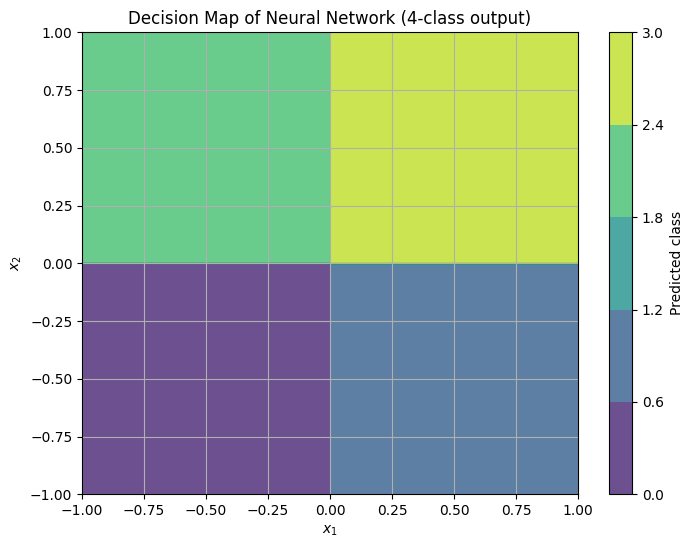

In [180]:
import numpy as np
import matplotlib.pyplot as plt

# Load weights
W1 = np.loadtxt('exam_data/exam2022/W1.txt')
W2 = np.loadtxt('exam_data/exam2022/W2.txt')
W3 = np.loadtxt('exam_data/exam2022/W3.txt')

# Activation functions
ReLU = lambda x: np.maximum(0, x)
softmax = lambda x: np.exp(x) / np.sum(np.exp(x), axis=0, keepdims=True)

# Create meshgrid
x1_vals = np.linspace(-1, 1, 200)
x2_vals = np.linspace(-1, 1, 200)
X1, X2 = np.meshgrid(x1_vals, x2_vals)

# Storage for predicted class labels
class_map = np.zeros_like(X1, dtype=int)

# Evaluate network for each point in the grid
for i in range(X1.shape[0]):
    for j in range(X1.shape[1]):
        x1 = X1[i, j]
        x2 = X2[i, j]
        input = np.array([1, x1, x2])[:, None]  # shape (3, 1)

        # Forward pass
        z2 = W1.T @ input
        h2 = ReLU(z2)
        h2 = np.vstack((1, h2))  # Add bias

        z3 = W2.T @ h2
        h3 = ReLU(z3)
        h3 = np.vstack((1, h3))  # Add bias

        z4 = W3.T @ h3
        y = softmax(z4)

        class_map[i, j] = np.argmax(y)  # class label (0–3)

# Plot decision boundaries
plt.figure(figsize=(8, 6))
plt.contourf(X1, X2, class_map, levels=4, cmap='viridis', alpha=0.8)
plt.colorbar(label='Predicted class')
plt.xlabel('$x_1$')
plt.ylabel('$x_2$')
plt.title('Decision Map of Neural Network (4-class output)')
plt.grid(True)
plt.show()


#### Solution

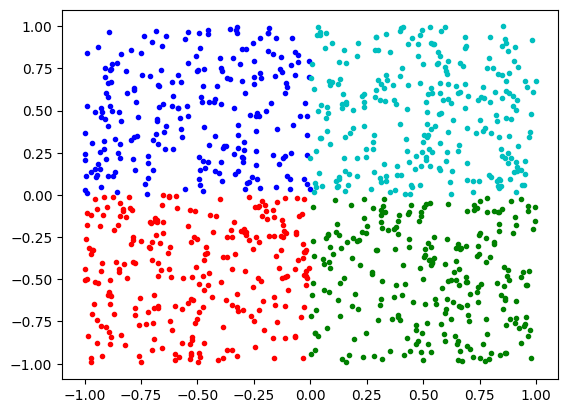

In [181]:
W1 = np.loadtxt('exam_data/exam2022/W1.txt')
W2 = np.loadtxt('exam_data/exam2022/W2.txt')
W3 = np.loadtxt('exam_data/exam2022/W3.txt')

def mlp(x):
    h1 = np.maximum(np.concatenate(([1], x)) @ W1, 0)
    h2 = np.maximum(np.concatenate(([1], h1)) @ W2, 0)
    y_hat = np.concatenate(([1], h2)) @ W3
    y = np.exp(y_hat)
    y = y/y.sum()
    return np.argmax(y)
    
colors = 'rgbc'
fig, ax = plt.subplots()
for i in range(1000):
    x = np.random.uniform(low=-1, high=1, size=2)
    y = mlp(x)
    ax.plot(x[0], x[1], '.'+colors[y])

### Question 16)  MLP backpropagation

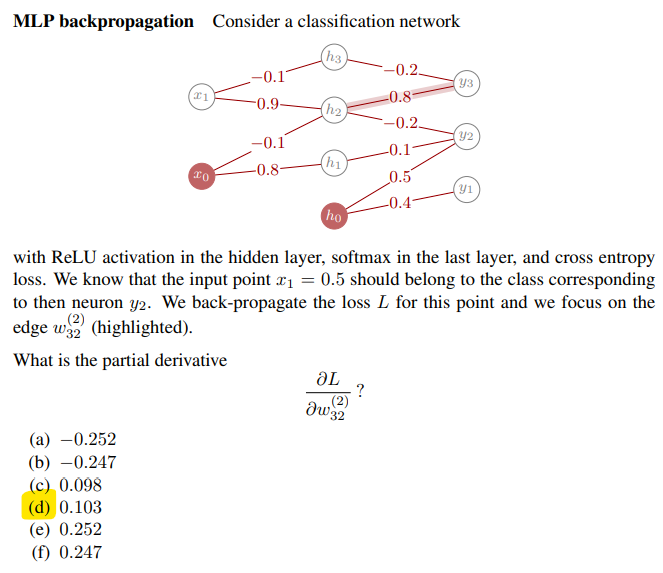

#### Mine

Because we know that the output will belong to class $y_2$ then we have the following equation using the chain rule:
$$
\frac{\partial L}{\partial \omega_{32}} = \frac{\partial L}{\partial y_2} \frac{\partial y_2}{\partial \hat{y_3}} \frac{\partial \hat{y_3}}{\partial \omega_{32}}
$$
where $\hat{y_3}$ is before the softmax function.

The cross entropy loss function is defined as:
$$
L =  -\sum_{i}  t_i \log({y}_i)
$$
where the target $t_i$ is one-hot encoded, so for class $y_2$ we have $t_2 = 1$ and $t_i = 0$ for all other classes, therefore we have:
$$
\frac{\partial L}{\partial y_2} = -\frac{t_2}{y_2} = -\frac{1}{y_2}
$$

The softmax output function is defined as:
$$
y_i = \frac{e^{\hat{y}_i}}{\sum_{j} e^{\hat{y}_j}}
$$

The derivative of the softmax function depends on if $i = j$ or not:
$$
\frac{\partial y_i}{\partial \hat{y}_i} = y_i (1- y_i)
$$
else
$$
\frac{\partial y_i}{\partial \hat{y}_j} = -y_i y_j
$$

Since we are interested in the case where $i = 2$ and $j = 3$, we have:
$$
\frac{\partial y_2}{\partial \hat{y}_3} = -y_2 y_3
$$

Lastly, we need to compute the derivative of the output with respect to the weights:
$$
\hat{y}_3 = \omega_{33} h_3 + \omega_{32} h_2
$$
$$
\frac{\partial \hat{y}_3}{\partial \omega_{32}} = h_2
$$

So we have:
$$
\frac{\partial L}{\partial \omega_{32}} = -\frac{1}{y_2} (-y_2 y_3) h_2
$$


In [182]:
ReLU = lambda x: np.maximum(0, x)
softmax = lambda x: np.exp(x) / np.sum(np.exp(x), axis=0, keepdims=True)

x0 = 1
x1 = 0.5
h3 = ReLU(-0.1*x1)
h2 = ReLU(0.9*x1 -0.1*x0)
h1 = ReLU(0.8*x0)
h0 = 1

y3_hat = -0.2*h3 + 0.8*h2
y2_hat = -0.2*h2 + 0.1*h1 + 0.5*h0
y1_hat= 0.4*h0

y_hat = np.array([y1_hat, y2_hat, y3_hat])
y = softmax(y_hat)
print(f'y_hat: {y_hat}')
print(f'y: {y}')

L = (-1/y[1]) * (-y[1]*y[2]) * h2
print(L)


y_hat: [0.4  0.51 0.28]
y: [0.33297832 0.3716964  0.29532528]
0.10336384761422304


#### Solution

In [183]:
x = 0.5
h = [1, 0.8, -0.1+0.9*x, -0.1*x]
h = [np.max(n,0) for n in h]
yhat = [0.4*h[0], 0.5*h[0]+0.1*h[1]-0.2*h[2], 0.8*h[2]-0.2*h[3]]
y = [np.exp(n) for n in yhat]
y = [n/sum(y) for n in y]

dLdw = h[2]*(y[3-1]) # -1 because y starts with y1
print(f'Question 16: {dLdw}')

Question 16: 0.10409371428948895


### Question 17) Stochastic gradient decent 

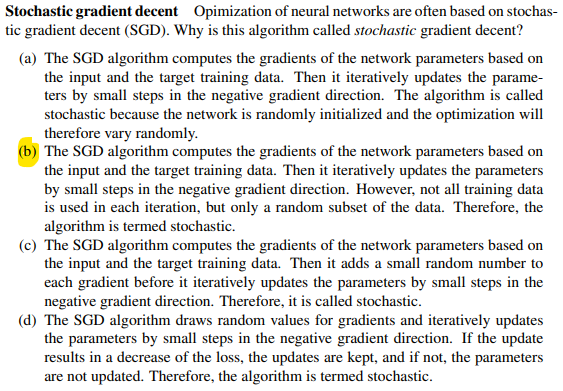

### Question 18) CNN receptive field

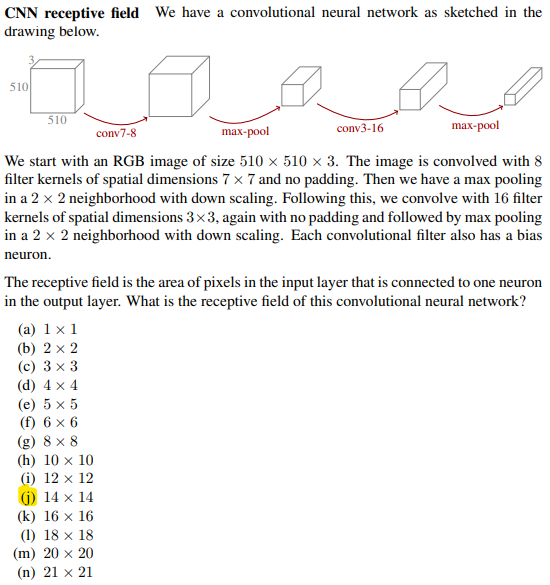

The two solutions are different here I calculate forward and the given solution is backward. 

#### Mine

Because I don't want to calculate back in the system, then I set up the model and change the parameters until I got an output of 1x1.

Remember that when we convolve with a $7\times7$ without padding then we loss 3 pixels on each side, so 6 pixels in total.

Remember that when we convolve with a $3\times3$ without padding then we loss 1 pixels on each side, so 2 pixels in total.

In [184]:
input = np.array([14, 14])

convolve_7_8 = input - 6
max_pool = convolve_7_8 / 2
convolve_3_16 = max_pool - 2
max_pool_2 = convolve_3_16 / 2
print(f'input: {input}')    
print(f'convolve_7_8: {convolve_7_8}')
print(f'max_pool: {max_pool}')
print(f'convolve_3_16: {convolve_3_16}')
print(f'output: {max_pool_2}')  

input: [14 14]
convolve_7_8: [8 8]
max_pool: [4. 4.]
convolve_3_16: [2. 2.]
output: [1. 1.]


#### Solution

In [185]:
# Answer (j) 
# one out pixel -> 1 
# max pool doubles -> 2 (receptive field before max pool)
# 3-by-3 convolution adds 2 -> 4
# max pool doubles -> 8 
# 7-by-7 convolution adds 6 -> 14
r = (1*2 + 2)*2 + 6
print(f'Question 18: {r}x{r}')

Question 18: 14x14


### Question 19) CNN parameters

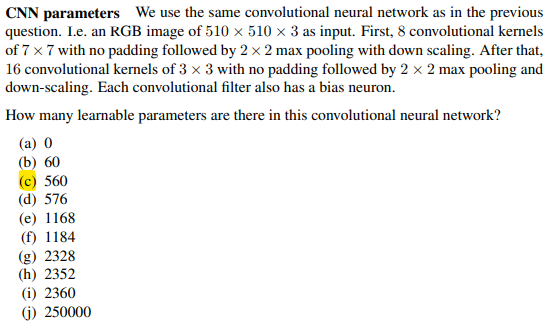

Since we have an input that is 3 channels then we will have 
$$
\text{input} = 3 \times 7 \times 7 + 1 = 148
$$
for 1 filter which we have 8 of. 

For the next convulution we have 8 channels as input and therefore:
$$
\text{input} = 8 \times 3 \times 3 + 1 = 73
$$
which we have 16 of.

#### Mine

In [186]:
conv1 = (7*7*3 + 1)*8
conv2 = (3*3*8 + 1)*16
print(f'sum: {conv1 + conv2}')

sum: 2352


#### Solution

In [187]:
# Answer (h) 
n_param = (1 + 7*7*3)*8 + (1 + 3*3*8)*16
print(f'Question 19: {n_param}')

Question 19: 2352


### Question 20) Data augmentation

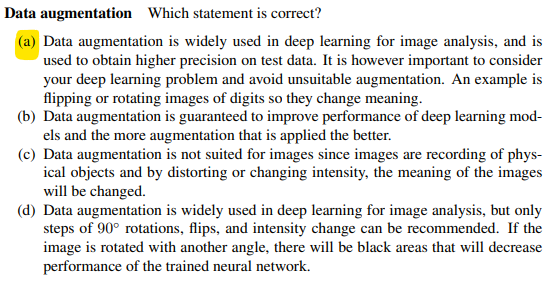

## Exam 2023

### Question 1) Gaussian filtering 

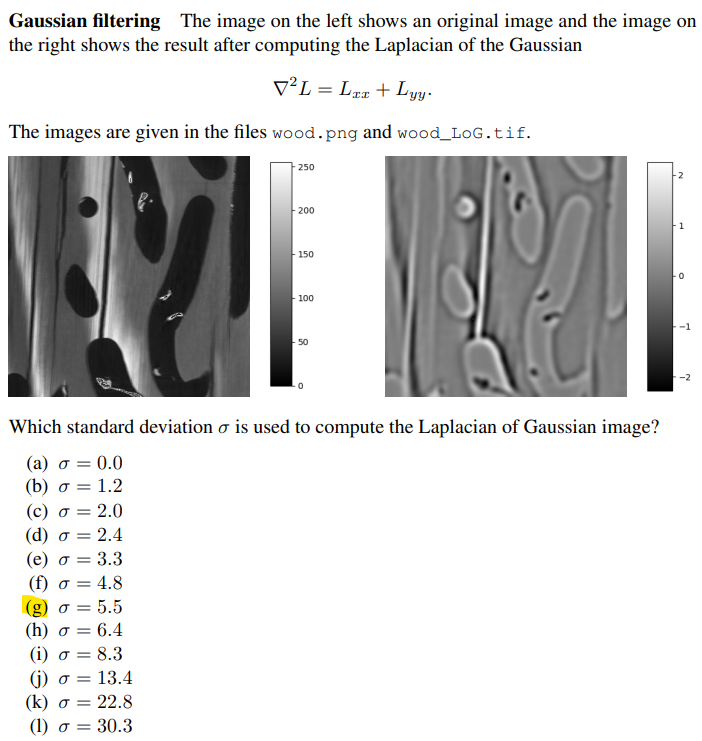

The important part in this exercise is to check what dtype the image are. Here it was a uint8. The image should always be converted to float before applying the gaussian filter. Below I multiply the image with 255 because I can see on the image above, that the image is not normalized. 


#### Mine

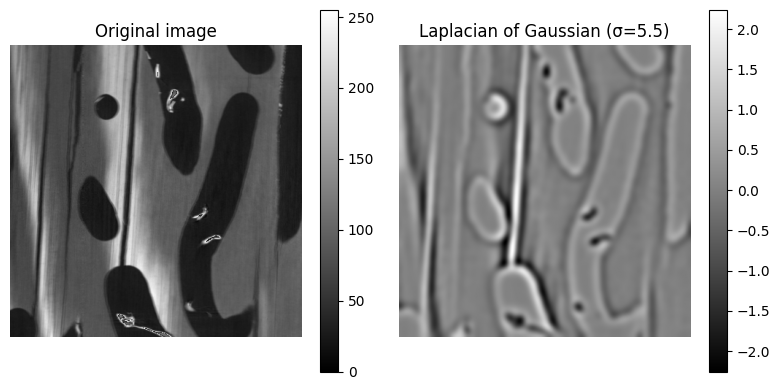

Are the two functions equal? True


In [188]:
image = get_gray_image_float('exam_data/exam2023/wood.png')*255
import numpy as np
import matplotlib.pyplot as plt
from skimage import io, img_as_float
from scipy.ndimage import gaussian_laplace

# Apply Laplacian of Gaussian (LoG)
# Choose a reasonable sigma value, e.g., 1.0 or 2.0 depending on texture
sigma = 5.5
gl = gaussian_laplace(image, sigma=sigma)
log_image = Laplacian(image, t=sigma**2, normalize=False)

# Plot side-by-side
plt.figure(figsize=(8, 4))

plt.subplot(1, 2, 1)
plt.title("Original image")
plt.imshow(image, cmap='gray')
plt.axis('off')
plt.colorbar()

plt.subplot(1, 2, 2)
plt.title(f"Laplacian of Gaussian (σ={sigma})")
plt.imshow(log_image, cmap='gray')
plt.axis('off')
plt.colorbar()
plt.tight_layout()
plt.show()

print(f'Are the two functions equal? {np.allclose(log_image, gl, atol=1e-2)}')


#### Solution

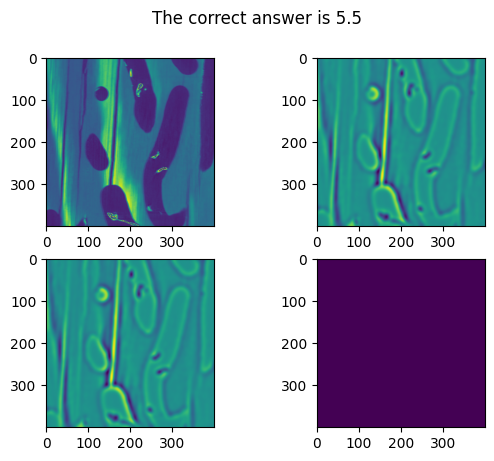

In [189]:
# Read images
# Read images
im = skimage.io.imread(f'exam_data/exam2023/wood.png').astype(np.float32)
L_gt = skimage.io.imread(f'exam_data/exam2023/wood_LoG.tif')

# Gaussian filters from exercise week 1
def gaussians(s):
    x = np.arange(-np.ceil(4*s), np.ceil(4*s)+1)
    x = np.reshape(x, (-1,1))
    g = 1/(s*np.sqrt(2*np.pi))*np.exp(-x**2/(2*s**2))
    dg = -x/(s**2)*g
    ddg = -x/(s**2)*dg - 1/(s**2)*g
    return g, dg, ddg

# Gaussian parameter sigma
s = 5.5
g, dg, ddg = gaussians(s)

# Second order Gaussian derivative in x and y directions
Lxx = scipy.ndimage.convolve(scipy.ndimage.convolve(im, ddg), g.T)
Lyy = scipy.ndimage.convolve(scipy.ndimage.convolve(im, ddg.T), g)

# Laplacian of Gaussian
L = Lxx + Lyy


fig, ax = plt.subplots(2,2)
ax[0][0].imshow(im)
ax[0][1].imshow(L)
ax[1][0].imshow(L_gt)
ax[1][1].imshow(L-L_gt)
fig.suptitle(f'The correct answer is {s}')
plt.show()

### Question 2) Mean bending

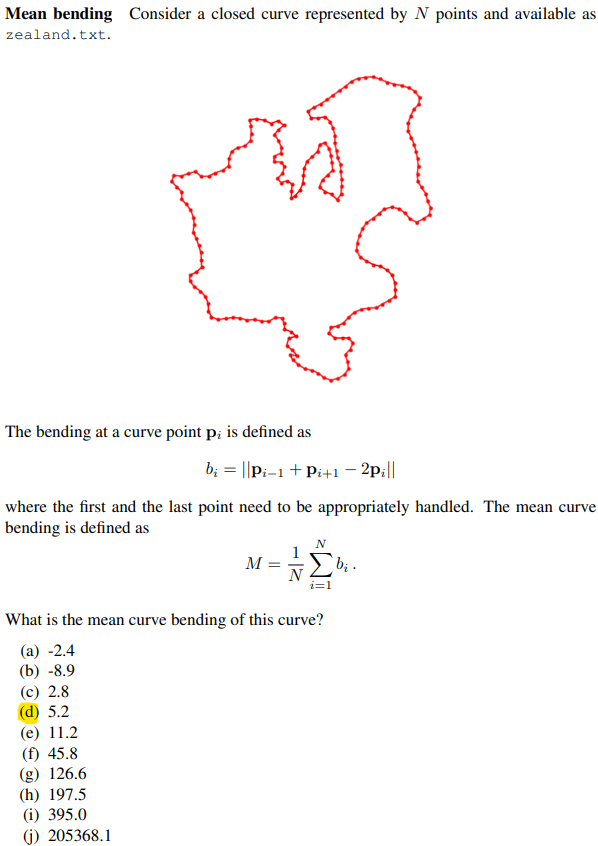

The smart ting here it to use:
```python
np.roll(bended, -1, axis=0)
```	


In [190]:
x = np.arange(10)[None, :]
x_1 = np.roll(x, -1, axis=1)
print(f'x:   {x}')
print(f'x_1: {x_1}')

x:   [[0 1 2 3 4 5 6 7 8 9]]
x_1: [[1 2 3 4 5 6 7 8 9 0]]


#### Mine

In [191]:
zealand_points = np.loadtxt('exam_data/exam2023/zealand.txt')
print(f'zealand_points[:3] \n {zealand_points[:3]}')
p_i_minus1 = np.vstack((zealand_points[-1], zealand_points[:-1]))
print(f'p_i_minus1[:3] \n {p_i_minus1[:3]}')
p_i_plus1 = np.vstack((zealand_points[1:], zealand_points[0]))
print(f'p_i_plus1[:3] \n {p_i_plus1[:3]}')

b = np.linalg.norm(p_i_minus1 + p_i_plus1 - 2 * zealand_points, axis=1)
print(np.mean(b))

zealand_points[:3] 
 [[ -21.8 -219.3]
 [ -33.3 -217.5]
 [ -28.8 -225.5]]
p_i_minus1[:3] 
 [[ -29.4 -210.5]
 [ -21.8 -219.3]
 [ -33.3 -217.5]]
p_i_plus1[:3] 
 [[ -33.3 -217.5]
 [ -28.8 -225.5]
 [ -20.  -232.8]]
5.206166801278886


#### Solution

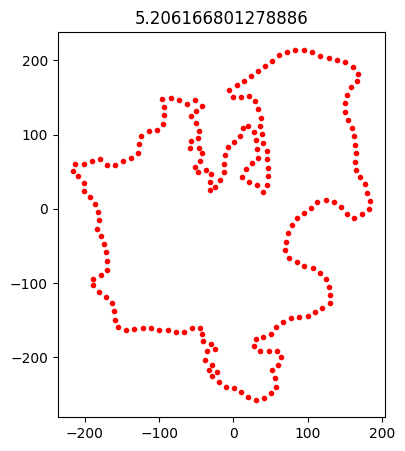

In [192]:
bended = np.loadtxt('exam_data/exam2023/zealand.txt')
fig, ax = plt.subplots(figsize=[10, 5])
ax.plot(bended[:, 0], bended[:, 1], 'r.')
ax.set_aspect('equal')
b = 2 * bended - np.roll(bended, 1, axis=0) - np.roll(bended, -1, axis=0)
b = np.sqrt((b**2).sum(axis=1)).mean()
ax.set_title(b)
plt.show()

### Question 3) Blob detection

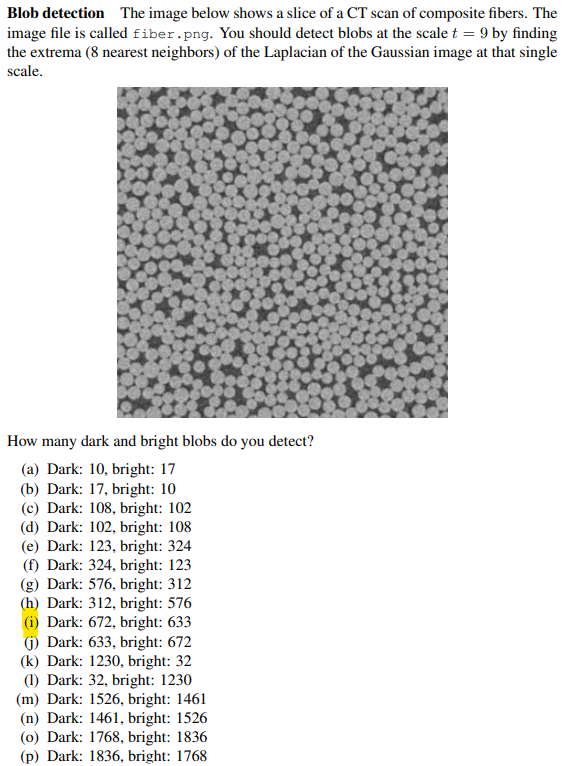

#### Mine

(np.float64(-0.5), np.float64(299.5), np.float64(299.5), np.float64(-0.5))

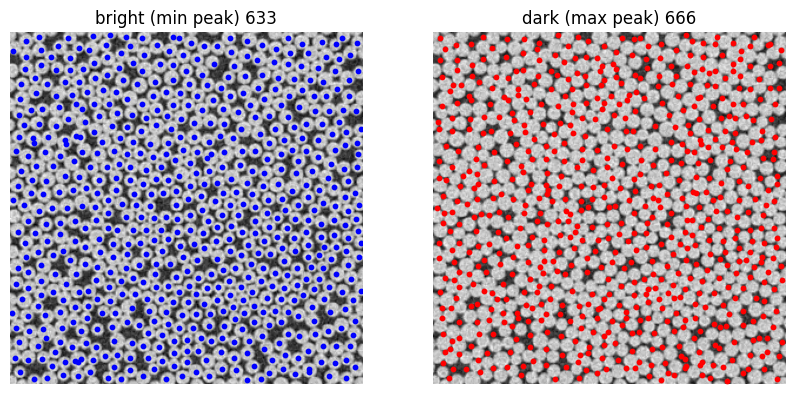

In [193]:
im = get_gray_image_float('exam_data/exam2023/fiber.png')

t = 9
L = Laplacian(im, t=t, normalize=True)
max_peak = peak_local_max(L, threshold_abs=0)
min_peak = peak_local_max(-L, threshold_abs=0)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title(f"bright (min peak) {len(min_peak)}")
plt.imshow(im, cmap='gray')
plt.scatter(min_peak[:, 1], min_peak[:, 0], s=10, c='blue', marker='o')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title(f"dark (max peak) {len(max_peak)}")
plt.imshow(im, cmap='gray')
plt.scatter(max_peak[:, 1], max_peak[:, 0], s=10, c='red', marker='o')
plt.axis('off')

#### Solution

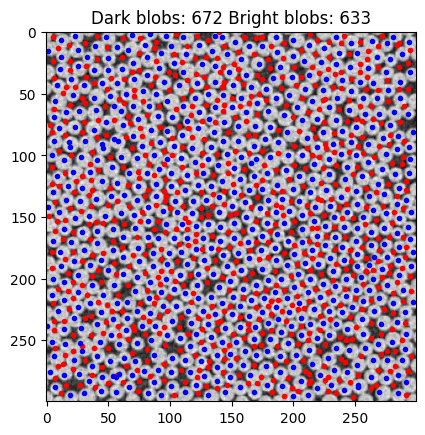

In [194]:
# QUESTION 3, Blob detection

# Compute Laplacian of Gaussians and find local maxima (dark blobs) and 
# minima (bright blobs)

im = skimage.io.imread('exam_data/exam2023/fiber.png').astype(float)

# Gaussian filters from exercise week 1
def gaussians(s):
    x = np.arange(-np.ceil(4*s), np.ceil(4*s)+1)
    x = np.reshape(x, (-1,1))
    g = 1/(s*np.sqrt(2*np.pi))*np.exp(-x**2/(2*s**2))
    dg = -x/(s**2)*g
    ddg = -x/(s**2)*dg - 1/(s**2)*g
    return g, dg, ddg

im_sp = []

s = 3
g, dg, ddg = gaussians(s)
Lxx = scipy.ndimage.convolve(scipy.ndimage.convolve(im, ddg), g.T)
Lyy = scipy.ndimage.convolve(scipy.ndimage.convolve(im, ddg.T), g)
L = Lxx + Lyy

# Own implementation of local maxima and minima
def get_local_extrema_2D(L):
    r,c = L.shape
    ct_im = np.zeros((r,c))
    for i in range(-1,2):
        for j in range(-1,2):
            to_row = r - 1 + i
            to_col = c - 1 + j
            ct_im[1:-1,1:-1] += (L[1:-1,1:-1] > L[1+i:to_row,1+j:to_col])
    coord_dark = np.where(ct_im[1:-1,1:-1]==8)
    coord_bright = np.where(ct_im[1:-1,1:-1]==0)
    return coord_dark, coord_bright

coord_dark, coord_bright = get_local_extrema_2D(L)

# Display (not needed for computing the solution)
fig, ax = plt.subplots()
ax.imshow(im, cmap='gray')
ax.plot(coord_dark[1], coord_dark[0], '.r')
ax.plot(coord_bright[1], coord_bright[0], '.b')
ax.set_title(f'Dark blobs: {len(coord_dark[0])} Bright blobs: {len(coord_bright[0])}')
plt.show()

### Question 4) Blob size
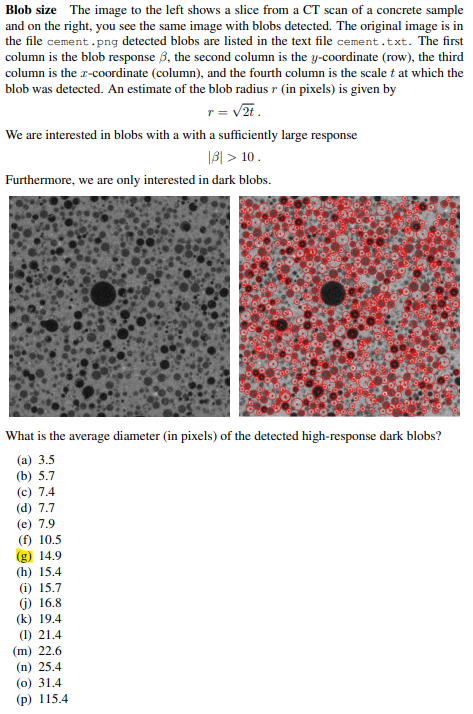

Here we use that we can calculate the diameter of the blob using the following formula:
$$
d = 2r = 2 \sqrt{2t}
$$
where $t$ is the scale.

#### Mine

average diameter of the holes: 14.9


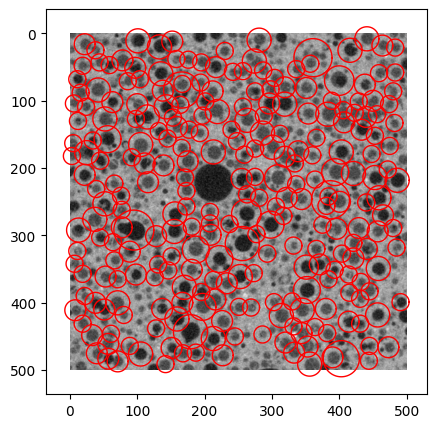

In [195]:
image = get_gray_image_float('exam_data/exam2023/cement.png')
blomberg_points = np.loadtxt('exam_data/exam2023/cement.txt')

b = blomberg_points[:, 0]
y = blomberg_points[:, 1]
x = blomberg_points[:, 2]
t = blomberg_points[:, 3]

# print(f'b[:3] \n {b[:3]}')
# print(f'y[:3] \n {y[:3]}')
# print(f'x[:3] \n {x[:3]}')
# print(f't[:3] \n {t[:3]}')
# print(f'abs b[:3] \n {np.abs(b[:3])}')

r = 2*np.sqrt(2*t)
b_idx = (np.abs(b) > 10) & (b > 0)
print(f'average diameter of the holes: {np.mean(r[b_idx]):.3g}')

theta = np.linspace(0, 2*np.pi, 100)
x = r[b_idx] * np.cos(theta)[:, None] + x[b_idx]
y = r[b_idx] * np.sin(theta)[:, None] + y[b_idx]
plt.figure(figsize=(5, 5))
plt.imshow(image, cmap='gray')
plt.plot(x, y, 'r-', lw=1)
plt.show()


#### Solution

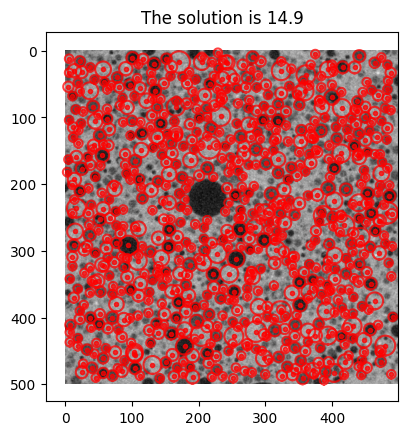

In [196]:
# The solution is to find all pixels where the blob response is larger 
# than 10, because we obtain positive response from dark blobs.

# Read in the image for displaying the result
im = skimage.io.imread(f'exam_data/exam2023/cement.png').astype(float)

# Read in the data
data_in = np.loadtxt(f'exam_data/exam2023/cement.txt')
blob_resp = data_in[:,0]
coords = data_in[:,1:3]
magnitude = data_in[:,3]

# Find data where blob response is larger than 10
idx = np.where(blob_resp > 10)
coords_1 = coords[idx]
magnitude_1 = magnitude[idx]

# Compute the average diameter as two times the radius
d = (2*np.sqrt(2*magnitude_1)).mean()

# Display (not needed for computing the solution)
n_theta = 100
rad = np.arange(0,2*np.pi, 2*np.pi/n_theta)
rad = np.append(rad, 2*np.pi)
cx = np.sin(rad)
cy = np.cos(rad)

fig, ax = plt.subplots()
ax.imshow(im, cmap='gray')
ax.plot(coords[:,1], coords[:,0], '.r', alpha=0.75)
for i, (c, m) in enumerate(zip(coords, magnitude)):
    ax.plot(cx*np.sqrt(2*m)+c[1], cy*np.sqrt(2*m)+c[0],'r', alpha=0.75)
ax.set_title(f'The solution is {d:0.1f}')
plt.show()

### Question 5)  Feature-based segmentation

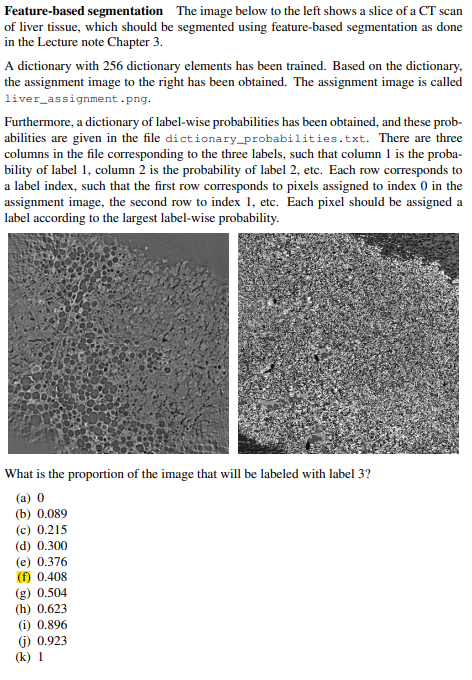

Here dict is a dictionary of size (256, 3). When we do ```python prob = dict[liver]``` then we get the probability of the label in the cluster, that is shape (400, 400, 3). We will then find the argmax, and take the mean over ```python maxi==2```, since this is label 3

#### Mine

In [197]:
liver = get_gray_image('exam_data/exam2023/liver_assignment.png')
dict = np.loadtxt('exam_data/exam2023/dictionary_probabilities.txt')
prob = dict[liver]

maxi = np.argmax(prob, axis=-1)
print(np.mean(maxi==2))

minimum value: 0, maximum value: 255
0.40969375


#### Solution

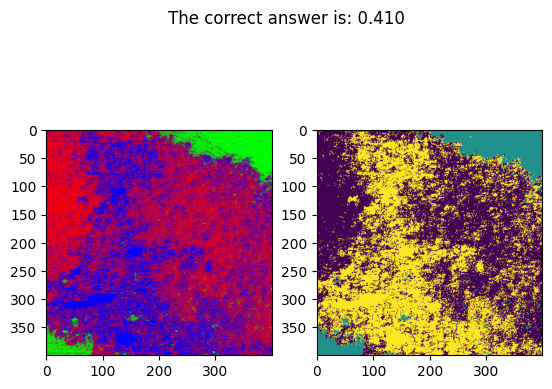

In [198]:
# QUESTION 5, Feature-based segmentation

# Per pixel probabilities are given, and the task is to compute the 
# probabilities for each pixel in the image, and count how many pixels 
# that has the label 3 relative to the total number of pixels in the image. 
# Note that there were a little typo in the list of answers that says 0.408.
# The correct answer is 0.410.

# Read in data
assignment_image = skimage.io.imread('exam_data/exam2023/liver_assignment.png')
prob_dict = np.loadtxt('exam_data/exam2023/dictionary_probabilities.txt')

# Build the probaility image for display and for computing the number of 
# pixels with label 3
prob_im = prob_dict[assignment_image]

# Segmentation image by finding the label with the heighest value in each pixel
seg_im = np.argmax(prob_im,axis=2)

# Display (not needed for computing the solution)
fig, ax = plt.subplots(1,2)
ax[0].imshow(prob_im)
ax[1].imshow(seg_im)
fig.suptitle(f'The correct answer is: {(seg_im==2).sum()/(assignment_image.size):0.3f}')
plt.show()


# #%% Simple solution with a for loop

# n_label = 0

# for i in np.ravel(assignment_image):
#     if np.argmax(prob_dict[i]) == 2:
#         n_label += 1
# print(f'The correct answer is: {n_label/assignment_image.size:0.3f}')

### Question 6) Gaussian features

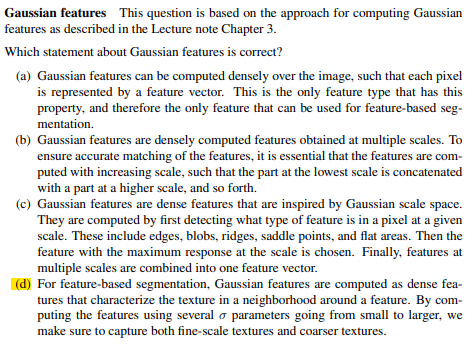

### Question 7) Point correspondance
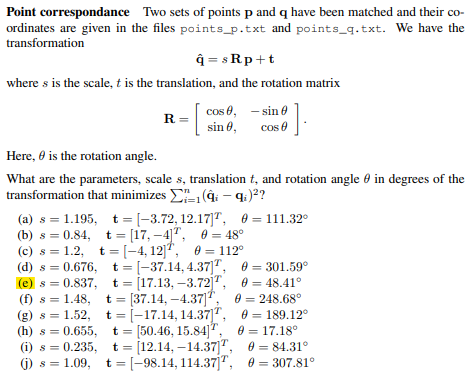

In [199]:
q = np.loadtxt('exam_data/exam2023/points_q.txt')
p = np.loadtxt('exam_data/exam2023/points_p.txt')
print(f'q.shape: {q.shape}')
print(f'q[:3] \n {q[:3]}')
print(f'p.shape: {p.shape}')
print(f'p[:3] \n {p[:3]}')
P = p.T
Q = q.T
R_T, t_T, s = Rotation_translation_scale(P, Q)

print(f'R \n {R_T.T}')
print(f't \n {t_T.T}')
print(f's \n {s}')  

q.shape: (100, 2)
q[:3] 
 [[ 2.99 46.51]
 [39.09 85.34]
 [29.9  79.2 ]]
p.shape: (100, 2)
p[:3] 
 [[31.87 53.12]
 [98.09 51.4 ]
 [84.39 55.41]]
R 
 [[ 0.66378083  0.74792714]
 [-0.74792714  0.66378083]]
t 
 [[17.12787409 -3.68695954]]
s 
 0.8362355885369753


#### Solution

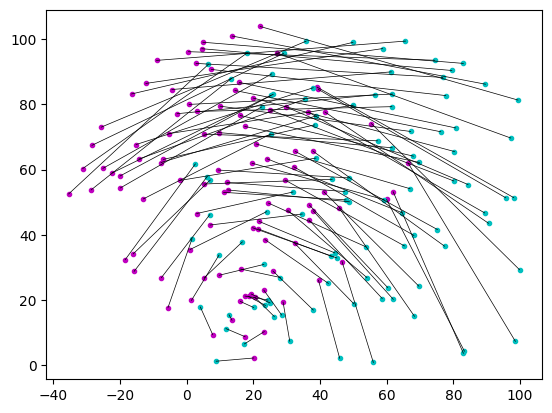

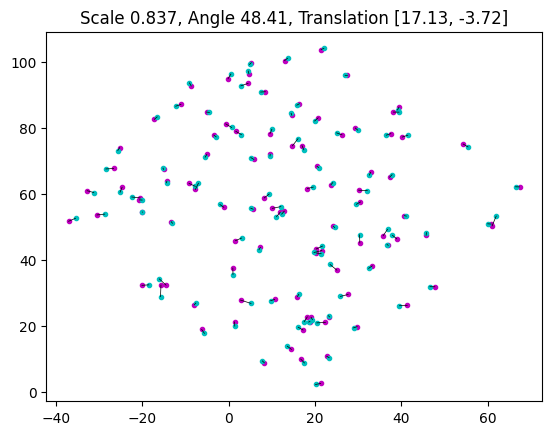

In [200]:
# Load the point sets
q = np.loadtxt('exam_data/exam2023/points_q.txt').T
p = np.loadtxt('exam_data/exam2023/points_p.txt').T

# Dispaly the points and their correspondance (not needed for computing the solution)
fig, ax = plt.subplots()
ax.plot(q[0], q[1], 'm.')
ax.plot(p[0], p[1], 'c.')
ax.plot(np.vstack((q[0], p[0])), np.vstack((q[1], p[1])), 'k-', linewidth=0.5)
plt.show()

# Compute mean points and distance to mean points for estimating the scale
mu_q = q.mean(axis=1, keepdims=True)
mu_p = p.mean(axis=1, keepdims=True)
d_q = np.sqrt(((q-mu_q)**2).sum(axis=0))
d_p = np.sqrt(((p-mu_p)**2).sum(axis=0))

# Estimated scale
s_est = d_q.sum()/d_p.sum()

# Covariance matrix
C = (q - mu_q)@(p - mu_p).T
U,S,V = np.linalg.svd(C)
R_est = U@V
theta_est = np.arccos(R_est[0,0])
angle_est = 360*theta_est/(2*np.pi)

# Transformation
t_est = (q - s_est*R_est@p).mean(axis=1, keepdims=True)

# Check result by plotting  (not needed for computing the solution)
q_est = s_est*R_est@p + t_est

fig, ax = plt.subplots()
ax.plot(q_est[0], q_est[1], 'm.')
ax.plot(q[0], q[1], 'c.')
ax.plot(np.vstack((q_est[0], q[0])), np.vstack((q_est[1], q[1])), 'k-', linewidth=0.5)
ax.set_title(f'Scale {s_est:0.3f}, Angle {angle_est:0.2f}, Translation [{t_est[0][0]:0.2f}, {t_est[1][0]:0.2f}]')
plt.show()

### Question 8) SIFT matching

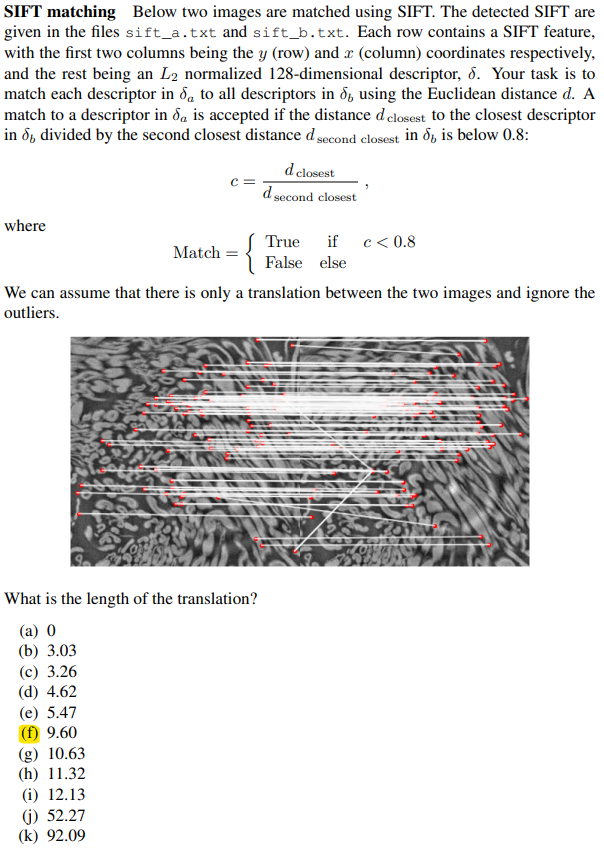

The point is to loop through all the sift features, then compute the distance and sort them. If the best one is less than 0.8 then it is saved

#### Mine

In [201]:
import cv2 as cv

sift_a = np.loadtxt('exam_data/exam2023/sift_a.txt')
sift_b = np.loadtxt('exam_data/exam2023/sift_b.txt')

print(f'sift_a.shape: {sift_a.shape}')
print(f'sift_b.shape: {sift_b.shape}')
y_a = sift_a[:, 0]
x_a = sift_a[:, 1]
d_a = sift_a[:, 2:]
y_b = sift_b[:, 0]
x_b = sift_b[:, 1]
d_b = sift_b[:, 2:]

d_a = np.asarray(d_a, np.float32)
d_b = np.asarray(d_b, np.float32)

print(f'y_a shape: {y_a.shape}')
print(f'x_a shape: {x_a.shape}')
print(f'd_a shape: {d_a.shape}')
print(f'y_b shape: {y_b.shape}')
print(f'x_b shape: {x_b.shape}')
print(f'd_b shape: {d_b.shape}')

lowe_threshold = 0.8

bf = cv.BFMatcher(cv.NORM_L2, crossCheck=False)

# knnMatch() finds the two closest matches (best and second-best) for each descriptor in des1 from des2.
matches = bf.knnMatch(d_a, d_b, k=2)        

# Apply Lowe's ratio test to select good matches
# m is the best match and n is the second best match to a given keypoint
good_matches = []
for m, n in matches:                            # m is the best match and n is the second best match
    if m.distance < lowe_threshold * n.distance:  # If the distance of the best match is less than the ratio times the distance of the second best match
        good_matches.append(m)   

pts_a = []  # from image A
pts_b = []  # from image B

for match in good_matches:
    idx_a = match.queryIdx  # index in d_a
    idx_b = match.trainIdx  # index in d_b

    # Use indices to get coordinates
    xa, ya = x_a[idx_a], y_a[idx_a]
    xb, yb = x_b[idx_b], y_b[idx_b]

    pts_a.append([xa, ya])
    pts_b.append([xb, yb])

pts_a = np.array(pts_a)
pts_b = np.array(pts_b)

# Translation vector: (dx, dy)
translations = pts_b - pts_a  # For each match
translation_vector = np.mean(translations, axis=0)
print(f'length of translation vector: {np.linalg.norm(translation_vector):.2f}')


sift_a.shape: (328, 130)
sift_b.shape: (293, 130)
y_a shape: (328,)
x_a shape: (328,)
d_a shape: (328, 128)
y_b shape: (293,)
x_b shape: (293,)
d_b shape: (293, 128)
length of translation vector: 9.60


#### Solution

In [202]:
# Load the SIFT features
sift_a = np.loadtxt('exam_data/exam2023/sift_a.txt')
sift_b = np.loadtxt('exam_data/exam2023/sift_b.txt')

coord_a = sift_a[:,:2]
coord_b = sift_b[:,:2]
desc_a = sift_a[:,2:]
desc_b = sift_b[:,2:]

# Create a list of translations
t = []

# Compute distance between one descriptor in set a and all in set b
for i, desc in enumerate(desc_a):
    d = np.linalg.norm((desc - desc_b), axis=1)
    idx = np.argsort(d)
    if d[idx[0]]/d[idx[1]] < 0.8:
        t.append(coord_a[i] - coord_b[idx[0]]) 

# Make array of translations and compute the mean
t = np.vstack(t)
tm = t.mean(axis=0)
print(f'The solution is {np.linalg.norm(tm):0.2f}')

The solution is 9.60


### Question 9) MRF prior
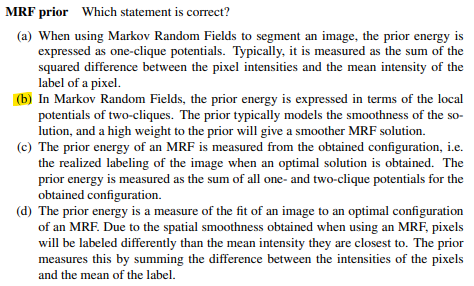

Option (a) is not correct, as it describes likelihood, not prior. 

Option (b) is correct.

Option (c) is not correct, the first sentence contributes no information, and the second sentence describes posterior.

Option (d) is not correct. The last sentence describes some type of likelihood.

### Question 10) Energy change


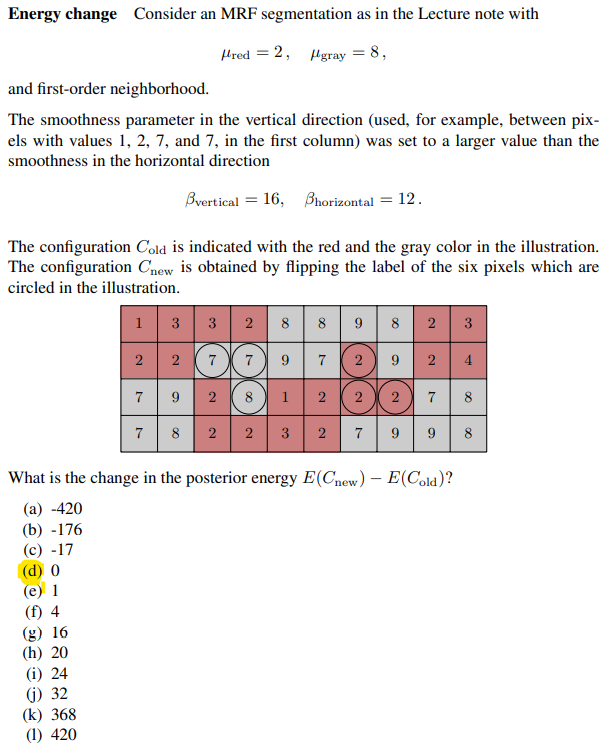

The point here is to remember that the energy is calculated as the sum of the potentials. Also we are calculating the energy for each pixel for the likelihood and for the neighboring pixels for the prior. 

#### Mine

In [203]:
image = np.array([[1, 3, 3, 2, 8, 8, 9, 8, 2, 3],
                   [2, 2, 7, 7, 9, 7, 2, 9, 2, 4],
                   [7, 9, 2, 8, 1, 2, 2, 2, 7, 8],
                   [7, 8, 2, 2, 3, 2, 7, 9, 9, 8]])

S_old = np.array([[1, 1, 1, 1, 0, 0, 0, 0, 1, 1],
                  [1, 1, 0, 0, 0, 0, 1, 0, 1, 1],
                  [0, 0, 1, 0, 1, 1, 1, 1, 0, 0],
                  [0, 0, 1, 1, 1, 1, 0, 0, 0, 0,]])

S_new = np.array([[1, 1, 1, 1, 0, 0, 0, 0, 1, 1],
                  [1, 1, 1, 1, 0, 0, 0, 0, 1, 1],
                  [0, 0, 1, 1, 1, 1, 0, 0, 0, 0],
                  [0, 0, 1, 1, 1, 1, 0, 0, 0, 0,]])


beta_vertically = 16
beta_horizontally = 12
mu_fi = {0: 8, 1: 2}

# check_vertically   = beta_vertically*np.sum(np.abs(np.diff(S_new, axis=0))) #Check if the pixel below is different from the pixel above
# check_horizontally = beta_horizontally*np.sum(np.abs(np.diff(S_new, axis=1)))
# E_new = check_vertically + check_horizontally

V1_old, V2_old = compute_V1_and_V2(image, S_old, mu_fi, beta_vertically, beta_horizontally)
V1_new, V2_new = compute_V1_and_V2(image, S_new, mu_fi, beta_vertically, beta_horizontally)
E_old = V1_old + V2_old
E_new = V1_new + V2_new

print(f'E difference: {E_new - E_old }')

The likelihood energy term V1 is: 23
The prior term V2 is: 368
The posterior energy term V1+V2 is: 391
The likelihood energy term V1 is: 215
The prior term V2 is: 192
The posterior energy term V1+V2 is: 407
E difference: 16


#### Solution


Below then the .sum() part calculates the likelihood energy and the 8*16 + 6*12 calculate the prior energy. We multiple 16 with 8 because we have 8 neighbors with a different label in the vertical direction.

In [204]:
vals = np.array([[7, 7, 8], [2, 2, 2]])
E_old = ((vals - np.array([[8], [2]]))**2).sum() + 8 * 16 + 6 * 12 
E_new = ((vals - np.array([[2], [8]]))**2).sum() + 2 * 12
change = E_new-E_old
print(change)


16


### Question 11) External force

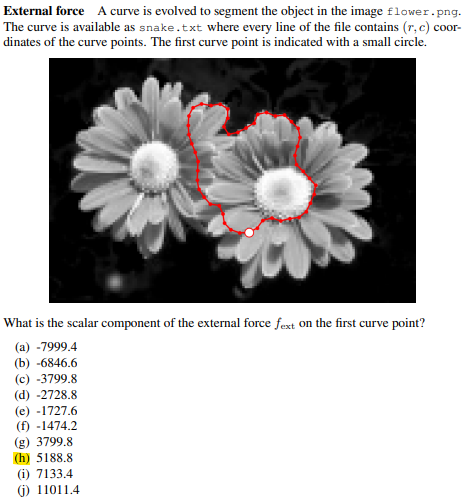

Remember that I in the calculation is only the pixel value for the image at the snakepoint and not the neighboring pixels. Also when we are indexing then insure that we convert to int. 

#### Mine

minimum value: 0, maximum value: 176
0
176


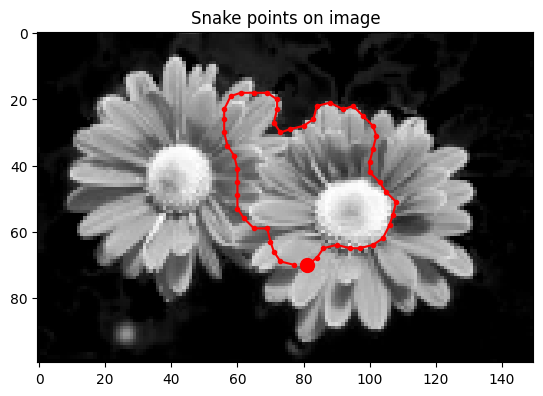

[5188.79473761]


In [205]:
image = get_gray_image('exam_data/exam2023/flower.png')
print(np.min(image))
print(np.max(image))
snake_points = np.loadtxt('exam_data/exam2023/snake.txt').astype(int)


plt.imshow(image, cmap='gray')
plt.plot(snake_points[:,1], snake_points[:,0], 'r.-')
plt.plot(snake_points[0,1], snake_points[0,0], 'ro', markersize=10)  # Start point
plt.title('Snake points on image')
plt.show()


f_ext = calculate_Fext(image, snake_points, neighborhood_size=0)

print(f_ext[0])

#### Solution


111.37083993660856 41.91874570840009


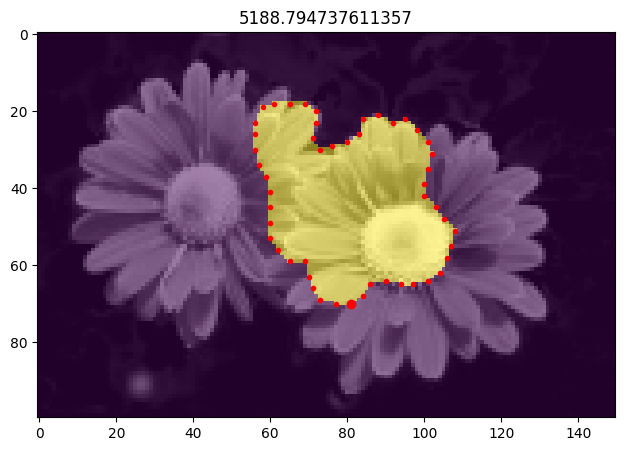

In [206]:
I = skimage.io.imread('exam_data/exam2023/flower.png')
snake = np.loadtxt('exam_data/exam2023/snake.txt').astype(int)

fig, ax = plt.subplots(figsize=[10, 5])
ax.imshow(I, cmap=plt.cm.gray)
ax.plot(snake[:, 1], snake[:, 0], 'r.')
ax.plot(snake[0, 1], snake[0, 0], 'ro')

mask = skimage.draw.polygon2mask(I.shape, snake)
ax.imshow(mask, alpha=0.5)
m_in = np.mean(I[mask])
m_out = np.mean(I[~mask])
print(m_in, m_out)
val = I[snake[0, 0], snake[0, 1]]
force = (m_in - m_out) * (2 * val - (m_in + m_out))
ax.set_title(force)
plt.show()

### Question 12) Beta effect

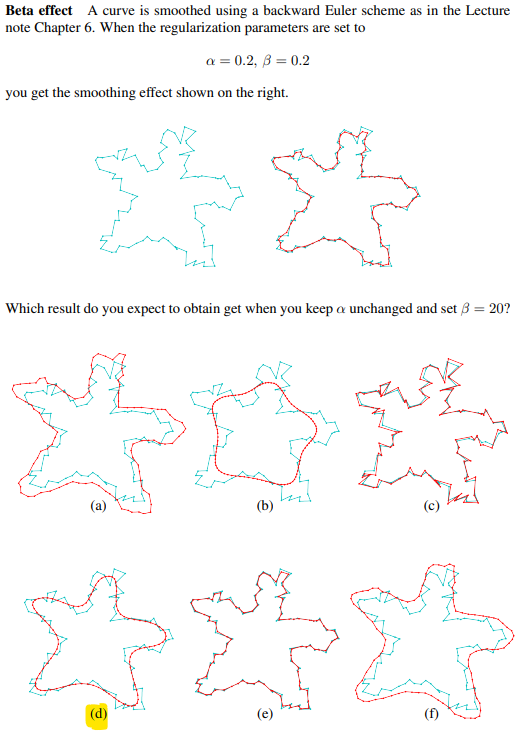

#### Mine

$\beta$ controls the curvature and I will therefore choose (d). It is $\alpha$ that makes it shrink or grow.

#### Solution

When increasing beta, the result should be smoother, eliminating options (c) and (e). Increasing beta should not make curve longer, eliminating options (a) and (f). Increasing beta should lead to even smoother curve, but without shrinkage, eliminating option (b). The correct answer is (d) where curve is smoother but not shrunk.

### Question 13) Surface cost

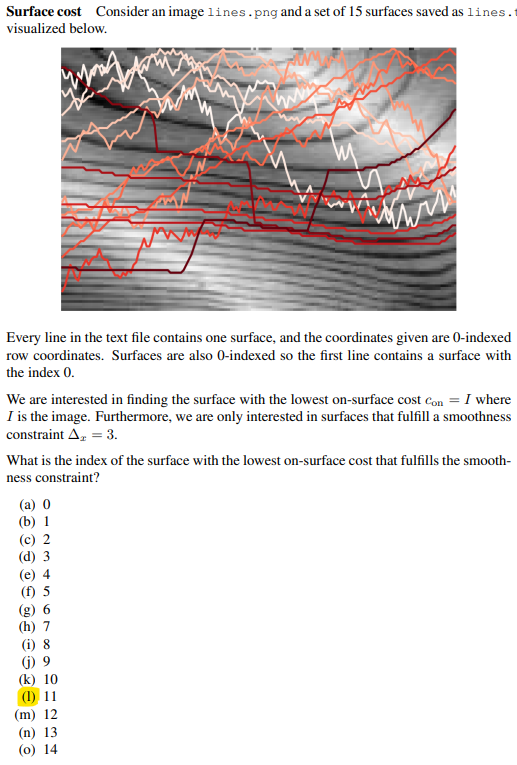

What is important here is to remember that we first have the row and then the column. Else it is about summing all the values for a line and check that the jump in $\Delta x$ is not above 3. Here ```np.any(delta_x > 3)``` 

I think the reason why we get a weird graph is because we have not normalized the cost and because we have not used the right cost function.

minimum value: 0, maximum value: 255
image.shape: (100, 150)
lines.shape: (15, 150)
[inf, inf, np.uint64(22866), np.uint64(25986), np.uint64(24710), inf, np.uint64(22164), np.uint64(20838), np.uint64(23149), inf, np.uint64(21637), np.uint64(22284), np.uint64(20849), inf, inf]
7


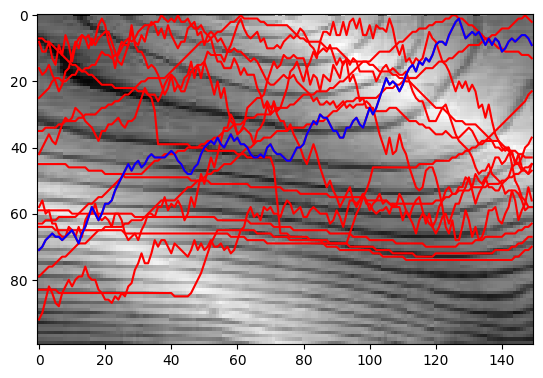

In [207]:
image = get_gray_image('exam_data/exam2023/lines.png')
lines = np.loadtxt('exam_data/exam2023/lines.txt').astype(int)

print(f'image.shape: {image.shape}')
print(f'lines.shape: {lines.shape}')


val_list = []
x = np.arange(image.shape[1]).astype(int)
for i in range(lines.shape[0]):
    val = image[lines[i], x].sum()
    delta_x = np.abs(np.diff(lines[i]))
    if np.any(delta_x > 3): 
        val_list.append(np.inf)
    else: 
        val_list.append(val)

print(val_list)
print(np.argmin(val_list))

plt.imshow(image, cmap='gray')
plt.plot(x, lines.T, 'r-')
plt.plot(x, lines[np.argmin(val_list)], 'b-')

#### Solution

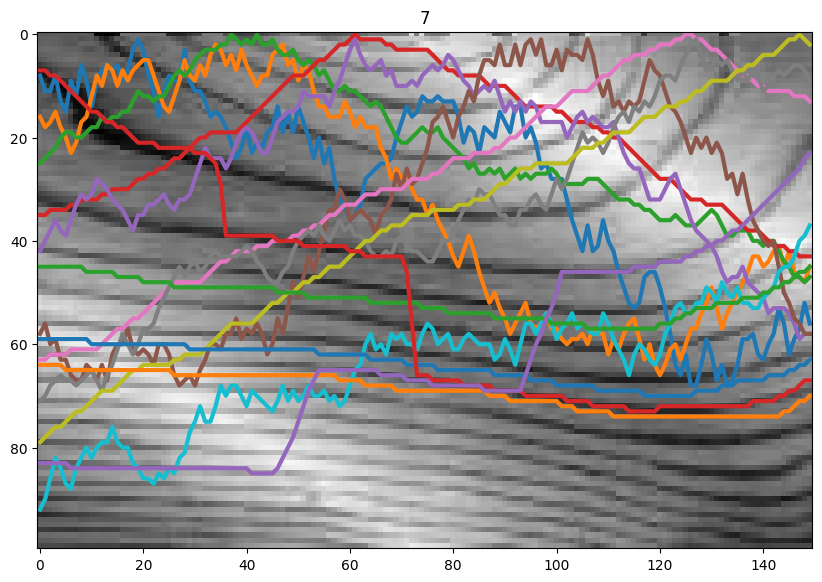

In [208]:
im = skimage.io.imread('exam_data/exam2023/lines.png')
max_delta = 3
lines = np.loadtxt('exam_data/exam2023/lines.txt').astype(int)

fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(im, cmap='gray')
ax.plot(lines.T, linewidth=3)

x = np.arange(im.shape[1])
costs = [im[lines[i, :], x].sum() for i in range(lines.shape[0])] 
costs = np.array(costs).astype(float)
difs = np.max(np.abs(lines[:, :-1] - lines[:, 1:]), axis=1)
idx = np.argmin(costs + (costs.max())*(difs > max_delta))
ax.set_title(idx)
plt.show()

### Question 14) Surface detection

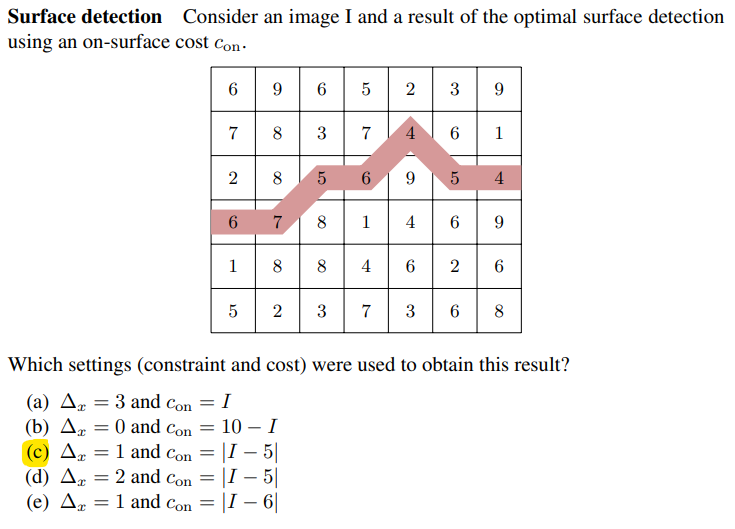

The point here is not to calculate it but look at the different columns and see if we select the right path.

#### Mine

I'm running the following code in week 7 because it needs another environment
```python
I = np.array([[6, 9, 6, 5, 2, 3, 9],
              [7, 8, 3, 7, 4, 6, 1],
              [2, 8, 5, 6, 9, 5, 4],
              [6, 7, 8, 1, 4, 6, 9],
              [1, 8, 8, 4, 6, 2, 6],
              [5, 2, 3, 7, 3, 6, 8]])
# To change the surface cost, modify the array passed to slgbuilder.GraphObject.
# For example, to use a different cost matrix (e.g., penalize high values more):
delta = 1
surface_cost = np.abs(I-5)  # Example: invert the cost so lower values become higher cost
layer = slgbuilder.GraphObject(surface_cost)

helper = slgbuilder.MaxflowBuilder()
helper.add_object(layer)
helper.add_layered_boundary_cost()
helper.add_layered_smoothness(delta=delta, wrap=False)

helper.solve()
segmentation = helper.what_segments(layer)
segmentation_line = segmentation.shape[0] - np.argmax(segmentation[::-1,:], axis=0) - 1

value_path = I[segmentation_line, np.arange(I.shape[1])]
value = np.sum(value_path)

print(f'The segmentation line is: {segmentation_line}')
print(f'The value path is given as: {value_path}')
print(f'The sum of the value path is given as: {value}')

plt.imshow(I, cmap='gray')
plt.plot(np.arange(len(segmentation_line)), segmentation_line)
plt.title(f'Optimal path for delta {delta} with value {value}')
```


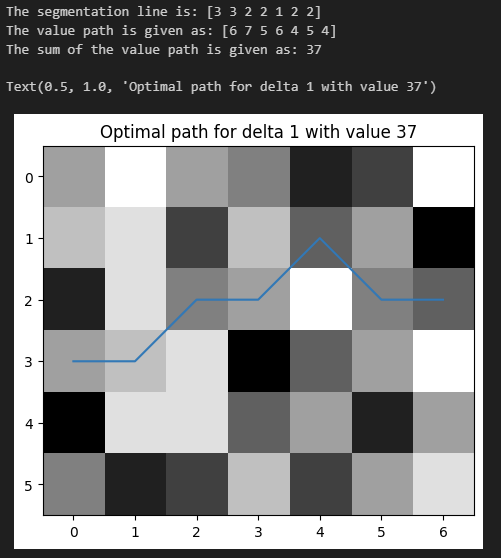

#### Solution

 Smoothness parameter DeltaX has to be larger or equal to 1, eliminating option (b). If parameters (a) were used, the surface would in the first colunm pass pixel with value 2, not 6. If parameters (d) were used, the surface would in the first column pass pixel with value 5, not 6. If parameters(e) were used, the surface would in the sixth column pass pixel with value 6, not 5. This leaves us with the correct solution (c).

### Question 15) Trained MLP

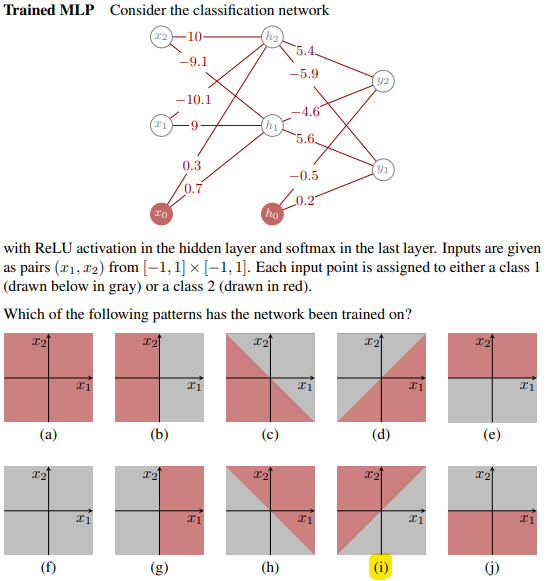

#### Mine

In [209]:
x1 = -1
x2 = -0

x0 = 1
ReLU = lambda x: np.maximum(0, x)
softmax = lambda x: np.exp(x) / np.sum(np.exp(x), axis=0)

h2 = ReLU( 10*x2 -10.1*x1 + 0.3*x0)
h1 = ReLU(-10.1*x2 + 9*x1 + 0.7*x0)
h0 = 1

# print(h1, h2)

y2 = 5.4*h2 - 4.6*h1 - 0.5*h0
y1 = -5.9*h2 + 5.6*h1 + 0.2*h0

out = np.array([y1, y2])
out = softmax(out)
print(out)


[1.84382044e-51 1.00000000e+00]


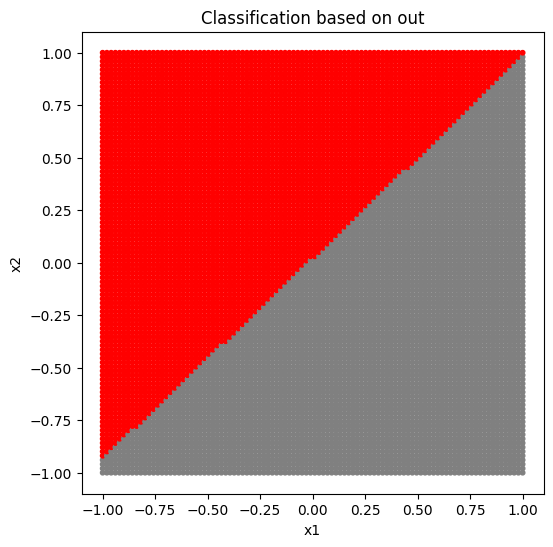

In [210]:
# Define the input space
x1 = np.linspace(-1, 1, 100)
x2 = np.linspace(-1, 1, 100)
x1_grid, x2_grid = np.meshgrid(x1, x2)

# Define constants and functions
x0 = 1
ReLU = lambda x: np.maximum(0, x)
softmax = lambda x: np.exp(x) / np.sum(np.exp(x), axis=0)

# Compute hidden layer activations
h2 = ReLU(10 * x2_grid - 10.1 * x1_grid + 0.3 * x0)
h1 = ReLU(-10.1 * x2_grid + 9 * x1_grid + 0.7 * x0)
h0 = 1

# Compute outputs
y2 = 5.4 * h2 - 4.6 * h1 - 0.5 * h0
y1 = -5.9 * h2 + 5.6 * h1 + 0.2 * h0

# Stack and apply softmax
out = np.array([y1, y2])
out = softmax(out)

# Determine colors
colors = np.where(out[1] > out[0], 'red', 'gray')

# Flatten the grid and colors for plotting
x1_flat = x1_grid.flatten()
x2_flat = x2_grid.flatten()
colors_flat = colors.flatten()

# Create the plot
plt.figure(figsize=(6, 6))  # Square plot
plt.scatter(x1_flat, x2_flat, c=colors_flat, s=10)
plt.xlabel('x1')
plt.ylabel('x2')
plt.title('Classification based on out')
plt.axis('square')
plt.show()


#### Solution

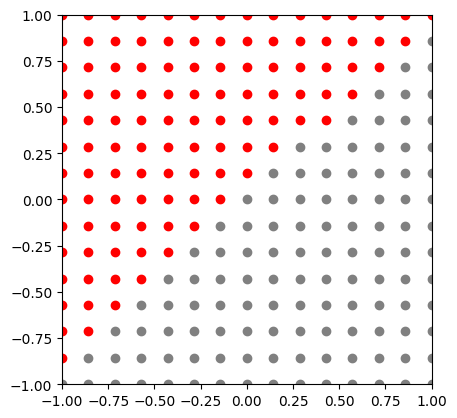

In [211]:
def predict(x1, x2):
    h2 = max(10 * x2 - 9.1 * x1 + 0.3, 0.0)
    h1 = max(-9.1 * x2 + 9 * x1 + 0.7, 0.0)
    y2 = 5.4 * h2 - 4.6 * h1 - 0.5
    y1 = -5.9 * h2 + 5.6 * h1 + 0.2    
    return((y2 > y1) + 1)

fig, ax = plt.subplots()
ax.set_xlim(-1, 1)
ax.set_ylim(-1, 1)
ax.set_aspect('equal')
for x1 in np.linspace(-1, 1, 15):
    for x2 in np.linspace(-1, 1, 15):
        label = predict(x1, x2)
        if label == 1:
            color = 'gray'
        else:
            color = 'red'
        ax.plot(x1, x2, 'o', color=color)


plt.show()

### Question 16) Cross entropy

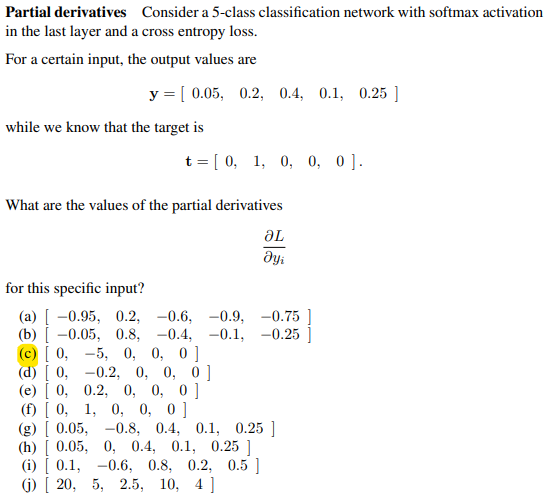

#### Mine

The cross entropy loss function is defined as:
$$
L =  -\sum_{i}  t_i \log({y}_i)
$$
where the target $t_i$ is one-hot encoded.

The softmax output function is defined as:
$$
y_i = \frac{e^{z_i}}{\sum_{j} e^{z_j}}
$$
where $z_i$ is the output of the last layer of the MLP.

We should find:
$$
\frac{\partial L}{\partial y_i} = \frac{\partial L}{\partial y_i} \left( -\sum_{i}  t_i \log({y}_i) \right) = -\frac{t_i}{y_i}
$$

In [212]:
y = np.array([[ 0.05, 0.2, 0.4, 0.1, 0.25 ]])
t = np.array([[ 0, 1, 0, 0, 0 ]])   

print(f'partial derivatives: {-t/y}')

partial derivatives: [[ 0. -5.  0.  0.  0.]]


#### Solution

We have L = - sum_i t_i * ln(y_i) and we need to compute dL/dY_i.
For a partial derivative in respect to y_i, only the summsyion term containing 
y_i is  relevant, that is the term - t_i * ln(y_i).
Factor t_i is a constant and  ln'(x)=1/abs(x). So, we have dL/dY_i= - t_i/y_i.   


In [213]:
y = np.array([0.05, 0.2, 0.4, 0.1, 0.25])
t = np.array([0, 1, 0, 0, 0])
print(-t/y)

[ 0. -5.  0.  0.  0.]


### Question 17) Momentum

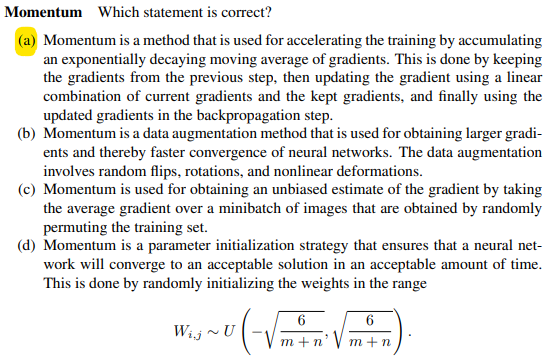

### Question 18) Classification training

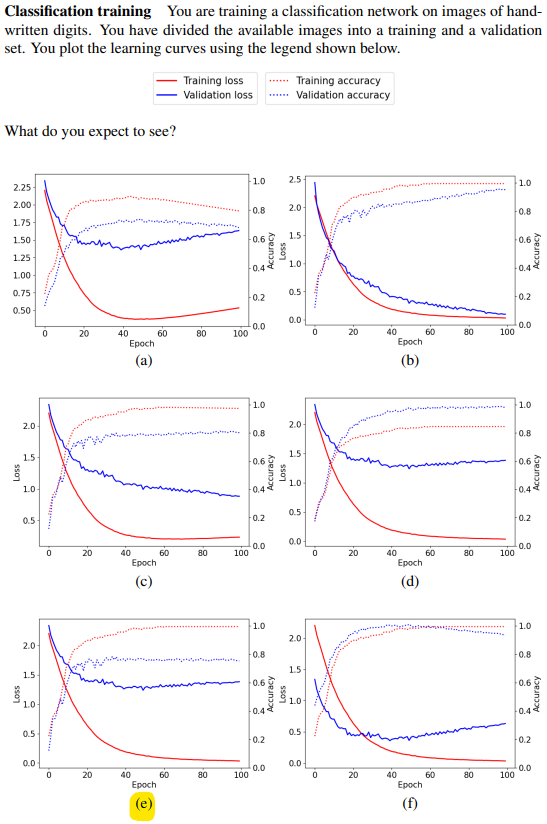

#### Mine

**a**) Training loss will not go up

**b**) I would expect a difference in the training and validation loss

**c**) Would not expect validation loss to go down when training loss goes up or stays the same

**d**) I would expect the training accuracy to be higher than the validation accuracy or at least the same

**e**) I would expect this 

**f**) I would not expect the validation loss to start lower than the training loss

#### Solution

We expect training loss to always be smaller than validation loss, and the 
training accuracy larger than validation accuracy -- that eliminates options (d)
and (f). We expect the training performance to keep improving so option (a) is 
eliminated. The validation performance may stop impoving or even get worse (due
to overfitting), and validation performance will not keep improving while 
training performance stagnates. This eliminates options (b) and (c). Left is the
correct solution (e) which shows slight overfitting after epoch 50.

### Question 19) Network bottleneck


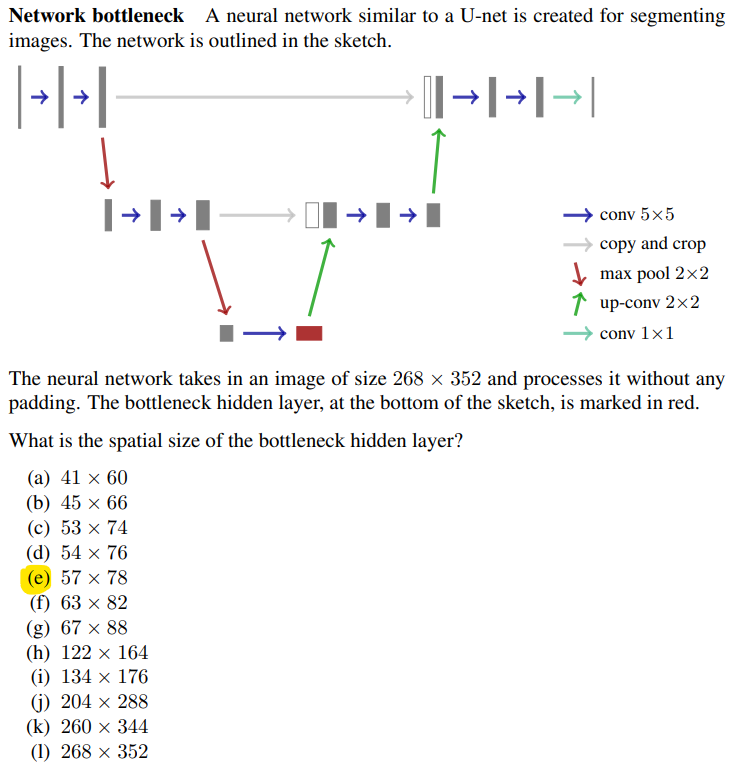

#### Mine

For a 5x5 convolutional layer we loss 2 pixels on each side, so 4 in total

In [214]:
input_image = np.array([268, 352])
layer1 = input_image - 4 - 4
layer2 = layer1/2 - 4 - 4
layer3 = layer2/2 - 4
print(f'The bottom layer is {layer3}')

The bottom layer is [57. 78.]


#### Solution

In [215]:
dims = np.array([268, 352])
down1 = (dims - 4 - 4)/2  # after two conv5x5 layers and moxpool2x2
down2 = (down1 - 4 - 4)/2 # after second block of two conv5x5 layers and moxpool2x2
bottom = (down2 - 4) # just one conv in the third block
print(bottom)

[57. 78.]


### Question 20) Data augmentation 

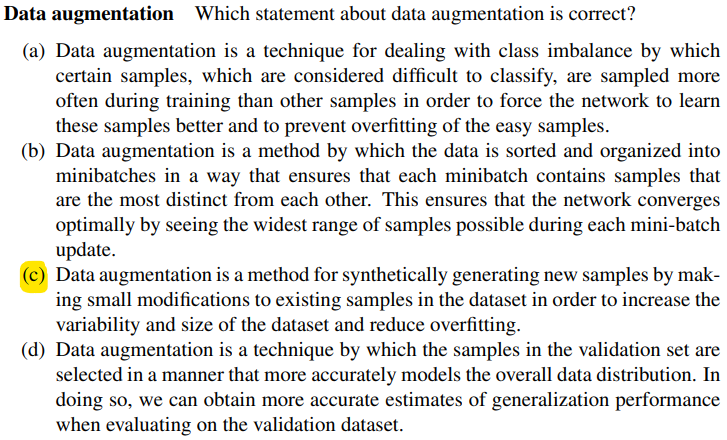

#### Solution

Data augmentation is not a technique for sampling or organizing data samples.
The correct answer is (c)

## Exam 2024

### Question 1) Filtering

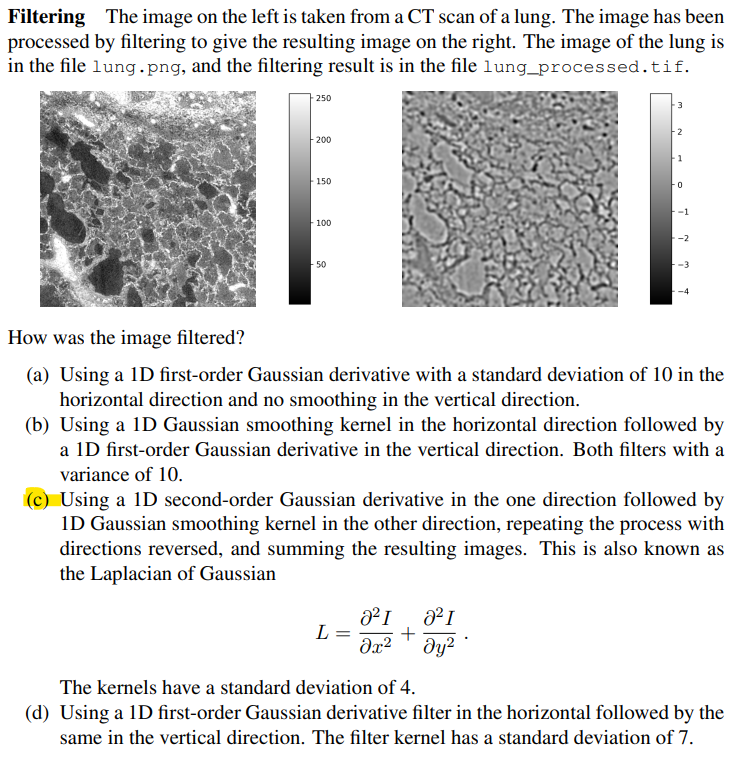

The point here is to make it for each image

#### Mine

(np.float64(-0.5), np.float64(499.5), np.float64(499.5), np.float64(-0.5))

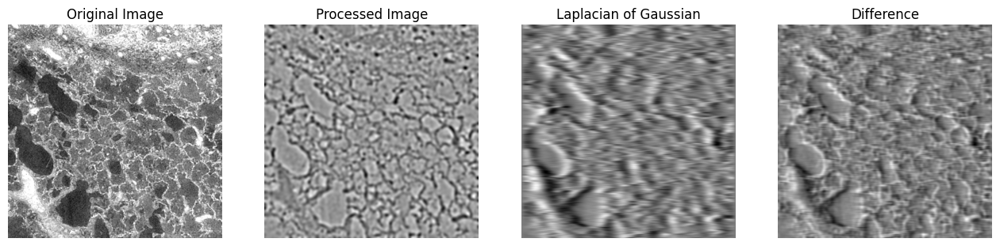

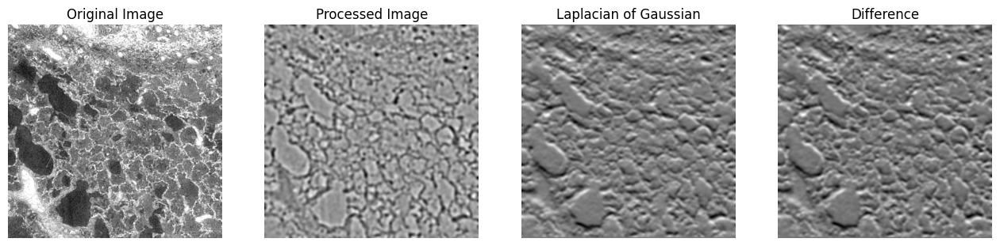

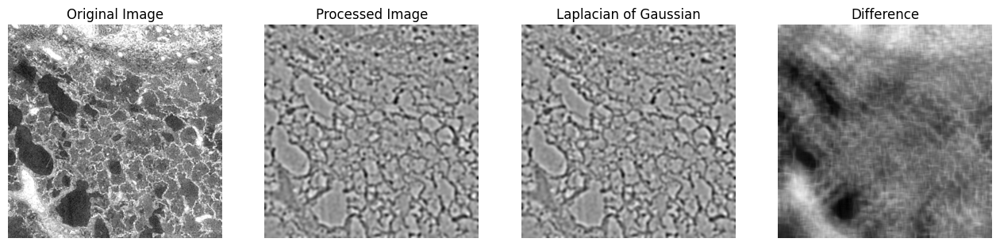

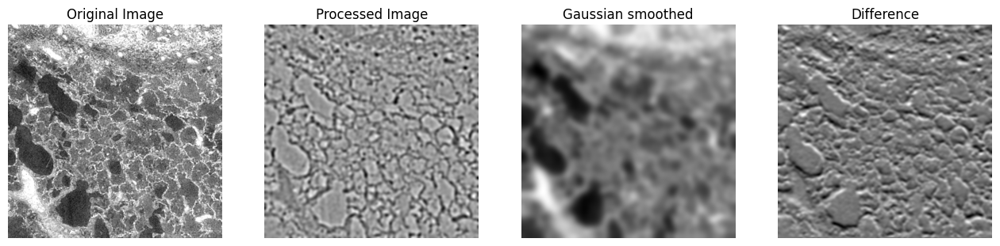

In [216]:
image = get_gray_image_float('exam_data\exam2024\lung\lung.png')*255
lung_processed = skimage.io.imread('exam_data/exam2024/lung/lung_processed.tif')


sigma = 10
g, dg, ddg, ddg =  get_gauss_derivatives(sigma**2, trunc=5)
dg = dg.reshape(1, -1) 
image1 = convolve(image, dg)
fig, ax = plt.subplots(1, 4, figsize=(16, 4))
ax[0].imshow(image, cmap='gray')
ax[0].set_title('Original Image')
ax[0].axis('off')
ax[1].imshow(lung_processed, cmap='gray')
ax[1].set_title('Processed Image')
ax[1].axis('off')
ax[2].imshow(image1, cmap='gray')
ax[2].set_title('Laplacian of Gaussian')
ax[2].axis('off')
ax[3].imshow(image1 - lung_processed, cmap='gray')
ax[3].set_title('Difference')
ax[3].axis('off')


t = 10
g, dg, ddg, ddg =  get_gauss_derivatives(t, trunc=5)
image2 = separable_filtering(image, g, dg)
fig, ax = plt.subplots(1, 4, figsize=(16, 4))
ax[0].imshow(image, cmap='gray')
ax[0].set_title('Original Image')
ax[0].axis('off')
ax[1].imshow(lung_processed, cmap='gray')
ax[1].set_title('Processed Image')
ax[1].axis('off')
ax[2].imshow(image2, cmap='gray')
ax[2].set_title('Laplacian of Gaussian')
ax[2].axis('off')
ax[3].imshow(image2 - lung_processed, cmap='gray')
ax[3].set_title('Difference')
ax[3].axis('off')

### Laplacian
L = Laplacian(image, t = 4**2, normalize=False)
fig, ax = plt.subplots(1, 4, figsize=(16, 4))
ax[0].imshow(image, cmap='gray')
ax[0].set_title('Original Image')
ax[0].axis('off')
ax[1].imshow(lung_processed, cmap='gray')
ax[1].set_title('Processed Image')
ax[1].axis('off')
ax[2].imshow(L, cmap='gray')
ax[2].set_title('Laplacian of Gaussian')
ax[2].axis('off')
ax[3].imshow(L - lung_processed, cmap='gray')
ax[3].set_title('Difference')
ax[3].axis('off')


t = 7**2
g, dg, ddg, ddg =  get_gauss_derivatives(t, trunc=5)
image4 = separable_filtering(image, g, g)
fig, ax = plt.subplots(1, 4, figsize=(16, 4))
ax[0].imshow(image, cmap='gray')
ax[0].set_title('Original Image')
ax[0].axis('off')
ax[1].imshow(lung_processed, cmap='gray')
ax[1].set_title('Processed Image')
ax[1].axis('off')
ax[2].imshow(image4, cmap='gray')
ax[2].set_title('Gaussian smoothed')
ax[2].axis('off')
ax[3].imshow(image2 - lung_processed, cmap='gray')
ax[3].set_title('Difference')
ax[3].axis('off')


#### Solution

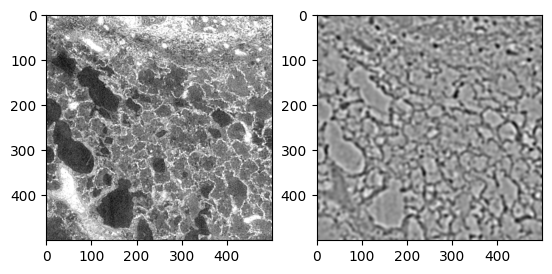

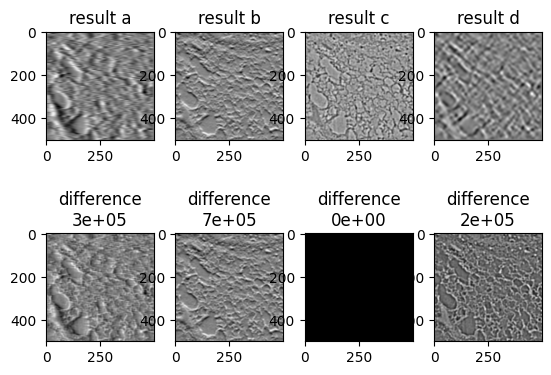

In [217]:
img = skimage.io.imread('exam_data/exam2024/lung/lung.png').astype(float)
img_ref = skimage.io.imread('exam_data/exam2024/lung/lung_processed.tif')

fig, ax = plt.subplots(1,2)
ax[0].imshow(img, cmap='gray')
ax[1].imshow(img_ref, cmap='gray')

def gaussians(s):
    x = np.arange(-np.ceil(4*s), np.ceil(4*s)+1)
    x = np.reshape(x, (-1,1))
    g = 1/(s*np.sqrt(2*np.pi))*np.exp(-x**2/(2*s**2))
    dg = -x/(s**2)*g
    ddg = -x/(s**2)*dg - 1/(s**2)*g
    return g, dg, ddg

img_options={}

g, dg, ddg = gaussians(10)
img_options['a'] = scipy.ndimage.convolve(img, dg.T)

g, dg, ddg = gaussians(np.sqrt(10))
img_options['b'] = scipy.ndimage.convolve(scipy.ndimage.convolve(img, g.T), dg)
g, dg, ddg = gaussians(4)
Lxx = scipy.ndimage.convolve(scipy.ndimage.convolve(img, ddg), g.T)
Lyy = scipy.ndimage.convolve(scipy.ndimage.convolve(img, ddg.T), g)
img_options['c'] = Lxx + Lyy

g, dg, ddg = gaussians(7)
img_options['d'] = scipy.ndimage.convolve(scipy.ndimage.convolve(img, dg), dg.T)

best_value = np.inf
fig, ax = plt.subplots(2, 4)
for i, a in zip(img_options, ax.T):
    a[0].imshow(img_options[i], cmap='gray')
    a[0].set_title('result ' + i)
    diff = img_options[i] - img_ref
    a[1].imshow(diff, cmap='gray')
    val = np.abs(diff).sum()
    a[1].set_title(f'difference\n{val:.0}')

### Question 2) Image smoothness

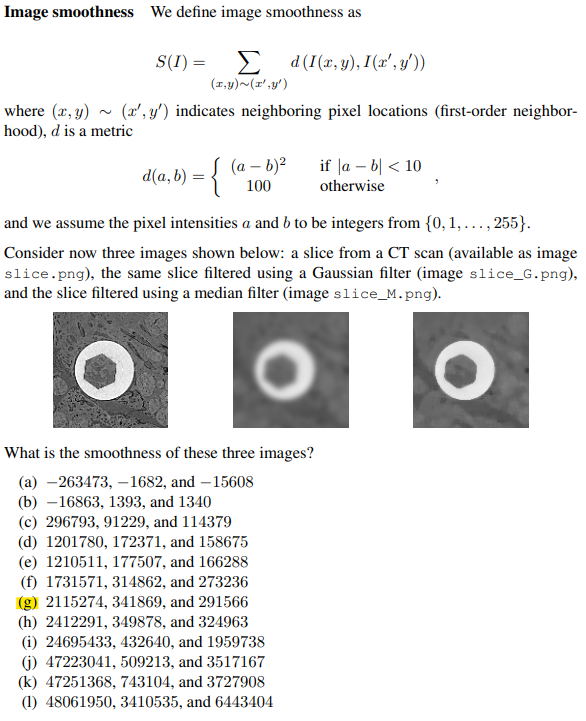

The point here is to ensure that it is an int datatype image

#### Mine

minimum value: 0, maximum value: 255
0 255
1052776 1062498
2115274


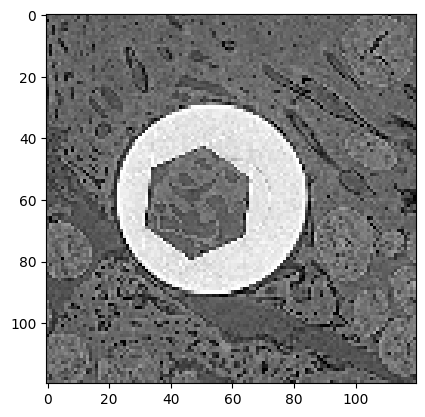

In [218]:
image = get_gray_image('exam_data/exam2024/slice/slice.png').astype(int)
print(np.min(image), np.max(image))
plt.imshow(image, cmap='gray')
dx = image[:, 1:] - image[:, :-1]  # shape: (H, W-1)
dy = image[1:, :] - image[:-1, :]  # shape: (H-1, W)
dx_result = np.where(np.abs(dx) < 10, dx**2, 100)
dy_result = np.where(np.abs(dy) < 10, dy**2, 100)
value = np.sum(dx_result) + np.sum(dy_result)
print(np.sum(dx_result), np.sum(dy_result))
print(value)

#### Solution

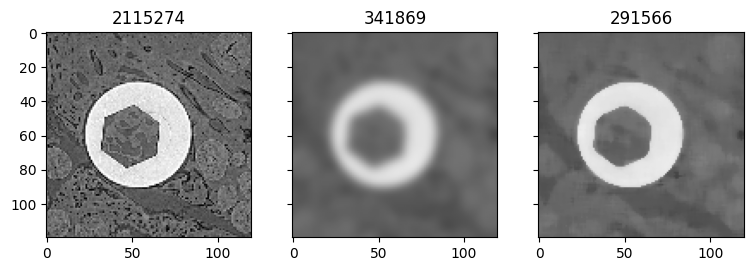

In [219]:
def smoothness(I):
    I = I.astype(int)  # important before subtracting
    h = np.minimum((I[:, 1:] - I[:, :-1])**2, 100).sum()
    v = np.minimum((I[1:, :] - I[:-1, :])**2, 100).sum()
    return h + v

images = [skimage.io.imread('exam_data/exam2024/' + 'slice/slice' + e + '.png') 
          for e in ['', '_G', '_M']]
fig, ax = plt.subplots(1, 3, figsize=(9, 3), sharex=True, sharey=True)
for a, I in zip(ax, images):
    a.imshow(I, cmap='gray', vmin=0, vmax=255)
    a.set_title(smoothness(I))
plt.show()

### Question 3) Blob detection

The point here is to remember that we need to normalize the Laplacian with the scale when we are finding blobs.

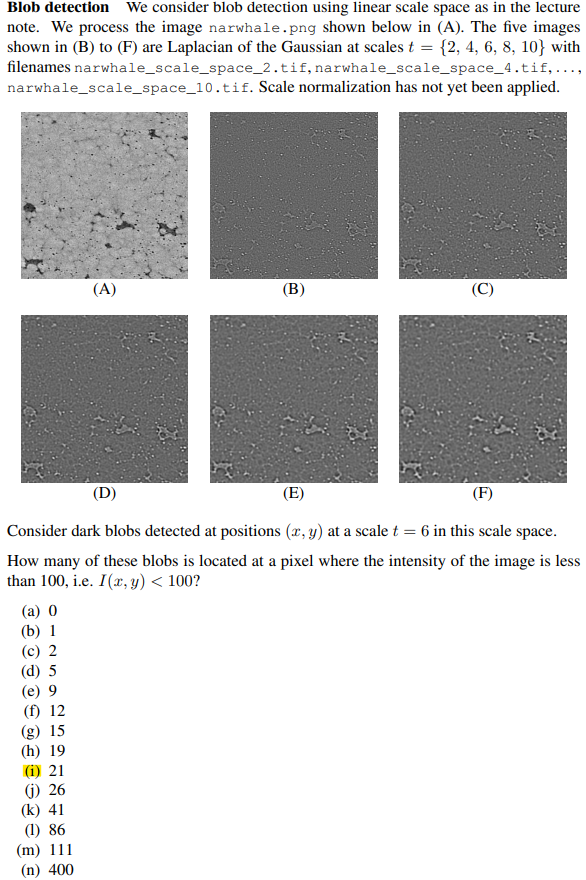

#### Mine

minimum value: 0, maximum value: 222
0 222
21


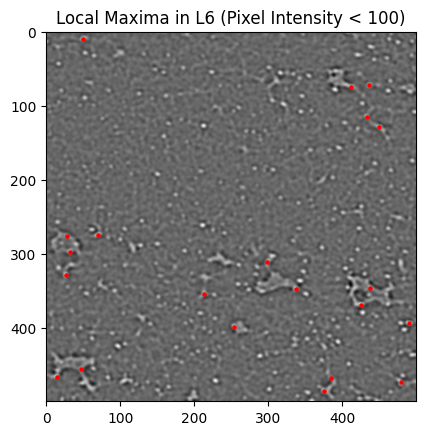

In [220]:
image = get_gray_image('exam_data/exam2024/narwhale/narwhale.png')
print(np.min(image), np.max(image))

L2 = skimage.io.imread('exam_data/exam2024/narwhale/narwhale_scale_space_2.tif')*2
L4 = skimage.io.imread('exam_data/exam2024/narwhale/narwhale_scale_space_4.tif')*4
L6 = skimage.io.imread('exam_data/exam2024/narwhale/narwhale_scale_space_6.tif')*6
L8 = skimage.io.imread('exam_data/exam2024/narwhale/narwhale_scale_space_8.tif')*8
L10 = skimage.io.imread('exam_data/exam2024/narwhale/narwhale_scale_space_10.tif')*10

L = np.stack([L2, L4, L6, L8, L10])

maxima = peak_local_max(L)
L6_maxima = maxima[maxima[:, 0] == 2]  # select rows where scale index is 2
L6_coords = L6_maxima[:, 1:]  # (row, col) positions of local maxima in L6
image_idx = image[L6_coords[:, 0], L6_coords[:, 1]] < 100
filtered_coords = L6_coords[image_idx]

print(np.sum(image_idx))

plt.imshow(L6, cmap='gray')
plt.scatter(filtered_coords[:, 1], filtered_coords[:, 0], c='r', s=5)
plt.title("Local Maxima in L6 (Pixel Intensity < 100)")
plt.show()

#### Solution

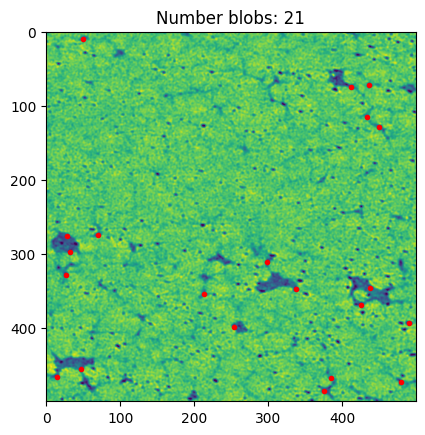

In [221]:
im = skimage.io.imread('exam_data/exam2024/'+ '/narwhale/narwhale.png')

# Multiply with t for scale normalization, only scales around 6 are of interest
sc_vol = [t * skimage.io.imread('exam_data/exam2024/' + 
                f'narwhale/narwhale_scale_space_{t}.tif') for t in [4, 6, 8]] 

ct_im = np.zeros(im.shape)
for t in [-1, 0, 1]:
    for j in [-1, 0, 1]:
        for k in [-1, 0, 1]:
            ct_im[1:-1, 1:-1] += (sc_vol[1][1:-1, 1:-1] > 
                    sc_vol[1+t][1+j:im.shape[0]-1+j, 1+k:im.shape[1]-1+k])

r, c = np.where((ct_im==26) & (im < 100))  
plt.imshow(im)
plt.plot(c, r, 'r.')
plt.title(f'Number blobs: {len(r)}')
plt.show()

### Question 4) Gaussian scale space

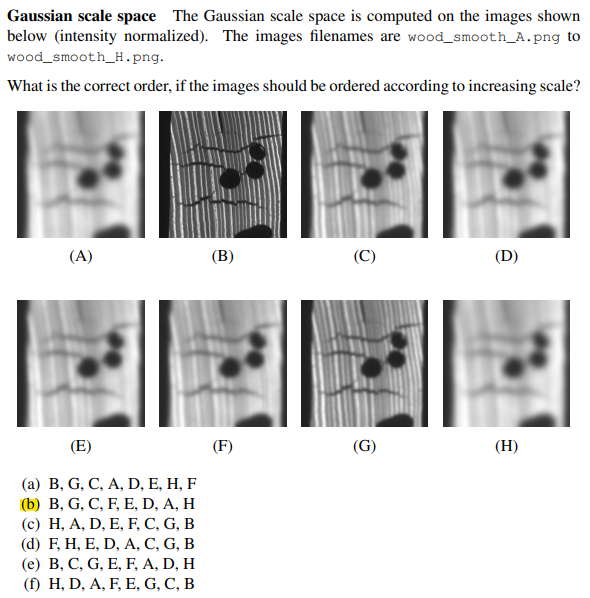

### Question 5) Feature clustering

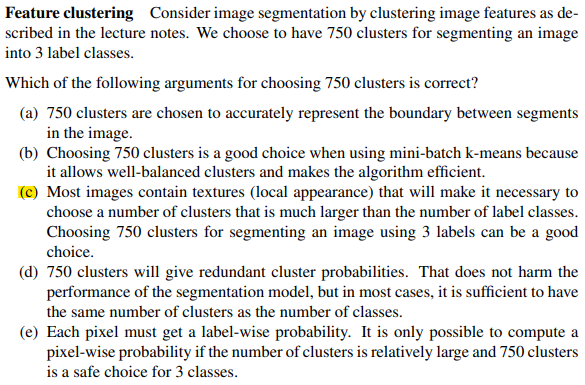

Number of dictionary elements (clusters) is typically much larger than number 
of labels because the local appearance (texture) may vary significantly. We can
conclude that (c) is the correct answer.

### Question 6) Feature-based segmentation

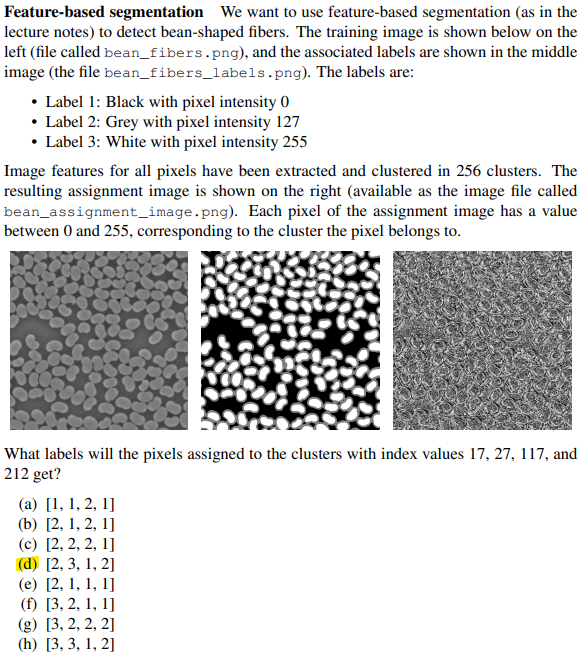

The point here is that for a pixel 17 to belong in a cluster then we take the cluster that occur most frequently.

#### Mine

minimum value: 0, maximum value: 255
minimum value: 0, maximum value: 255
Unique for mask 17: [127 255]
The number of 127 labels: 840
The number of 255 labels: 40

Unique for mask 27: [127 255]
The number of 127 labels: 61
The number of 255 labels: 401

Unique for mask 117: [0]

Unique for mask 212: [  0 127]
The number of 0 labels: 0
The number of 127 labels: 840


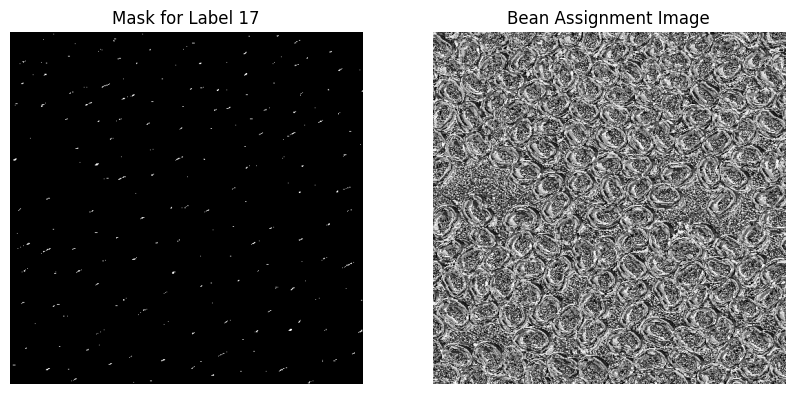

In [222]:
bean_assignment = get_gray_image('exam_data/exam2024/bean/bean_assignment_image.png').astype(int)
label = get_gray_image('exam_data/exam2024/bean/bean_fibers_labels.png')

# print(np.min(bean_assignment), np.max(bean_assignment))
# print(bean_assignment.dtype)

mask17 = bean_assignment == 17
mask27 = bean_assignment == 27
mask117 = bean_assignment == 117
mask212 = bean_assignment == 212

fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(mask17, cmap='gray')
ax[0].set_title('Mask for Label 17')
ax[0].axis('off')
ax[1].imshow(bean_assignment, cmap='gray')
ax[1].set_title('Bean Assignment Image')
ax[1].axis('off')

print('Unique for mask 17:', np.unique(label[mask17]))
print('The number of 127 labels:', np.sum(label[mask17] == 127))
print('The number of 255 labels:', np.sum(label[mask17] == 255))
print()
print('Unique for mask 27:', np.unique(label[mask27]))
print('The number of 127 labels:', np.sum(label[mask27] == 127))
print('The number of 255 labels:', np.sum(label[mask27] == 255))
print()
print('Unique for mask 117:', np.unique(label[mask117]))
print()
print('Unique for mask 212:', np.unique(label[mask212]))
print('The number of 0 labels:', np.sum(label[mask17] == 0))
print('The number of 127 labels:', np.sum(label[mask17] == 127))

#### Solution

Cluster 17: label 2
Cluster 27: label 3
Cluster 117: label 1
Cluster 212: label 2


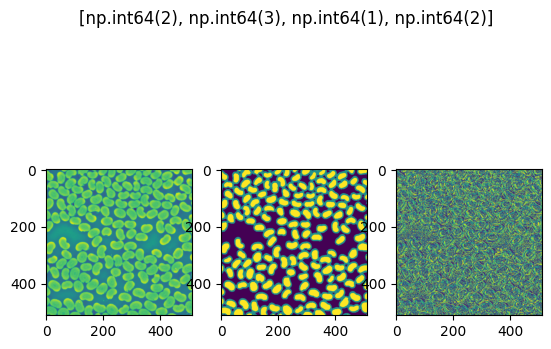

In [223]:
im = skimage.io.imread('exam_data/exam2024/' + 'bean/bean_fibers.png')
label_im = skimage.io.imread('exam_data/exam2024/' + 'bean/bean_fibers_labels.png')
assignment_im = skimage.io.imread('exam_data/exam2024/' + 'bean/bean_assignment_image.png')

fig, ax = plt.subplots(1,3)
ax[0].imshow(im)
ax[1].imshow(label_im)
ax[2].imshow(assignment_im)

answer = []
for a in [17, 27, 117, 212]:
    r, c = np.where(assignment_im==a)
    p = [(label_im[r, c] == l).sum() for l in [0, 127, 255]]
    idx = np.argmax(np.array(p))
    print(f'Cluster {a}: label {idx+1}')
    answer.append(idx+1)
fig.suptitle(answer)
plt.show()
    

### Question 7) Matching blobs 

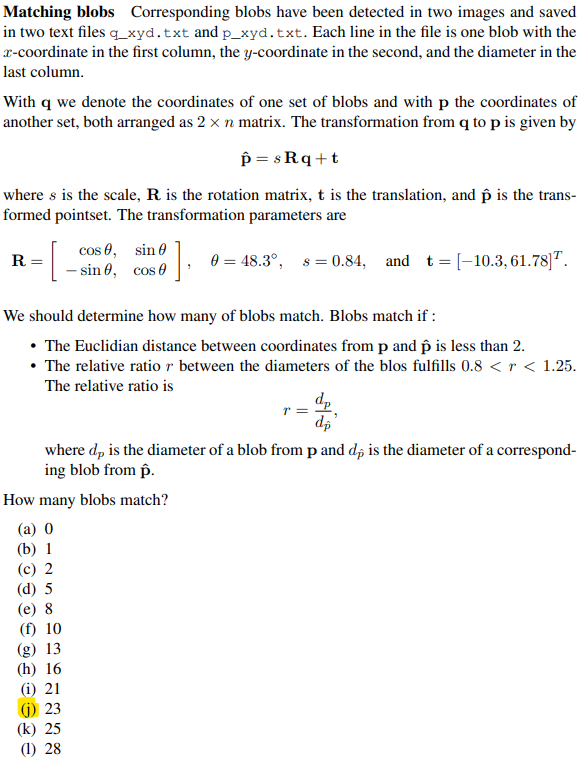

The point here is to remember that the size of the radius only depends on the scale.

#### Mine

In [224]:
q_xyd = np.loadtxt('exam_data/exam2024/blobs/q_xyd.txt')
p_xyd = np.loadtxt('exam_data/exam2024/blobs/p_xyd.txt')
print(p_xyd[:3])
print(q_xyd.shape)
q = q_xyd[:, :2]
q_d = q_xyd[:, -1][:,None]

p = p_xyd[:, :2]
p_d = p_xyd[:, -1][:,None]
print(q.shape, p.shape)
print(p[:3])


theta = np.deg2rad(48.3)
R = np.array([[np.cos(theta), np.sin(theta)], [-np.sin(theta), np.cos(theta)]])
s = 0.84
t = np.array([-10.3, 61.78])[:, None]

p_hat = (s*R @ q.T + t).T

p_d_hat = s*q_d

idx_p_norm = np.linalg.norm(p_hat - p, axis=1) < 2
ratio = p_d / p_d_hat
idx_ratio = (ratio > 0.8) & (ratio < 1.25)
idx = idx_p_norm[:, None] & idx_ratio
print(np.sum(idx))

[[87.213 71.649 10.2  ]
 [56.386 74.275 11.653]
 [37.11   8.564  8.128]]
(28, 3)
(28, 2) (28, 2)
[[87.213 71.649]
 [56.386 74.275]
 [37.11   8.564]]
23


#### Solution

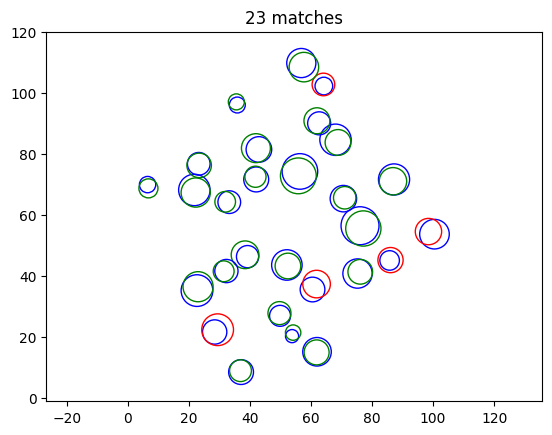

In [225]:
p_in = np.loadtxt('exam_data/exam2024/' + 'blobs/p_xyd.txt')
p = p_in[:, :2].T
dp = p_in[:, 2]
q_in = np.loadtxt('exam_data/exam2024/' + 'blobs/q_xyd.txt')
q = q_in[:, :2].T
dq = q_in[:, 2]

theta = 48.3 * np.pi/180
R = np.array([[np.cos(theta), np.sin(theta)], [-np.sin(theta), np.cos(theta)]])
s = 0.84
t = np.array([[-10.3, 61.78]]).T
phat = s * R @ q + t
dphat = s * dq  # scaling the radius of the transformed blobs

distance = np.sqrt(((p - phat) ** 2).sum(axis=0))
r = dp/dphat
match = (distance < 2) & (0.8 < r) & (r < 1.25)

fig, ax = plt.subplots()
colors = {True: 'g', False: 'r'}
for i in range(len(match)):
    ax.add_patch(plt.Circle([p[0, i], p[1, i]], dp[i]/2, color='b', fill=False))
    ax.add_patch(plt.Circle([phat[0, i], phat[1, i]], dphat[i]/2, 
                            color = colors[match[i]], fill=False))
ax.set_xlim((0, 120))
ax.set_ylim((0, 120))
ax.axis('equal')
ax.set_title(f'{match.sum()} matches')
plt.show()

### Question 8) SIFT 

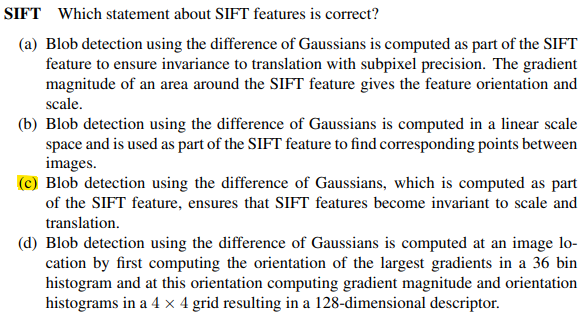

Blobs are detected at a certain location and a certain scale. All other computation
is done in respect to this location and the scale, making SIFT features invariant
to translation and to scale. Blob detection is not used for subpixel precision, 
finding correspondence or computing the SIFT descriptor.

### Question 9) Segmentation energy

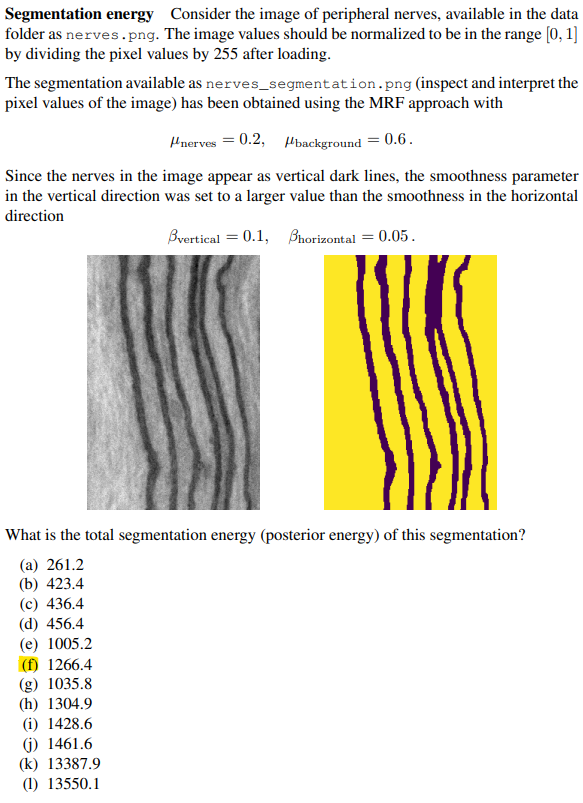

#### Mine

0.0 1.0
float64
0 1
int64
[0 1]
The likelihood energy term V1 is: 1005.1748096885813
The prior term V2 is: 261.20000000000005
The posterior energy term V1+V2 is: 1266.3748096885813


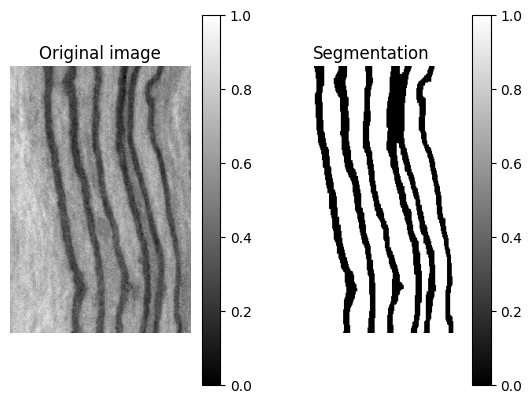

In [226]:
image = get_gray_image_float('exam_data/exam2024/nerves/nerves.png')
print(np.min(image), np.max(image))
print(image.dtype)

segmentation = get_gray_image_float('exam_data/exam2024/nerves/nerves_segmentation.png').astype(int)
print(np.min(segmentation), np.max(segmentation))
print(segmentation.dtype)
print(np.unique(segmentation))

plt.subplot(1, 2, 1)
plt.title("Original image")
plt.imshow(image, cmap='gray')
plt.axis('off')
plt.colorbar()
plt.subplot(1, 2, 2)
plt.title("Segmentation")
plt.imshow(segmentation, cmap='gray')
plt.axis('off')
plt.colorbar()

mu = {0: 0.2, 1:0.6}
b_vertical = 0.1
b_horizontal = 0.05

V1, V2 = compute_V1_and_V2(image, segmentation, mu, b_vertical, b_horizontal)


#### Solution

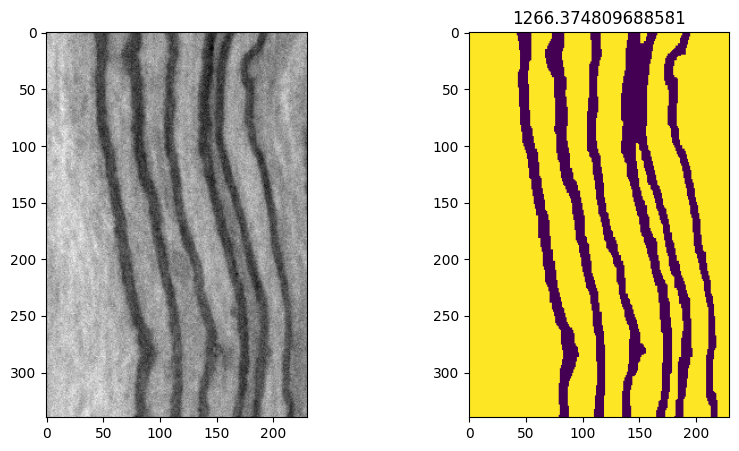

In [227]:
I = skimage.io.imread('exam_data/exam2024/' + 'nerves/nerves.png').astype(float)/255
S = skimage.io.imread('exam_data/exam2024/' + 'nerves/nerves_segmentation.png')>0

prior = ((I[S] - 0.6)**2).sum() + ((I[~S] - 0.2)**2).sum()
posterior = 0.1 * (S[1:] != S[:-1]).sum() + 0.05 * (S[:, 1:] != S[:, :-1]).sum()

fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(I, vmin=0, vmax=1, cmap=plt.cm.gray)
ax[1].imshow(S)
ax[1].set_title(prior + posterior)
plt.show()

# #%% ...IF SOMEBODY DECIDES TO USE MAXFLOW
# import maxflow
# g = maxflow.Graph[float]()
# nodeids = g.add_grid_nodes(I.shape)
# o = np.ones(shape = nodeids.shape)
# g.add_edges(nodeids[:-1, :], nodeids[1:, :], 0.1 * o[:-1, :], 0.1 * o[:-1, :])
# g.add_edges(nodeids[:, :-1], nodeids[:, 1:], 0.05 * o[:, :-1], 0.05 * o[:, :-1])
# g.add_grid_tedges(nodeids, (I - 0.6)**2, (I - 0.2)**2)
# flow = g.maxflow()
# print(f'Flow: {flow}, difference: {((g.get_grid_segments(nodeids) > 0)!=S ).sum()}')

### Question 10) Parameter range

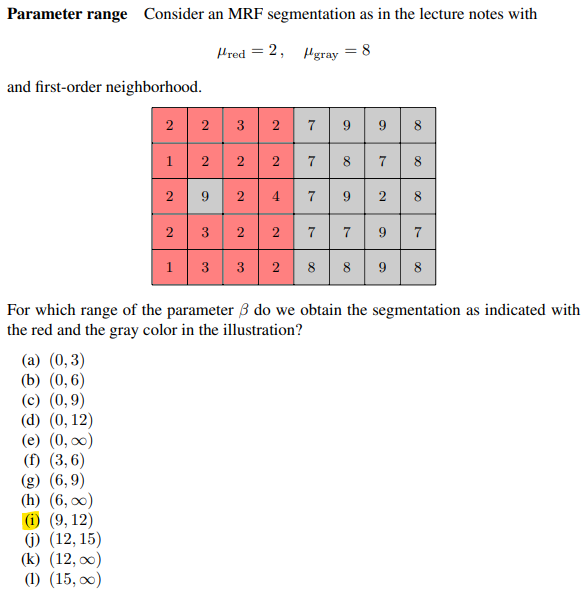

#### Mine

In [228]:
beta = 12
E_old = (9 - 8)**2 + beta*4
E_new = (9 - 2)**2

print(E_old, E_new)

image = np.array([
    [2, 3, 3, 2, 7, 9, 9, 8],
    [1, 2, 2, 2, 7, 8, 7, 8],
    [2, 9, 2, 4, 7, 9, 2, 8],
    [2, 3, 2, 2, 7, 7, 9, 7],
    [1, 3, 3, 2, 8, 8, 9, 8]
])
mu = [2, 8]
beta = 10
segmentation = markov_segmentation(image, mu, beta)
print(segmentation)

49 49
[[1 1 1 1 0 0 0 0]
 [1 1 1 1 0 0 0 0]
 [1 0 1 1 0 0 0 0]
 [1 1 1 1 0 0 0 0]
 [1 1 1 1 0 0 0 0]]


#### Solution

In [229]:
# QUESTION 10, Parameter range
# It is enough to consider two pixels, one with value 9 in the left part of the
# image and one with value 2 in the right part of the image.
red = 2
gray = 8
# Beta needs to be large enough that pixel with value 2 in the left part is gray
range_start = ((2 - gray)**2 - (2 - red)**2)/4
# Beta needs to be small enough that pixel with value 9 in the right part is red
range_end = ((9 - red)**2 - (9 - gray)**2)/4
print(f'{range_start, range_end}')

(9.0, 12.0)


### Question 11) Energy evolution 

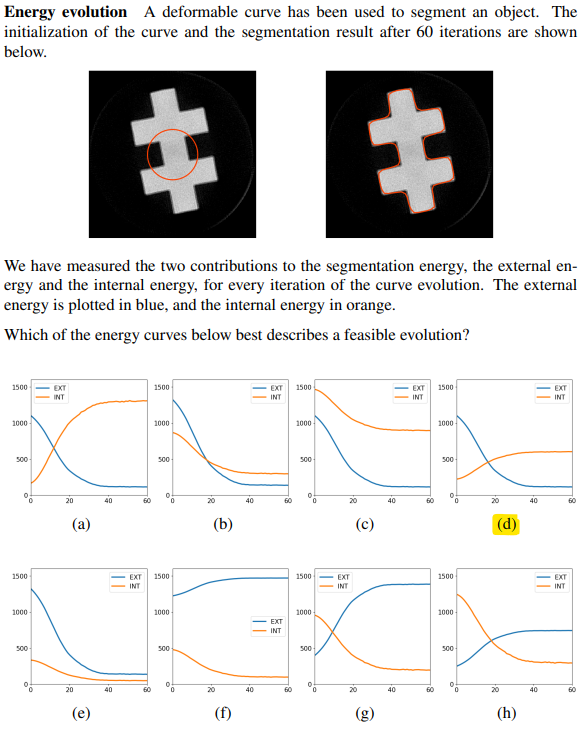

The external energy needs to be decreasing (this is because we start from a 
bad separation into bright and dark and we end with a good separation). The
internal energy needs to be increasing (this is because we start with a small 
circle and we end with larger convoluted shape.) This leaves us with options (a)
and (d). But the overall energy needs to be decreasing, so we choose (d) as 
correct answer.

### Question 12)

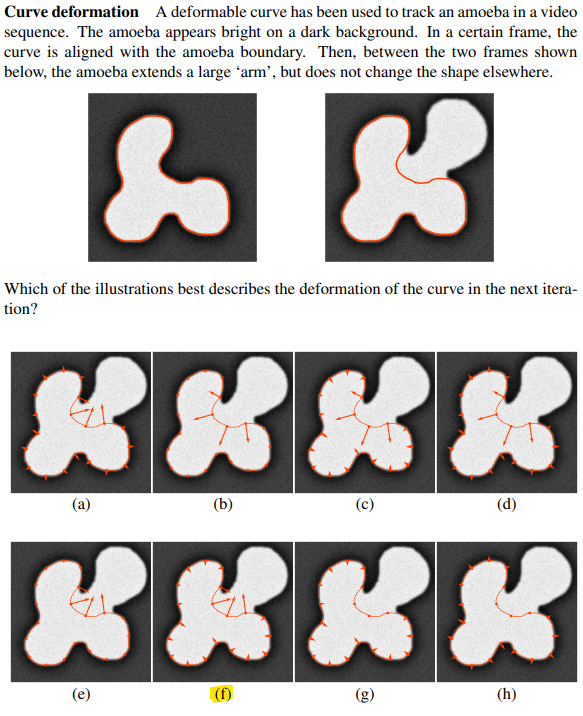

We consider expression for fext, in particular the part (I - 0.5(mean_in + mean_out)), 
since we know that the first part of fext positive. 

The points of the snake which are no longer at the boundary have large 
intensities I, so expression will be positive and those points 
will move outwards. 

The points which are at the boundary have intensities close to 
0.5(mean_amoeba + mean_background). However, the curve is not aligned with the
boundary of the amoeba. So while mean_in is equal to mean_amoeba, the value of
mean_out is larger than mean_background. Therefore, the value of 
(I - 0.5(mean_in + mean_out)) will be negative and points on the boundary of the 
amoeba will move (slightly) inwards.

(As snake aligns with the boundary of the amoeba, the mean_in and mean_out will
converge to the mean values of amoeba and background.)

 Correct answer is (f).

### Question 13) Segmentation cost


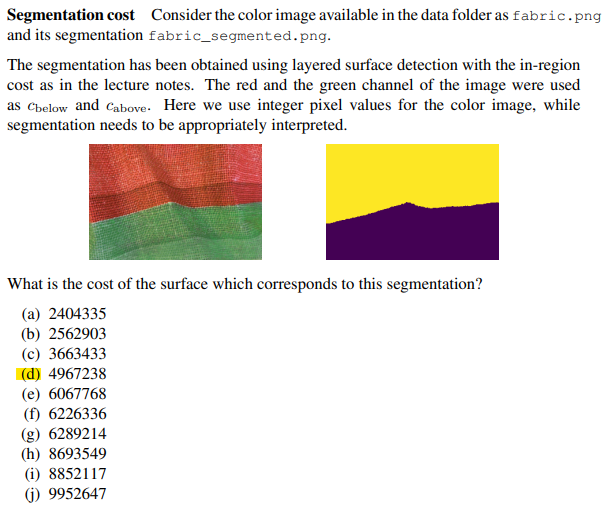

#### Solution

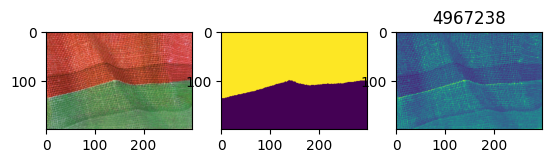

In [230]:
# QUESTION 13, Segmentation cost

# When interpreting the segmented image, if in doubt about which chanel was used 
# for above and which for below, notice that the segmented image has been obtained
# using this choice of costs function. So red channel is used for the red part of 
# the image and green channel for the green part of the image. Had the channels 
# been swapped, the segmentation would be different. (Explanation of the term
# 'below' and 'above' comes from the fact that image origin with height 0 is in 
# the top left corner.) 
I = skimage.io.imread('exam_data/exam2024/' + 'fabric/fabric.png')
S = skimage.io.imread('exam_data/exam2024/' + 'fabric/fabric_segmentation.png') > 0
pixelwise_cost = I[..., 0] * (~S) + I[..., 1] * S
fig, ax = plt.subplots(1, 3)
ax[0].imshow(I)
ax[1].imshow(S)
ax[2].imshow(pixelwise_cost)
ax[2].set_title(pixelwise_cost.sum())
plt.show()

### Question 14) Two-line detection

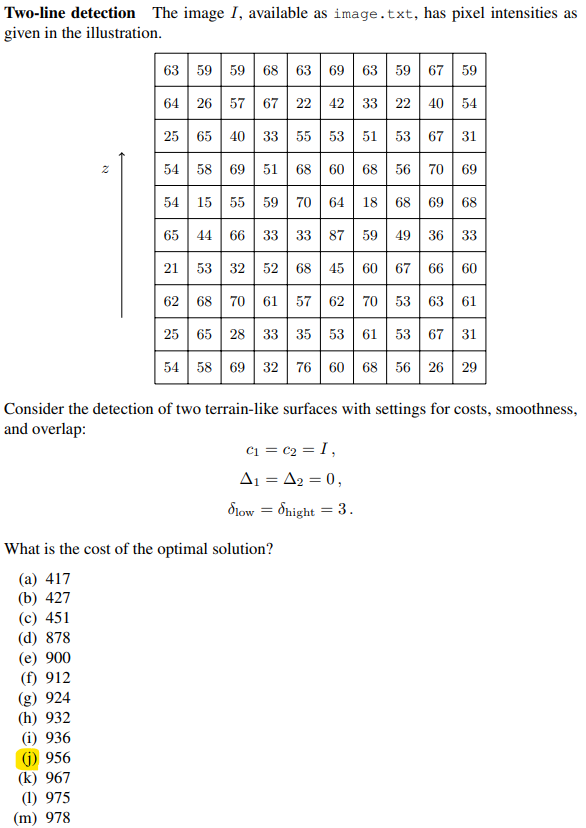

#### Mine

In [231]:
image = np.loadtxt('exam_data/exam2024/image/image.txt')
print(np.min(image), np.max(image)) 
print(image.dtype)
print(image.shape)

values = np.sum(image, axis=1)
print(values.shape)
print(values)

cost_list = []
for i in range(len(values)-3):
    print(values[i], values[i+3])
    cost = values[i] + values[i+3]
    cost_list.append(cost)

print('min cost:', np.min(cost_list))
    


15.0 87.0
float64
(10, 10)
(10,)
[629. 427. 473. 623. 540. 505. 524. 627. 451. 528.]
629.0 623.0
427.0 540.0
473.0 505.0
623.0 524.0
540.0 627.0
505.0 451.0
524.0 528.0
min cost: 956.0


#### Solution

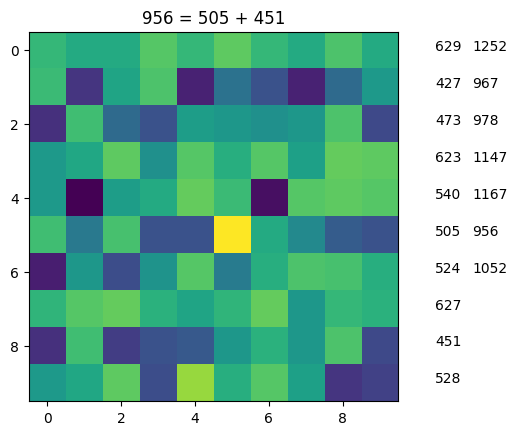

In [232]:
I = np.loadtxt('exam_data/exam2024/' + 'image/image.txt').astype(int)
s = I.sum(axis=1)
c = s[3:] + s[:-3]
plt.imshow(I)
for i in range(len(s)):
    plt.text(I.shape[1] + 0.5, i, s[i])
for i in range(len(c)):
    plt.text(I.shape[1] + 1.5, i, c[i])

k = np.argmin(c)

plt.title(f'{min(c)} = {s[k]} + {s[k+3]}')
plt.show()

### Question 15)

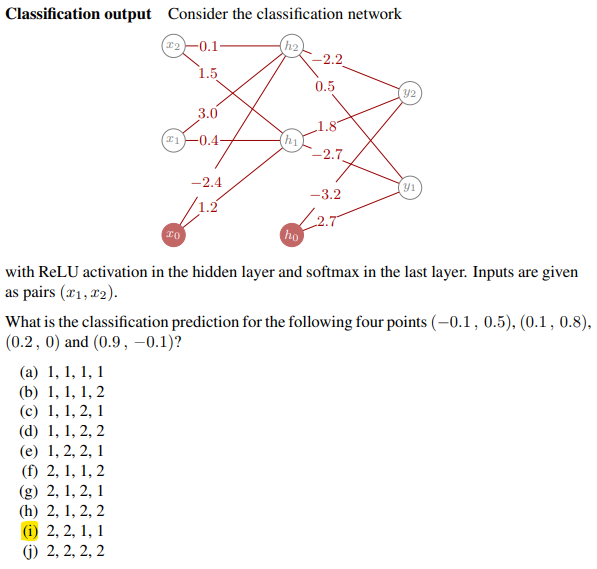

#### Mine

In [233]:
x1 = 0.9
x2 = -0.1

x0 = 1
h0 = 1

ReLU = lambda x: np.maximum(0, x)
softmax = lambda x: np.exp(x) / np.sum(np.exp(x), axis=0, keepdims=True)

h2 = ReLU(0.1*x2 + 3.0*x1 - 2.4*x0)
h1 = ReLU(1.5*x2 + 0.4*x1 + 1.2*x0)

y2 = (-2.2*h2 + 1.8*h1 - 3.2*h0)
y1 = (0.5*h2 + -2.7*h1 + 2.7*h0)

y_hat = np.array([y1, y2])
y = softmax(y_hat)

print(y)

[0.58370462 0.41629538]


#### Solution

In [234]:
X = np.array([[-0.1, 0.5], [0.1, 0.8], [0.2, 0], [0.9, -0.1]])
answer = []

for x in X:
    x2 = x[1]
    x1 = x[0]
    h2 = max(0.1 * x2 + 3 * x1 - 2.4, 0.0)
    h1 = max(1.5 * x2 + 0.4 * x1 + 1.2, 0.0)
    y2 = -2.2 * h2 + 1.8 * h1 - 3.2
    y1 = 0.5 * h2 - 2.7 * h1 + 2.7
    print()
    print(f'   x = {x1:0.2}, {x2:0.2} ')
    print(f'   h = {h1:0.2}, {h2:0.2} ')
    print(f'yhat = {y1:0.2}, {y2:0.2} ')
    print(f'   class {(y2>y1) + 1}')
    answer.append((y2>y1) + 1)

print()
print(answer)


   x = -0.1, 0.5 
   h = 1.9, 0.0 
yhat = -2.5, 0.24 
   class 2

   x = 0.1, 0.8 
   h = 2.4, 0.0 
yhat = -3.9, 1.2 
   class 2

   x = 0.2, 0.0 
   h = 1.3, 0.0 
yhat = -0.76, -0.9 
   class 1

   x = 0.9, -0.1 
   h = 1.4, 0.29 
yhat = -0.96, -1.3 
   class 1

[np.int64(2), np.int64(2), np.int64(1), np.int64(1)]


### Question 16) MLP backpropagation 

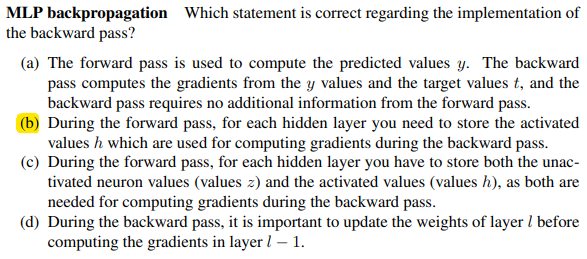

For computing gradients in the backward pass you need activated values so (a) is 
not correct. The derivative of activation may be obtained from the activated values
so (c) is not correct -- as explained on the page 72 of the course note. As for 
(d), weights are updated when for gradients computed from current values, so it 
is not correct. The correct answer is (b) 

### Question 17) Gradients 

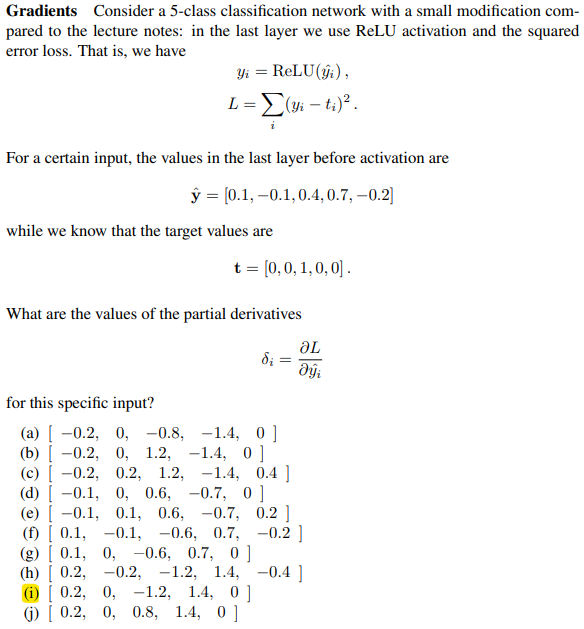

#### Mine

In [235]:
t =  np.array([0, 0, 1, 0, 0])[None, :]
y_hat = np.array([0.1, -0.1, 0.4, 0.7, -0.2])[None, :]
y = np.maximum(0, y_hat)
dy_dy_hat = y > 0
print('t', t)
print('y_hat', y_hat)
print('y', y)   

loss = 2*(y - t)*dy_dy_hat
print('loss', loss)

t [[0 0 1 0 0]]
y_hat [[ 0.1 -0.1  0.4  0.7 -0.2]]
y [[0.1 0.  0.4 0.7 0. ]]
loss [[ 0.2  0.  -1.2  1.4  0. ]]


#### Solution

In [236]:
''' Every y_i is only depending on yhat_i. Therefore, the chain rule gives:
 delta_i = partial L / partial y_i  * partial y_i / partial yhat_i. The
 first part is derivative of quadratic function, so 2 * (y_i - t_i). The second 
 part is derivative or ReLU, which is either 0 or 1, depending on whether the
 neuron was activated.
'''

yhat = np.array([0.1 , -0.1, 0.4, 0.7, -0.2])
y = np.maximum(yhat, 0)
t = np.array([0 , 0, 1, 0, 0])
delta = 2 * (y - t) * (y > 0)
print(delta)

[ 0.2  0.  -1.2  1.4  0. ]


### Question 18) Minibatches

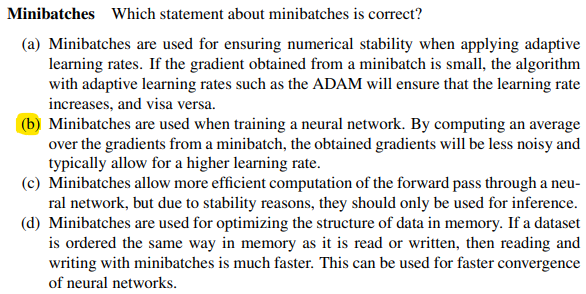

Minibatches are not related to adaptive learning rate, memory considerations, 
inferrence. Minibatches are used in training to obtain averaged (smoothed) gradients. 
Correct anwer is (b)

### Question 19) Network output

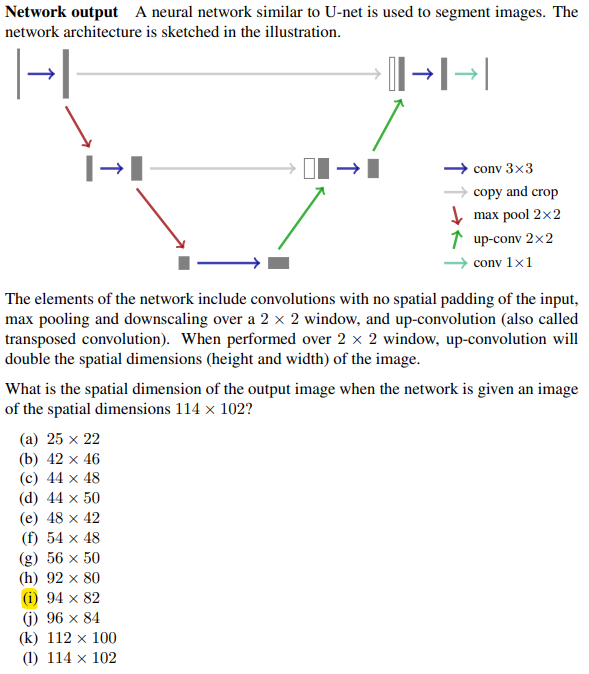

#### Mine

In [237]:
input_image = np.array([114, 102])
conv1 = (input_image - 2)/2
conv2 = (conv1 - 2)/2
conv3 = (conv2 - 2)
up1 = conv3*2 - 2
up2 = up1*2 - 2

print(up2)

[94. 82.]


#### Solution

In [238]:
dims = np.array([114, 102])
down1 = (dims - 2)//2
down2 = (down1 - 2)//2
bottom = (down2 - 2)
up1 = 2 * bottom - 2
up2 = 2 * up1 - 2
print(up2)


[94 82]


### Question 20) Learnable parameters

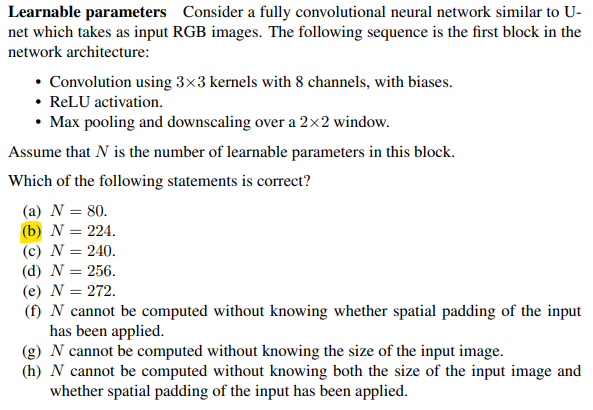

#### Mine

In [239]:
N = (3*3*3 + 1)*8
print(N)

224


Network takes RGB images so there are 3 input channels and therefore
the parameters of convolution are 3 * 3 * 3 * 8 + 8, the last 8 being biases. 
Max pooling and ReLU have no learnable parameters. So correct answer is 224.